# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [2]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [3]:
!mkdir data

サブディレクトリまたはファイル data は既に存在します。


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [4]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [5]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

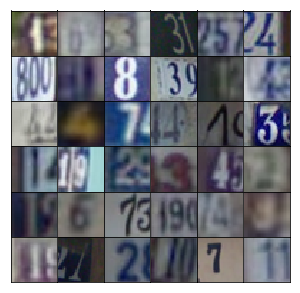

In [6]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [7]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [8]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [9]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [11]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        
        ##################################################
        # Fully connected layer unit: z shape to 4x4x512
        ##################################################
        # First fully connected layer
        x1 = tf.layers.dense(z, units=512*4*4, activation=None)
        # reshape into deep and narrow　shape (4x4x1024)
        x1 = tf.reshape(x1, shape=(-1, 4, 4, 512))
        # batch norm
        x1 = tf.layers.batch_normalization(x1, training=training)
        # Leaky ReLU activation
        x1 = tf.maximum(alpha * x1, x1)
        
        ##################################################
        # Transpose CONV unit: 4x4x512 to 8x8x256
        ##################################################
        x2 = tf.layers.conv2d_transpose(x1, 256, kernel_size=5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        # Leaky ReLu
        x2 = tf.maximum(alpha * x2, x2)
        
        ##################################################
        # Transpose CONV unit: 8x8x256 to 16x16x128
        ##################################################
        x3 = tf.layers.conv2d_transpose(x2, 128, kernel_size=5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        # Leaky ReLu
        x3 = tf.maximum(alpha * x3, x3)
        
        ##################################################
        # Output layer: 16*16*128 to 32*32*3
        ##################################################
        logits = tf.layers.conv2d_transpose(x3, output_dim, kernel_size=5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [12]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        
        ##################################################
        # CONV unit 1: 32x32x3 to 16x16x64
        ##################################################
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        # leaky Relu
        x1 = tf.maximum(alpha * x1, x1)
        
        ##################################################
        # CONV unit 2: 16x16x64 to 8x8x128
        ##################################################
        x2 = tf.layers.conv2d(x1, 128, 5, strides=2, padding='same')
        # batch normalization
        x2 = tf.layers.batch_normalization(x2, training=True)
        # leaky Relu
        x2 = tf.maximum(alpha * x2, x2)
        
        ##################################################
        # CONV unit 3: 8x8x128 to 4x4x256
        ##################################################
        x3 = tf.layers.conv2d(x2, 256, 5, strides=2, padding='same')
        # batch normalization
        x3 = tf.layers.batch_normalization(x3, training=True)
        # leaky Relu
        x3 = tf.maximum(alpha * x3, x3)
        
        ##################################################
        # Output layer
        ##################################################
        flat = tf.layers.flatten(x3)
        logits = tf.layers.dense(flat, 1, activation=None)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [13]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [14]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [15]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [16]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [17]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [20]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 0.9719... Generator Loss: 0.9924
Epoch 1/25... Discriminator Loss: 0.4101... Generator Loss: 1.5061
Epoch 1/25... Discriminator Loss: 0.1875... Generator Loss: 2.2857
Epoch 1/25... Discriminator Loss: 0.1333... Generator Loss: 2.7767
Epoch 1/25... Discriminator Loss: 0.1162... Generator Loss: 2.9798
Epoch 1/25... Discriminator Loss: 0.0641... Generator Loss: 3.3886
Epoch 1/25... Discriminator Loss: 0.1170... Generator Loss: 2.9564
Epoch 1/25... Discriminator Loss: 0.1114... Generator Loss: 3.4536
Epoch 1/25... Discriminator Loss: 0.1324... Generator Loss: 4.0537
Epoch 1/25... Discriminator Loss: 0.0916... Generator Loss: 3.6723


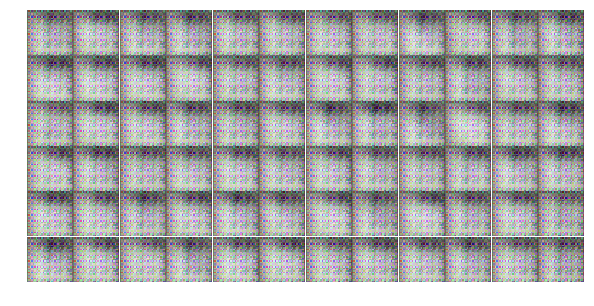

Epoch 1/25... Discriminator Loss: 0.1156... Generator Loss: 3.3670
Epoch 1/25... Discriminator Loss: 0.3601... Generator Loss: 2.5604
Epoch 1/25... Discriminator Loss: 0.5167... Generator Loss: 1.8729
Epoch 1/25... Discriminator Loss: 0.6470... Generator Loss: 1.0650
Epoch 1/25... Discriminator Loss: 0.5666... Generator Loss: 1.6598
Epoch 1/25... Discriminator Loss: 0.7055... Generator Loss: 1.0975
Epoch 1/25... Discriminator Loss: 0.2479... Generator Loss: 2.1732
Epoch 1/25... Discriminator Loss: 0.6886... Generator Loss: 1.1366
Epoch 1/25... Discriminator Loss: 0.6137... Generator Loss: 2.1645
Epoch 1/25... Discriminator Loss: 0.5346... Generator Loss: 2.9698


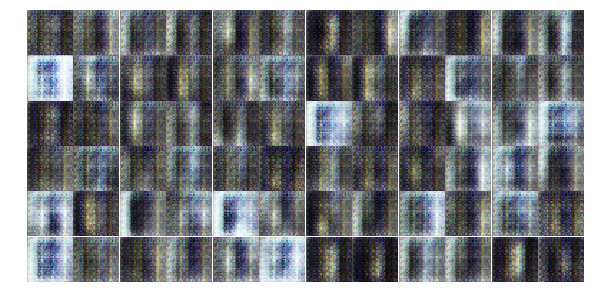

Epoch 1/25... Discriminator Loss: 0.2441... Generator Loss: 2.3994
Epoch 1/25... Discriminator Loss: 0.8003... Generator Loss: 3.9101
Epoch 1/25... Discriminator Loss: 0.6156... Generator Loss: 1.2709
Epoch 1/25... Discriminator Loss: 0.9168... Generator Loss: 0.8513
Epoch 1/25... Discriminator Loss: 1.2457... Generator Loss: 3.0074
Epoch 1/25... Discriminator Loss: 0.8766... Generator Loss: 3.8051
Epoch 1/25... Discriminator Loss: 0.4316... Generator Loss: 1.5919
Epoch 1/25... Discriminator Loss: 0.3458... Generator Loss: 2.1471
Epoch 1/25... Discriminator Loss: 0.9465... Generator Loss: 0.9319
Epoch 1/25... Discriminator Loss: 0.6391... Generator Loss: 2.0178


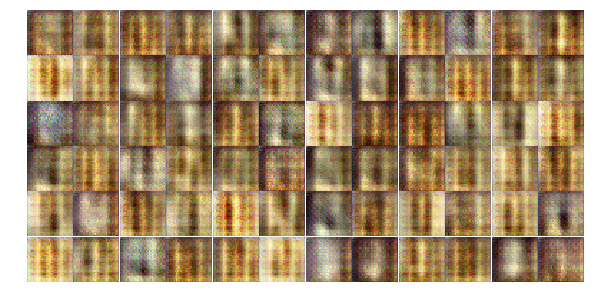

Epoch 1/25... Discriminator Loss: 0.4988... Generator Loss: 1.7072
Epoch 1/25... Discriminator Loss: 0.5136... Generator Loss: 2.4270
Epoch 1/25... Discriminator Loss: 0.9210... Generator Loss: 0.8088
Epoch 1/25... Discriminator Loss: 1.1185... Generator Loss: 0.9316
Epoch 1/25... Discriminator Loss: 0.5652... Generator Loss: 1.4719
Epoch 1/25... Discriminator Loss: 0.7183... Generator Loss: 0.9943
Epoch 1/25... Discriminator Loss: 0.9395... Generator Loss: 0.9300
Epoch 1/25... Discriminator Loss: 0.4535... Generator Loss: 2.0875
Epoch 1/25... Discriminator Loss: 0.4751... Generator Loss: 1.7976
Epoch 1/25... Discriminator Loss: 0.8284... Generator Loss: 1.6738


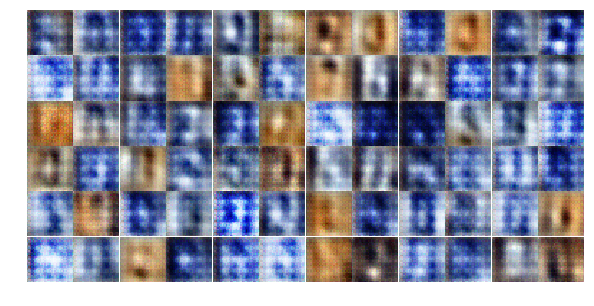

Epoch 1/25... Discriminator Loss: 0.7185... Generator Loss: 1.1454
Epoch 1/25... Discriminator Loss: 0.5133... Generator Loss: 1.6130
Epoch 1/25... Discriminator Loss: 0.4951... Generator Loss: 1.5428
Epoch 1/25... Discriminator Loss: 0.3559... Generator Loss: 2.5242
Epoch 1/25... Discriminator Loss: 0.9007... Generator Loss: 2.0653
Epoch 1/25... Discriminator Loss: 0.9457... Generator Loss: 0.7758
Epoch 1/25... Discriminator Loss: 0.8519... Generator Loss: 1.2495
Epoch 1/25... Discriminator Loss: 0.8014... Generator Loss: 1.2837
Epoch 1/25... Discriminator Loss: 0.8468... Generator Loss: 1.8450
Epoch 1/25... Discriminator Loss: 0.9865... Generator Loss: 1.0989


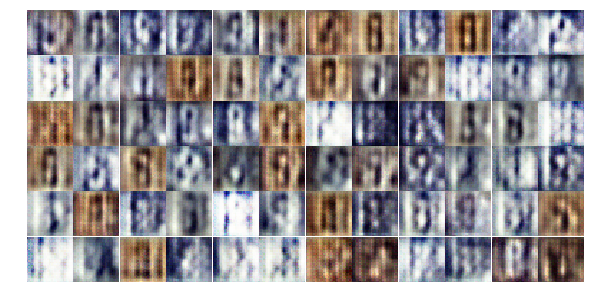

Epoch 1/25... Discriminator Loss: 0.6182... Generator Loss: 1.4452
Epoch 1/25... Discriminator Loss: 0.5366... Generator Loss: 1.7586
Epoch 1/25... Discriminator Loss: 0.8703... Generator Loss: 1.1050
Epoch 1/25... Discriminator Loss: 0.9895... Generator Loss: 0.7632
Epoch 1/25... Discriminator Loss: 0.8238... Generator Loss: 1.3570
Epoch 1/25... Discriminator Loss: 0.5978... Generator Loss: 1.1531
Epoch 1/25... Discriminator Loss: 0.5529... Generator Loss: 1.7057
Epoch 2/25... Discriminator Loss: 0.9070... Generator Loss: 1.5096
Epoch 2/25... Discriminator Loss: 0.7561... Generator Loss: 2.4048
Epoch 2/25... Discriminator Loss: 0.6514... Generator Loss: 1.4566


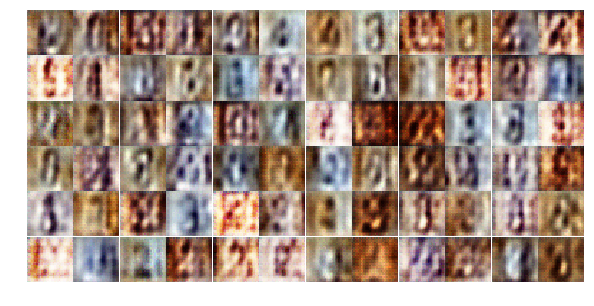

Epoch 2/25... Discriminator Loss: 0.5872... Generator Loss: 1.5125
Epoch 2/25... Discriminator Loss: 0.7608... Generator Loss: 1.3964
Epoch 2/25... Discriminator Loss: 0.8123... Generator Loss: 1.1462
Epoch 2/25... Discriminator Loss: 0.9364... Generator Loss: 1.3308
Epoch 2/25... Discriminator Loss: 0.9814... Generator Loss: 1.0097
Epoch 2/25... Discriminator Loss: 0.7565... Generator Loss: 1.0588
Epoch 2/25... Discriminator Loss: 0.8535... Generator Loss: 1.4544
Epoch 2/25... Discriminator Loss: 0.6880... Generator Loss: 1.3220
Epoch 2/25... Discriminator Loss: 0.8751... Generator Loss: 0.7865
Epoch 2/25... Discriminator Loss: 0.7971... Generator Loss: 1.1959


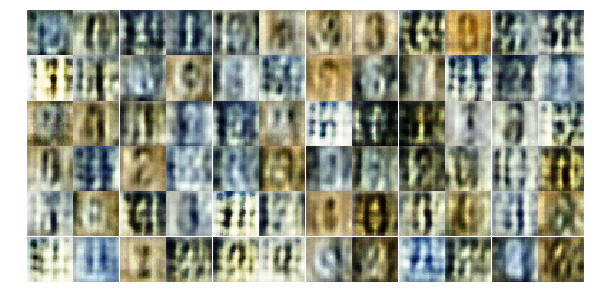

Epoch 2/25... Discriminator Loss: 1.1540... Generator Loss: 0.8193
Epoch 2/25... Discriminator Loss: 1.1823... Generator Loss: 1.0463
Epoch 2/25... Discriminator Loss: 0.9444... Generator Loss: 0.8548
Epoch 2/25... Discriminator Loss: 0.8129... Generator Loss: 1.0954
Epoch 2/25... Discriminator Loss: 1.0173... Generator Loss: 1.2780
Epoch 2/25... Discriminator Loss: 1.2635... Generator Loss: 0.8838
Epoch 2/25... Discriminator Loss: 1.2531... Generator Loss: 0.8322
Epoch 2/25... Discriminator Loss: 1.1260... Generator Loss: 0.7131
Epoch 2/25... Discriminator Loss: 1.0400... Generator Loss: 0.9775
Epoch 2/25... Discriminator Loss: 1.3229... Generator Loss: 0.5903


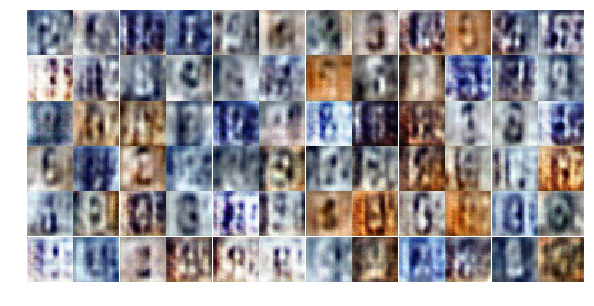

Epoch 2/25... Discriminator Loss: 0.9614... Generator Loss: 0.9455
Epoch 2/25... Discriminator Loss: 0.7574... Generator Loss: 1.2203
Epoch 2/25... Discriminator Loss: 1.1922... Generator Loss: 1.0373
Epoch 2/25... Discriminator Loss: 0.8379... Generator Loss: 1.3296
Epoch 2/25... Discriminator Loss: 1.0118... Generator Loss: 0.8622
Epoch 2/25... Discriminator Loss: 1.1820... Generator Loss: 0.7417
Epoch 2/25... Discriminator Loss: 1.1177... Generator Loss: 0.6916
Epoch 2/25... Discriminator Loss: 0.9993... Generator Loss: 0.9136
Epoch 2/25... Discriminator Loss: 1.0800... Generator Loss: 0.9163
Epoch 2/25... Discriminator Loss: 1.2374... Generator Loss: 0.8344


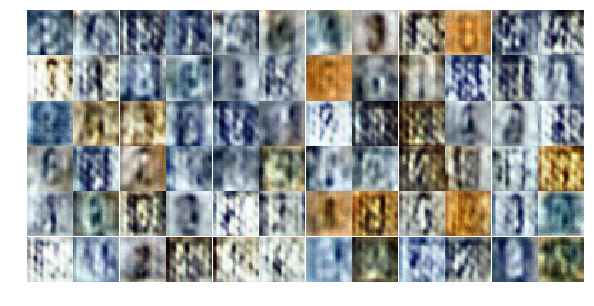

Epoch 2/25... Discriminator Loss: 1.0937... Generator Loss: 1.0147
Epoch 2/25... Discriminator Loss: 1.3231... Generator Loss: 0.7274
Epoch 2/25... Discriminator Loss: 1.2261... Generator Loss: 0.6800
Epoch 2/25... Discriminator Loss: 1.6067... Generator Loss: 0.4986
Epoch 2/25... Discriminator Loss: 0.8112... Generator Loss: 1.1553
Epoch 2/25... Discriminator Loss: 0.7647... Generator Loss: 1.3561
Epoch 2/25... Discriminator Loss: 1.1548... Generator Loss: 1.0882
Epoch 2/25... Discriminator Loss: 1.0563... Generator Loss: 1.1390
Epoch 2/25... Discriminator Loss: 0.9825... Generator Loss: 1.1309
Epoch 2/25... Discriminator Loss: 1.3673... Generator Loss: 0.8130


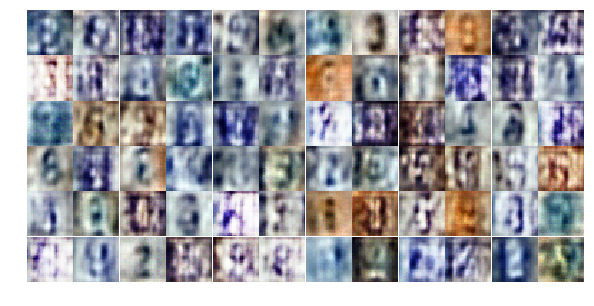

Epoch 2/25... Discriminator Loss: 1.0863... Generator Loss: 1.2732
Epoch 2/25... Discriminator Loss: 1.0586... Generator Loss: 1.4760
Epoch 2/25... Discriminator Loss: 0.9679... Generator Loss: 0.8722
Epoch 2/25... Discriminator Loss: 1.0135... Generator Loss: 0.9662
Epoch 2/25... Discriminator Loss: 1.1612... Generator Loss: 0.8207
Epoch 2/25... Discriminator Loss: 1.1762... Generator Loss: 0.7140
Epoch 2/25... Discriminator Loss: 1.0070... Generator Loss: 1.3046
Epoch 2/25... Discriminator Loss: 1.1820... Generator Loss: 1.0675
Epoch 2/25... Discriminator Loss: 0.9073... Generator Loss: 1.2512
Epoch 2/25... Discriminator Loss: 0.9186... Generator Loss: 1.2690


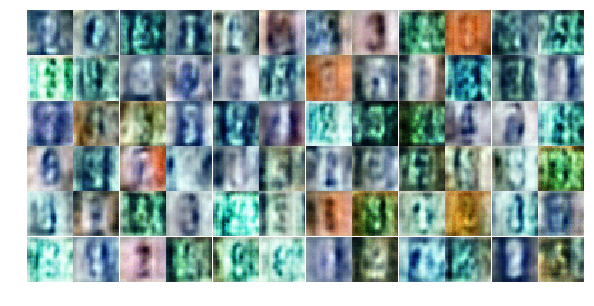

Epoch 2/25... Discriminator Loss: 1.1851... Generator Loss: 0.9523
Epoch 2/25... Discriminator Loss: 1.0099... Generator Loss: 1.4139
Epoch 2/25... Discriminator Loss: 1.4693... Generator Loss: 0.4575
Epoch 2/25... Discriminator Loss: 1.0726... Generator Loss: 0.8567
Epoch 3/25... Discriminator Loss: 0.9133... Generator Loss: 1.4297
Epoch 3/25... Discriminator Loss: 1.3330... Generator Loss: 0.7431
Epoch 3/25... Discriminator Loss: 1.0657... Generator Loss: 1.0362
Epoch 3/25... Discriminator Loss: 1.1189... Generator Loss: 0.6814
Epoch 3/25... Discriminator Loss: 0.7879... Generator Loss: 1.2250
Epoch 3/25... Discriminator Loss: 1.2969... Generator Loss: 0.6798


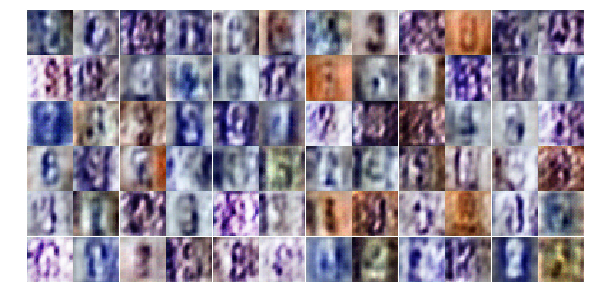

Epoch 3/25... Discriminator Loss: 0.8994... Generator Loss: 0.8191
Epoch 3/25... Discriminator Loss: 0.8349... Generator Loss: 1.0286
Epoch 3/25... Discriminator Loss: 0.7778... Generator Loss: 0.9758
Epoch 3/25... Discriminator Loss: 0.7328... Generator Loss: 1.4602
Epoch 3/25... Discriminator Loss: 0.4905... Generator Loss: 1.6687
Epoch 3/25... Discriminator Loss: 2.0853... Generator Loss: 0.1951
Epoch 3/25... Discriminator Loss: 1.0434... Generator Loss: 1.2685
Epoch 3/25... Discriminator Loss: 0.7405... Generator Loss: 1.2098
Epoch 3/25... Discriminator Loss: 1.0636... Generator Loss: 0.7168
Epoch 3/25... Discriminator Loss: 0.7945... Generator Loss: 1.4286


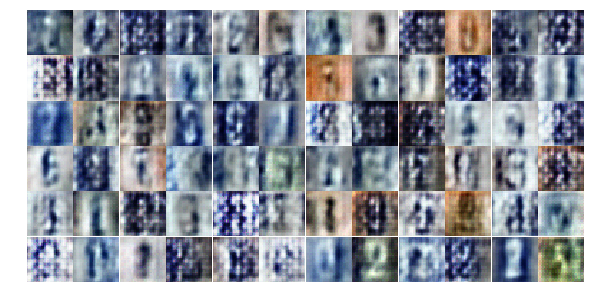

Epoch 3/25... Discriminator Loss: 0.8777... Generator Loss: 1.3612
Epoch 3/25... Discriminator Loss: 0.8629... Generator Loss: 0.8106
Epoch 3/25... Discriminator Loss: 0.6409... Generator Loss: 1.7287
Epoch 3/25... Discriminator Loss: 0.7604... Generator Loss: 1.3144
Epoch 3/25... Discriminator Loss: 1.6721... Generator Loss: 0.3226
Epoch 3/25... Discriminator Loss: 0.6791... Generator Loss: 1.4686
Epoch 3/25... Discriminator Loss: 0.6089... Generator Loss: 2.2152
Epoch 3/25... Discriminator Loss: 0.5583... Generator Loss: 1.6104
Epoch 3/25... Discriminator Loss: 0.7917... Generator Loss: 1.0118
Epoch 3/25... Discriminator Loss: 1.2283... Generator Loss: 0.7059


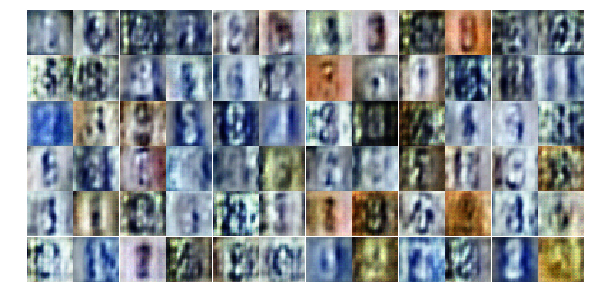

Epoch 3/25... Discriminator Loss: 0.8199... Generator Loss: 1.2988
Epoch 3/25... Discriminator Loss: 0.9476... Generator Loss: 2.3624
Epoch 3/25... Discriminator Loss: 0.7537... Generator Loss: 1.7608
Epoch 3/25... Discriminator Loss: 0.7708... Generator Loss: 0.9081
Epoch 3/25... Discriminator Loss: 0.8132... Generator Loss: 1.0314
Epoch 3/25... Discriminator Loss: 0.6183... Generator Loss: 1.3629
Epoch 3/25... Discriminator Loss: 0.5784... Generator Loss: 1.8828
Epoch 3/25... Discriminator Loss: 0.9162... Generator Loss: 0.9177
Epoch 3/25... Discriminator Loss: 0.5310... Generator Loss: 1.6360
Epoch 3/25... Discriminator Loss: 1.1575... Generator Loss: 2.5967


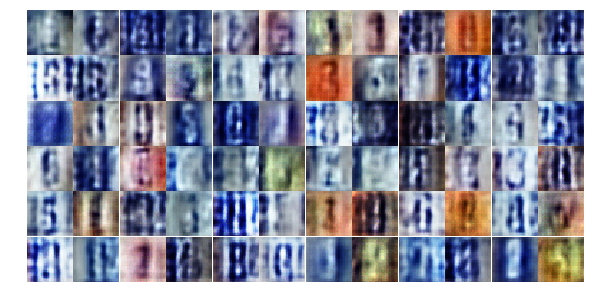

Epoch 3/25... Discriminator Loss: 1.5680... Generator Loss: 2.7207
Epoch 3/25... Discriminator Loss: 0.4561... Generator Loss: 2.6205
Epoch 3/25... Discriminator Loss: 0.8690... Generator Loss: 1.0050
Epoch 3/25... Discriminator Loss: 1.2217... Generator Loss: 0.4905
Epoch 3/25... Discriminator Loss: 0.4774... Generator Loss: 1.4841
Epoch 3/25... Discriminator Loss: 1.0262... Generator Loss: 0.6330
Epoch 3/25... Discriminator Loss: 1.0491... Generator Loss: 1.8348
Epoch 3/25... Discriminator Loss: 1.1687... Generator Loss: 0.5662
Epoch 3/25... Discriminator Loss: 1.6062... Generator Loss: 0.4165
Epoch 3/25... Discriminator Loss: 1.2831... Generator Loss: 0.6237


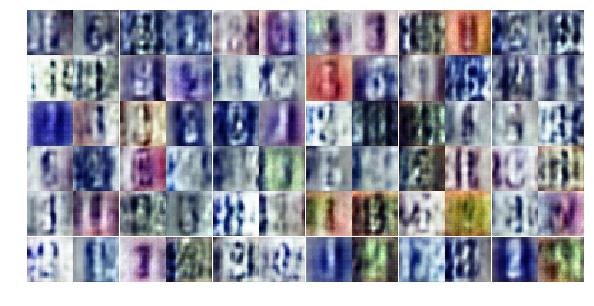

Epoch 3/25... Discriminator Loss: 1.2502... Generator Loss: 0.6809
Epoch 3/25... Discriminator Loss: 1.4117... Generator Loss: 0.4125
Epoch 3/25... Discriminator Loss: 1.0436... Generator Loss: 0.7837
Epoch 3/25... Discriminator Loss: 0.8682... Generator Loss: 1.3464
Epoch 3/25... Discriminator Loss: 0.8149... Generator Loss: 1.8765
Epoch 3/25... Discriminator Loss: 0.4084... Generator Loss: 2.2773
Epoch 3/25... Discriminator Loss: 0.6359... Generator Loss: 1.8695
Epoch 3/25... Discriminator Loss: 0.3390... Generator Loss: 2.1749
Epoch 3/25... Discriminator Loss: 0.4502... Generator Loss: 2.0203
Epoch 3/25... Discriminator Loss: 0.8065... Generator Loss: 0.9383


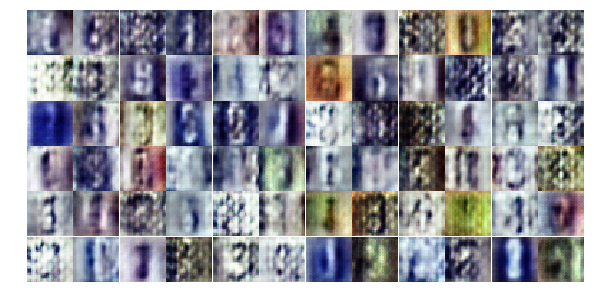

Epoch 3/25... Discriminator Loss: 1.1394... Generator Loss: 0.6304
Epoch 4/25... Discriminator Loss: 1.0024... Generator Loss: 0.6903
Epoch 4/25... Discriminator Loss: 0.9481... Generator Loss: 0.8540
Epoch 4/25... Discriminator Loss: 0.8289... Generator Loss: 0.8205
Epoch 4/25... Discriminator Loss: 0.4755... Generator Loss: 1.5262
Epoch 4/25... Discriminator Loss: 0.4883... Generator Loss: 1.5533
Epoch 4/25... Discriminator Loss: 0.4587... Generator Loss: 1.4978
Epoch 4/25... Discriminator Loss: 0.9601... Generator Loss: 0.7167
Epoch 4/25... Discriminator Loss: 0.6251... Generator Loss: 2.2999
Epoch 4/25... Discriminator Loss: 0.6131... Generator Loss: 1.3093


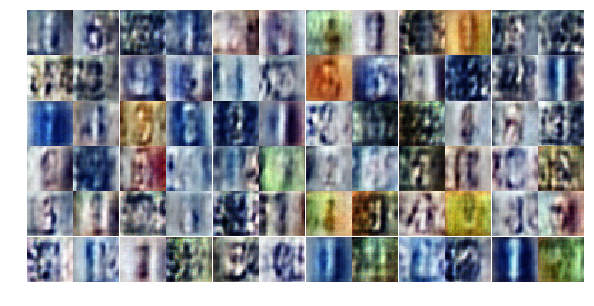

Epoch 4/25... Discriminator Loss: 0.4614... Generator Loss: 1.4792
Epoch 4/25... Discriminator Loss: 0.4733... Generator Loss: 1.6859
Epoch 4/25... Discriminator Loss: 1.3165... Generator Loss: 1.1063
Epoch 4/25... Discriminator Loss: 0.8889... Generator Loss: 2.0780
Epoch 4/25... Discriminator Loss: 0.6821... Generator Loss: 1.3309
Epoch 4/25... Discriminator Loss: 0.9640... Generator Loss: 0.8571
Epoch 4/25... Discriminator Loss: 1.0635... Generator Loss: 0.6235
Epoch 4/25... Discriminator Loss: 0.5137... Generator Loss: 1.8232
Epoch 4/25... Discriminator Loss: 0.7944... Generator Loss: 1.1078
Epoch 4/25... Discriminator Loss: 0.6388... Generator Loss: 1.7549


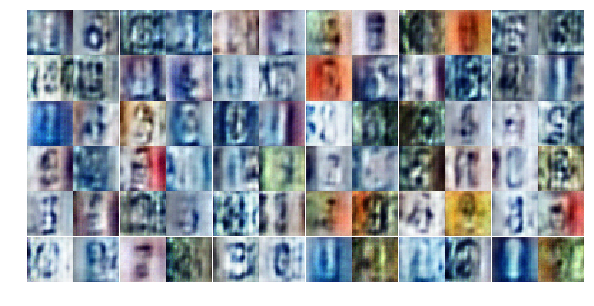

Epoch 4/25... Discriminator Loss: 1.2034... Generator Loss: 0.5535
Epoch 4/25... Discriminator Loss: 0.4794... Generator Loss: 1.5056
Epoch 4/25... Discriminator Loss: 0.7854... Generator Loss: 0.9988
Epoch 4/25... Discriminator Loss: 1.2030... Generator Loss: 2.3898
Epoch 4/25... Discriminator Loss: 0.6265... Generator Loss: 1.4368
Epoch 4/25... Discriminator Loss: 0.6682... Generator Loss: 2.4835
Epoch 4/25... Discriminator Loss: 0.8288... Generator Loss: 0.7337
Epoch 4/25... Discriminator Loss: 0.9360... Generator Loss: 1.5023
Epoch 4/25... Discriminator Loss: 0.3644... Generator Loss: 2.8935
Epoch 4/25... Discriminator Loss: 0.9949... Generator Loss: 1.0055


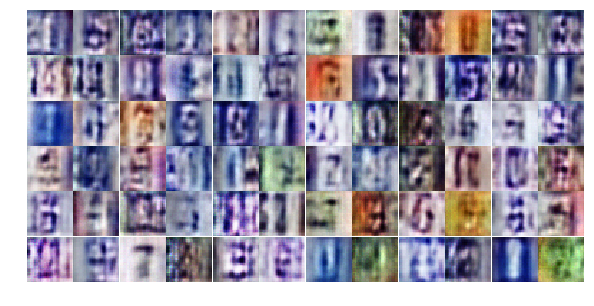

Epoch 4/25... Discriminator Loss: 0.5507... Generator Loss: 1.6343
Epoch 4/25... Discriminator Loss: 0.8066... Generator Loss: 1.4545
Epoch 4/25... Discriminator Loss: 0.4785... Generator Loss: 1.7328
Epoch 4/25... Discriminator Loss: 0.6134... Generator Loss: 2.2434
Epoch 4/25... Discriminator Loss: 0.5101... Generator Loss: 1.5656
Epoch 4/25... Discriminator Loss: 0.6983... Generator Loss: 1.0981
Epoch 4/25... Discriminator Loss: 0.9888... Generator Loss: 2.9460
Epoch 4/25... Discriminator Loss: 0.6736... Generator Loss: 1.1383
Epoch 4/25... Discriminator Loss: 0.9120... Generator Loss: 0.6455
Epoch 4/25... Discriminator Loss: 0.8190... Generator Loss: 1.0482


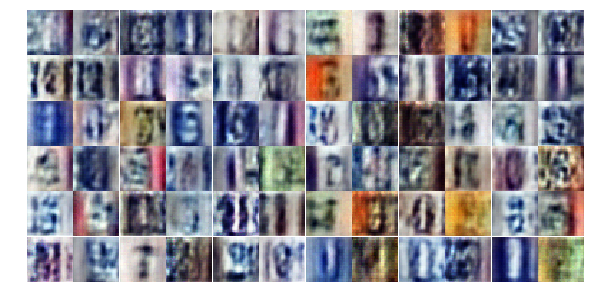

Epoch 4/25... Discriminator Loss: 0.7208... Generator Loss: 1.4420
Epoch 4/25... Discriminator Loss: 0.9367... Generator Loss: 2.3799
Epoch 4/25... Discriminator Loss: 0.8968... Generator Loss: 0.9853
Epoch 4/25... Discriminator Loss: 0.5246... Generator Loss: 1.5726
Epoch 4/25... Discriminator Loss: 0.4151... Generator Loss: 2.2972
Epoch 4/25... Discriminator Loss: 0.5711... Generator Loss: 1.3397
Epoch 4/25... Discriminator Loss: 0.8268... Generator Loss: 0.8484
Epoch 4/25... Discriminator Loss: 0.8402... Generator Loss: 3.2114
Epoch 4/25... Discriminator Loss: 0.5413... Generator Loss: 1.7179
Epoch 4/25... Discriminator Loss: 0.8318... Generator Loss: 1.0184


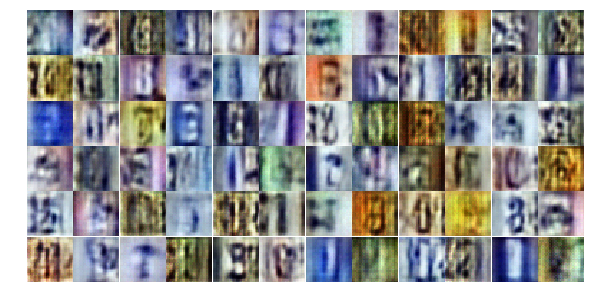

Epoch 4/25... Discriminator Loss: 0.3636... Generator Loss: 1.6666
Epoch 4/25... Discriminator Loss: 0.8134... Generator Loss: 1.7527
Epoch 4/25... Discriminator Loss: 0.3687... Generator Loss: 2.5489
Epoch 4/25... Discriminator Loss: 0.7610... Generator Loss: 1.2935
Epoch 4/25... Discriminator Loss: 0.8124... Generator Loss: 0.8596
Epoch 4/25... Discriminator Loss: 0.8244... Generator Loss: 2.2726
Epoch 4/25... Discriminator Loss: 1.1483... Generator Loss: 0.5119
Epoch 4/25... Discriminator Loss: 0.7526... Generator Loss: 1.9225
Epoch 4/25... Discriminator Loss: 0.6722... Generator Loss: 1.3745
Epoch 5/25... Discriminator Loss: 0.5972... Generator Loss: 1.1880


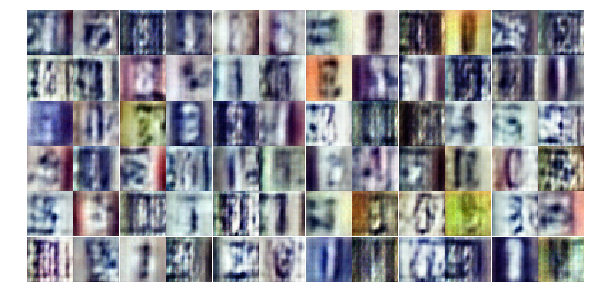

Epoch 5/25... Discriminator Loss: 0.5678... Generator Loss: 1.4361
Epoch 5/25... Discriminator Loss: 0.3153... Generator Loss: 2.4002
Epoch 5/25... Discriminator Loss: 0.7931... Generator Loss: 0.8426
Epoch 5/25... Discriminator Loss: 0.4888... Generator Loss: 1.2599
Epoch 5/25... Discriminator Loss: 0.4806... Generator Loss: 3.0231
Epoch 5/25... Discriminator Loss: 0.4228... Generator Loss: 1.5819
Epoch 5/25... Discriminator Loss: 0.5533... Generator Loss: 1.5550
Epoch 5/25... Discriminator Loss: 0.4818... Generator Loss: 1.3143
Epoch 5/25... Discriminator Loss: 0.6353... Generator Loss: 1.4996
Epoch 5/25... Discriminator Loss: 0.8116... Generator Loss: 0.7721


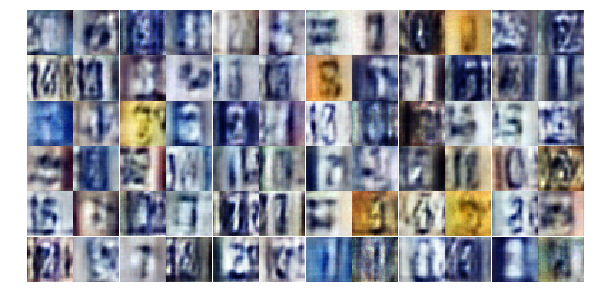

Epoch 5/25... Discriminator Loss: 0.5865... Generator Loss: 1.1634
Epoch 5/25... Discriminator Loss: 0.8173... Generator Loss: 2.9929
Epoch 5/25... Discriminator Loss: 0.7103... Generator Loss: 3.0442
Epoch 5/25... Discriminator Loss: 1.5104... Generator Loss: 0.4022
Epoch 5/25... Discriminator Loss: 0.4842... Generator Loss: 2.8629
Epoch 5/25... Discriminator Loss: 0.4520... Generator Loss: 1.6543
Epoch 5/25... Discriminator Loss: 0.6148... Generator Loss: 1.1813
Epoch 5/25... Discriminator Loss: 0.4906... Generator Loss: 1.4414
Epoch 5/25... Discriminator Loss: 0.5040... Generator Loss: 1.5946
Epoch 5/25... Discriminator Loss: 0.3853... Generator Loss: 1.7749


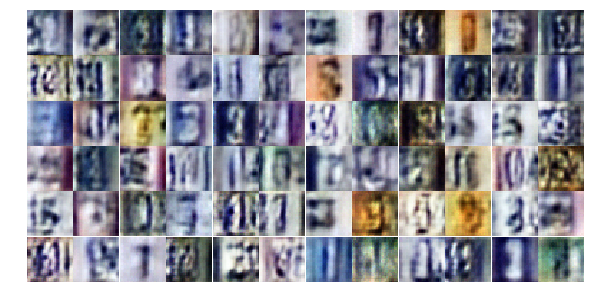

Epoch 5/25... Discriminator Loss: 0.6118... Generator Loss: 1.1191
Epoch 5/25... Discriminator Loss: 0.9509... Generator Loss: 0.6678
Epoch 5/25... Discriminator Loss: 0.4546... Generator Loss: 1.8110
Epoch 5/25... Discriminator Loss: 0.5512... Generator Loss: 1.4720
Epoch 5/25... Discriminator Loss: 1.3026... Generator Loss: 0.4331
Epoch 5/25... Discriminator Loss: 0.8941... Generator Loss: 0.7620
Epoch 5/25... Discriminator Loss: 0.6578... Generator Loss: 0.9635
Epoch 5/25... Discriminator Loss: 0.4994... Generator Loss: 1.5863
Epoch 5/25... Discriminator Loss: 1.3519... Generator Loss: 2.8536
Epoch 5/25... Discriminator Loss: 0.4470... Generator Loss: 1.8945


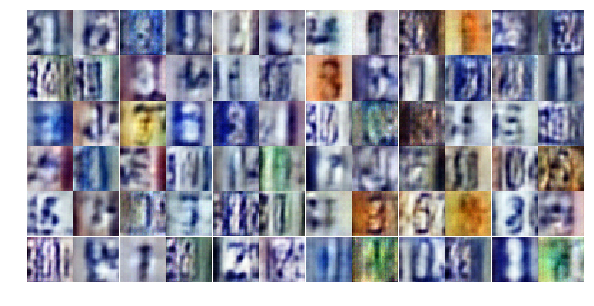

Epoch 5/25... Discriminator Loss: 0.4099... Generator Loss: 1.9133
Epoch 5/25... Discriminator Loss: 0.5703... Generator Loss: 1.3173
Epoch 5/25... Discriminator Loss: 0.4156... Generator Loss: 1.8360
Epoch 5/25... Discriminator Loss: 0.5320... Generator Loss: 1.2435
Epoch 5/25... Discriminator Loss: 0.5122... Generator Loss: 1.5918
Epoch 5/25... Discriminator Loss: 0.8429... Generator Loss: 1.3925
Epoch 5/25... Discriminator Loss: 0.7149... Generator Loss: 1.0002
Epoch 5/25... Discriminator Loss: 0.6271... Generator Loss: 1.0864
Epoch 5/25... Discriminator Loss: 0.4651... Generator Loss: 1.4525
Epoch 5/25... Discriminator Loss: 0.7756... Generator Loss: 0.8510


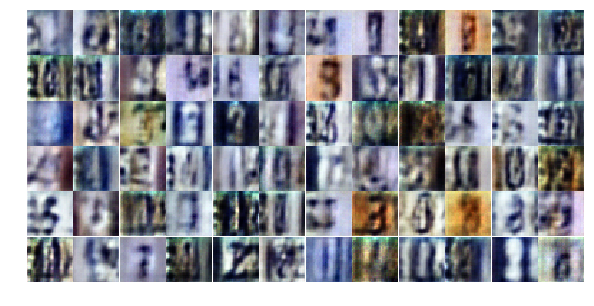

Epoch 5/25... Discriminator Loss: 0.4228... Generator Loss: 2.4618
Epoch 5/25... Discriminator Loss: 0.5556... Generator Loss: 1.1754
Epoch 5/25... Discriminator Loss: 0.6618... Generator Loss: 0.9200
Epoch 5/25... Discriminator Loss: 1.0394... Generator Loss: 0.6084
Epoch 5/25... Discriminator Loss: 0.8500... Generator Loss: 1.0012
Epoch 5/25... Discriminator Loss: 1.1873... Generator Loss: 0.4840
Epoch 5/25... Discriminator Loss: 0.8148... Generator Loss: 0.8424
Epoch 5/25... Discriminator Loss: 0.5543... Generator Loss: 1.3306
Epoch 5/25... Discriminator Loss: 0.5175... Generator Loss: 1.9429
Epoch 5/25... Discriminator Loss: 0.5031... Generator Loss: 1.2649


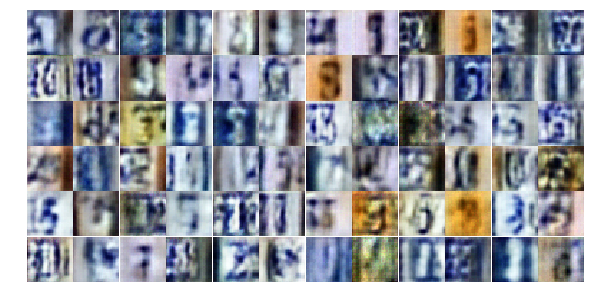

Epoch 5/25... Discriminator Loss: 0.6833... Generator Loss: 0.9691
Epoch 5/25... Discriminator Loss: 0.5103... Generator Loss: 1.5900
Epoch 5/25... Discriminator Loss: 1.0094... Generator Loss: 2.9424
Epoch 5/25... Discriminator Loss: 0.5795... Generator Loss: 1.5272
Epoch 5/25... Discriminator Loss: 0.5164... Generator Loss: 1.3047
Epoch 5/25... Discriminator Loss: 0.6398... Generator Loss: 1.5668
Epoch 6/25... Discriminator Loss: 0.6102... Generator Loss: 2.1546
Epoch 6/25... Discriminator Loss: 0.4654... Generator Loss: 1.9440
Epoch 6/25... Discriminator Loss: 0.3800... Generator Loss: 1.9554
Epoch 6/25... Discriminator Loss: 0.5023... Generator Loss: 1.7426


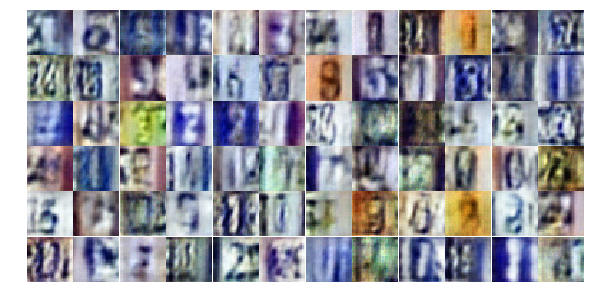

Epoch 6/25... Discriminator Loss: 0.4957... Generator Loss: 1.2791
Epoch 6/25... Discriminator Loss: 0.6452... Generator Loss: 1.9792
Epoch 6/25... Discriminator Loss: 0.6620... Generator Loss: 1.0029
Epoch 6/25... Discriminator Loss: 1.5883... Generator Loss: 0.3024
Epoch 6/25... Discriminator Loss: 1.2545... Generator Loss: 0.5252
Epoch 6/25... Discriminator Loss: 0.6051... Generator Loss: 1.1266
Epoch 6/25... Discriminator Loss: 0.5742... Generator Loss: 2.1402
Epoch 6/25... Discriminator Loss: 1.0347... Generator Loss: 1.5376
Epoch 6/25... Discriminator Loss: 0.7422... Generator Loss: 1.0520
Epoch 6/25... Discriminator Loss: 0.5692... Generator Loss: 1.3358


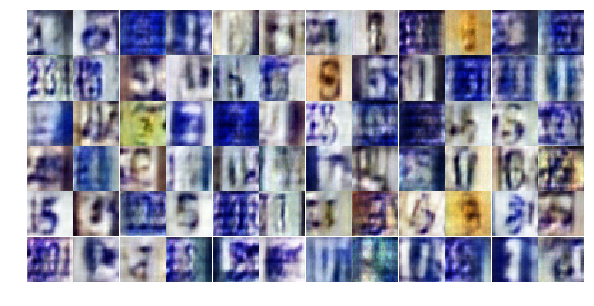

Epoch 6/25... Discriminator Loss: 0.5334... Generator Loss: 2.2176
Epoch 6/25... Discriminator Loss: 0.5620... Generator Loss: 1.4156
Epoch 6/25... Discriminator Loss: 0.6482... Generator Loss: 2.0124
Epoch 6/25... Discriminator Loss: 0.6396... Generator Loss: 1.0552
Epoch 6/25... Discriminator Loss: 0.5330... Generator Loss: 1.4665
Epoch 6/25... Discriminator Loss: 0.5479... Generator Loss: 1.1681
Epoch 6/25... Discriminator Loss: 0.5106... Generator Loss: 1.5444
Epoch 6/25... Discriminator Loss: 0.6121... Generator Loss: 1.0598
Epoch 6/25... Discriminator Loss: 0.6573... Generator Loss: 2.0511
Epoch 6/25... Discriminator Loss: 0.8660... Generator Loss: 0.7529


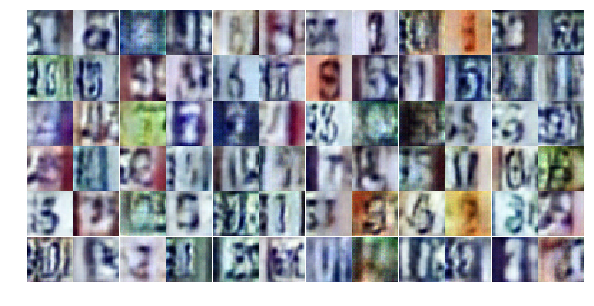

Epoch 6/25... Discriminator Loss: 0.9738... Generator Loss: 0.7103
Epoch 6/25... Discriminator Loss: 0.7027... Generator Loss: 0.9446
Epoch 6/25... Discriminator Loss: 0.6235... Generator Loss: 1.1467
Epoch 6/25... Discriminator Loss: 0.6871... Generator Loss: 0.9628
Epoch 6/25... Discriminator Loss: 0.7534... Generator Loss: 2.5440
Epoch 6/25... Discriminator Loss: 1.2208... Generator Loss: 0.5921
Epoch 6/25... Discriminator Loss: 0.7811... Generator Loss: 0.9912
Epoch 6/25... Discriminator Loss: 0.4285... Generator Loss: 1.4884
Epoch 6/25... Discriminator Loss: 0.5822... Generator Loss: 1.1978
Epoch 6/25... Discriminator Loss: 0.4441... Generator Loss: 1.6756


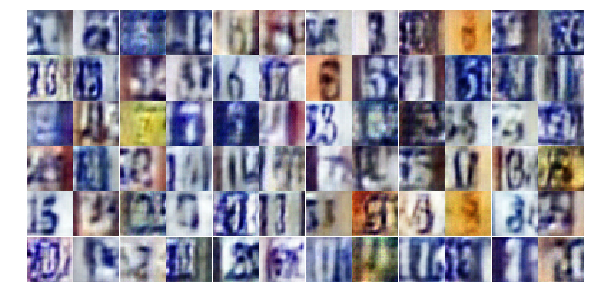

Epoch 6/25... Discriminator Loss: 0.7633... Generator Loss: 0.9478
Epoch 6/25... Discriminator Loss: 0.5954... Generator Loss: 1.6381
Epoch 6/25... Discriminator Loss: 0.8510... Generator Loss: 0.8463
Epoch 6/25... Discriminator Loss: 0.6731... Generator Loss: 1.0252
Epoch 6/25... Discriminator Loss: 0.7247... Generator Loss: 1.0352
Epoch 6/25... Discriminator Loss: 0.8438... Generator Loss: 0.8888
Epoch 6/25... Discriminator Loss: 0.5841... Generator Loss: 1.2768
Epoch 6/25... Discriminator Loss: 0.4786... Generator Loss: 1.4642
Epoch 6/25... Discriminator Loss: 0.6224... Generator Loss: 1.1888
Epoch 6/25... Discriminator Loss: 0.6992... Generator Loss: 0.9262


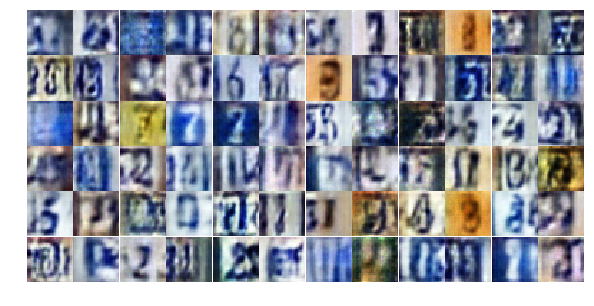

Epoch 6/25... Discriminator Loss: 2.3432... Generator Loss: 6.1034
Epoch 6/25... Discriminator Loss: 0.8405... Generator Loss: 0.9023
Epoch 6/25... Discriminator Loss: 0.8243... Generator Loss: 1.0813
Epoch 6/25... Discriminator Loss: 0.9515... Generator Loss: 2.2005
Epoch 6/25... Discriminator Loss: 0.6141... Generator Loss: 2.0029
Epoch 6/25... Discriminator Loss: 0.5921... Generator Loss: 1.1410
Epoch 6/25... Discriminator Loss: 0.8516... Generator Loss: 0.9314
Epoch 6/25... Discriminator Loss: 1.0594... Generator Loss: 0.5676
Epoch 6/25... Discriminator Loss: 0.5481... Generator Loss: 1.3715
Epoch 6/25... Discriminator Loss: 1.8358... Generator Loss: 0.2737


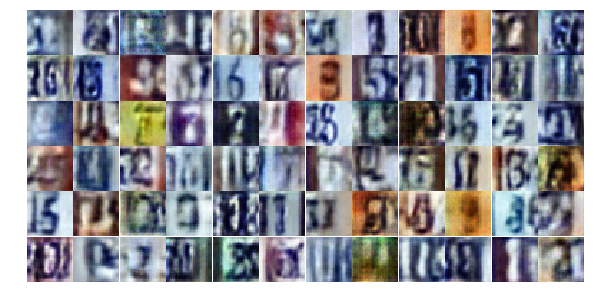

Epoch 6/25... Discriminator Loss: 0.6767... Generator Loss: 1.5350
Epoch 6/25... Discriminator Loss: 1.0062... Generator Loss: 0.5979
Epoch 6/25... Discriminator Loss: 0.5697... Generator Loss: 1.3719
Epoch 7/25... Discriminator Loss: 0.6234... Generator Loss: 2.1000
Epoch 7/25... Discriminator Loss: 0.6358... Generator Loss: 1.4058
Epoch 7/25... Discriminator Loss: 0.6342... Generator Loss: 1.1170
Epoch 7/25... Discriminator Loss: 0.6219... Generator Loss: 1.1205
Epoch 7/25... Discriminator Loss: 0.5613... Generator Loss: 1.2916
Epoch 7/25... Discriminator Loss: 0.4826... Generator Loss: 2.3691
Epoch 7/25... Discriminator Loss: 0.8910... Generator Loss: 1.2939


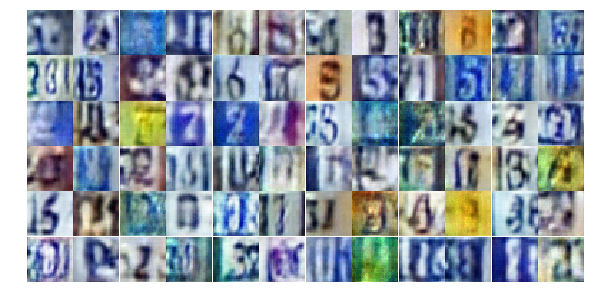

Epoch 7/25... Discriminator Loss: 0.7033... Generator Loss: 1.5179
Epoch 7/25... Discriminator Loss: 0.8392... Generator Loss: 0.8260
Epoch 7/25... Discriminator Loss: 1.2735... Generator Loss: 0.4324
Epoch 7/25... Discriminator Loss: 0.6727... Generator Loss: 1.0819
Epoch 7/25... Discriminator Loss: 0.6138... Generator Loss: 1.1744
Epoch 7/25... Discriminator Loss: 0.7120... Generator Loss: 1.0286
Epoch 7/25... Discriminator Loss: 1.0516... Generator Loss: 2.5930
Epoch 7/25... Discriminator Loss: 1.0711... Generator Loss: 2.5706
Epoch 7/25... Discriminator Loss: 0.6148... Generator Loss: 2.3566
Epoch 7/25... Discriminator Loss: 0.6965... Generator Loss: 1.0164


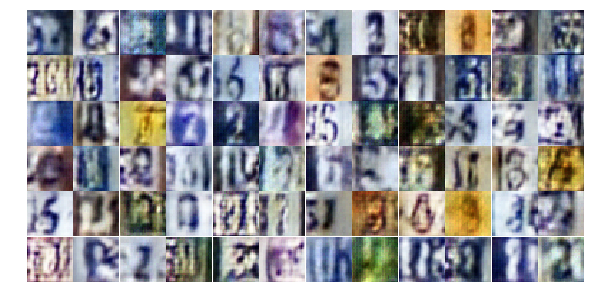

Epoch 7/25... Discriminator Loss: 0.8760... Generator Loss: 1.0355
Epoch 7/25... Discriminator Loss: 0.5285... Generator Loss: 1.3846
Epoch 7/25... Discriminator Loss: 0.9472... Generator Loss: 0.7283
Epoch 7/25... Discriminator Loss: 0.4946... Generator Loss: 1.5609
Epoch 7/25... Discriminator Loss: 0.4829... Generator Loss: 1.6579
Epoch 7/25... Discriminator Loss: 0.5912... Generator Loss: 1.1033
Epoch 7/25... Discriminator Loss: 0.7619... Generator Loss: 0.9168
Epoch 7/25... Discriminator Loss: 0.9352... Generator Loss: 0.7466
Epoch 7/25... Discriminator Loss: 0.4145... Generator Loss: 1.8205
Epoch 7/25... Discriminator Loss: 0.4423... Generator Loss: 1.7400


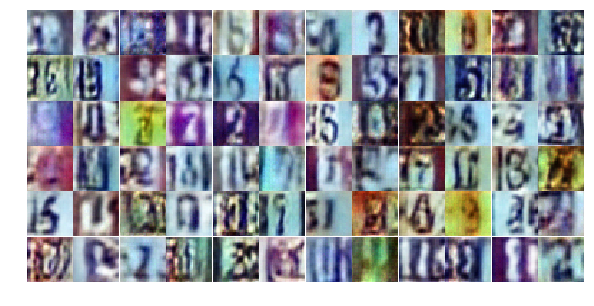

Epoch 7/25... Discriminator Loss: 0.6555... Generator Loss: 1.1364
Epoch 7/25... Discriminator Loss: 1.8356... Generator Loss: 0.2720
Epoch 7/25... Discriminator Loss: 0.6745... Generator Loss: 1.0126
Epoch 7/25... Discriminator Loss: 0.5827... Generator Loss: 1.2457
Epoch 7/25... Discriminator Loss: 0.5549... Generator Loss: 2.0249
Epoch 7/25... Discriminator Loss: 0.8097... Generator Loss: 0.9172
Epoch 7/25... Discriminator Loss: 0.5444... Generator Loss: 1.2536
Epoch 7/25... Discriminator Loss: 0.7013... Generator Loss: 0.9533
Epoch 7/25... Discriminator Loss: 0.9278... Generator Loss: 0.8422
Epoch 7/25... Discriminator Loss: 0.6549... Generator Loss: 2.4792


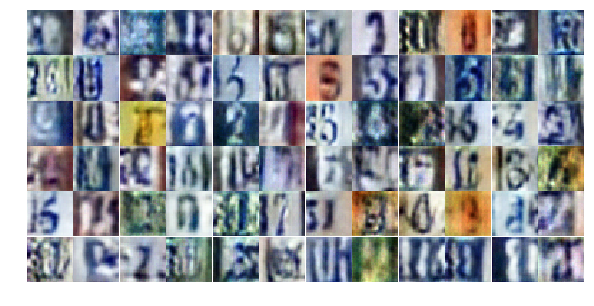

Epoch 7/25... Discriminator Loss: 1.5954... Generator Loss: 2.6474
Epoch 7/25... Discriminator Loss: 0.6727... Generator Loss: 2.7389
Epoch 7/25... Discriminator Loss: 0.5277... Generator Loss: 1.4352
Epoch 7/25... Discriminator Loss: 0.6136... Generator Loss: 1.5670
Epoch 7/25... Discriminator Loss: 0.8937... Generator Loss: 2.9522
Epoch 7/25... Discriminator Loss: 0.6266... Generator Loss: 1.3484
Epoch 7/25... Discriminator Loss: 0.5679... Generator Loss: 1.2132
Epoch 7/25... Discriminator Loss: 0.7094... Generator Loss: 1.1245
Epoch 7/25... Discriminator Loss: 0.3040... Generator Loss: 2.0892
Epoch 7/25... Discriminator Loss: 0.7955... Generator Loss: 0.9323


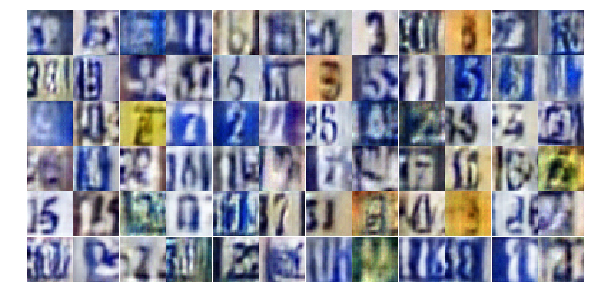

Epoch 7/25... Discriminator Loss: 0.4633... Generator Loss: 3.2709
Epoch 7/25... Discriminator Loss: 0.6848... Generator Loss: 1.0150
Epoch 7/25... Discriminator Loss: 0.7249... Generator Loss: 0.9888
Epoch 7/25... Discriminator Loss: 0.3801... Generator Loss: 1.5653
Epoch 7/25... Discriminator Loss: 0.5153... Generator Loss: 1.7163
Epoch 7/25... Discriminator Loss: 0.9483... Generator Loss: 0.8819
Epoch 7/25... Discriminator Loss: 1.1620... Generator Loss: 0.5865
Epoch 7/25... Discriminator Loss: 1.4360... Generator Loss: 0.3722
Epoch 7/25... Discriminator Loss: 0.6540... Generator Loss: 2.1269
Epoch 7/25... Discriminator Loss: 0.5632... Generator Loss: 1.1404


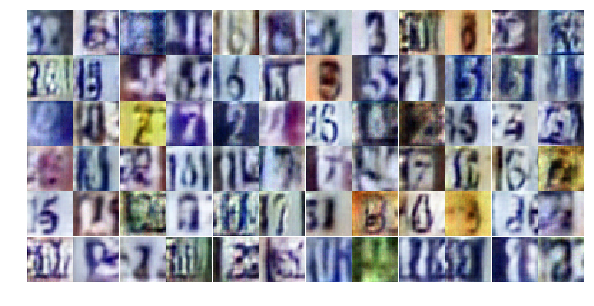

Epoch 7/25... Discriminator Loss: 0.4331... Generator Loss: 1.7059
Epoch 8/25... Discriminator Loss: 0.6218... Generator Loss: 1.1716
Epoch 8/25... Discriminator Loss: 0.7851... Generator Loss: 0.8066
Epoch 8/25... Discriminator Loss: 0.9745... Generator Loss: 0.6643
Epoch 8/25... Discriminator Loss: 0.4760... Generator Loss: 1.7865
Epoch 8/25... Discriminator Loss: 0.7867... Generator Loss: 1.2518
Epoch 8/25... Discriminator Loss: 0.6211... Generator Loss: 1.0525
Epoch 8/25... Discriminator Loss: 0.4687... Generator Loss: 1.5420
Epoch 8/25... Discriminator Loss: 0.7403... Generator Loss: 1.1792
Epoch 8/25... Discriminator Loss: 0.6578... Generator Loss: 1.1318


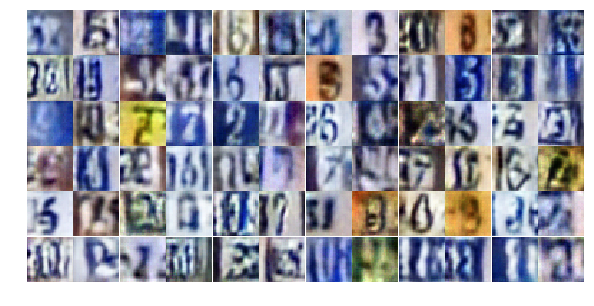

Epoch 8/25... Discriminator Loss: 0.3660... Generator Loss: 2.0378
Epoch 8/25... Discriminator Loss: 0.4338... Generator Loss: 1.6741
Epoch 8/25... Discriminator Loss: 0.8575... Generator Loss: 0.8299
Epoch 8/25... Discriminator Loss: 0.3731... Generator Loss: 1.7618
Epoch 8/25... Discriminator Loss: 1.0945... Generator Loss: 0.5559
Epoch 8/25... Discriminator Loss: 0.5725... Generator Loss: 1.7261
Epoch 8/25... Discriminator Loss: 0.4095... Generator Loss: 2.3918
Epoch 8/25... Discriminator Loss: 0.5985... Generator Loss: 1.2483
Epoch 8/25... Discriminator Loss: 0.6568... Generator Loss: 1.0363
Epoch 8/25... Discriminator Loss: 1.3930... Generator Loss: 0.3772


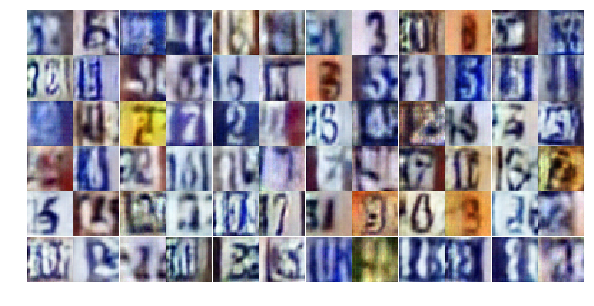

Epoch 8/25... Discriminator Loss: 0.4012... Generator Loss: 1.8071
Epoch 8/25... Discriminator Loss: 0.7077... Generator Loss: 0.8880
Epoch 8/25... Discriminator Loss: 0.7830... Generator Loss: 1.0431
Epoch 8/25... Discriminator Loss: 0.6479... Generator Loss: 1.2164
Epoch 8/25... Discriminator Loss: 0.4353... Generator Loss: 2.0123
Epoch 8/25... Discriminator Loss: 0.6255... Generator Loss: 1.7974
Epoch 8/25... Discriminator Loss: 0.7804... Generator Loss: 1.2365
Epoch 8/25... Discriminator Loss: 0.4641... Generator Loss: 1.3986
Epoch 8/25... Discriminator Loss: 0.5966... Generator Loss: 1.9484
Epoch 8/25... Discriminator Loss: 0.7764... Generator Loss: 0.9316


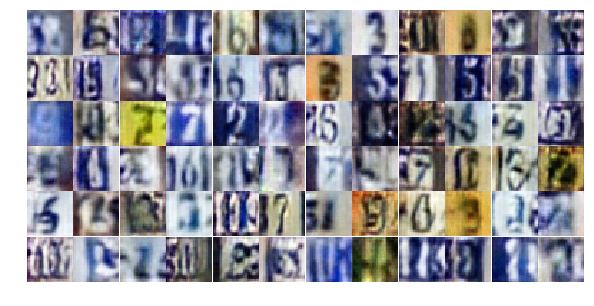

Epoch 8/25... Discriminator Loss: 0.7469... Generator Loss: 1.1085
Epoch 8/25... Discriminator Loss: 1.0395... Generator Loss: 0.6508
Epoch 8/25... Discriminator Loss: 0.6512... Generator Loss: 1.1118
Epoch 8/25... Discriminator Loss: 0.9020... Generator Loss: 0.7504
Epoch 8/25... Discriminator Loss: 0.9396... Generator Loss: 0.6970
Epoch 8/25... Discriminator Loss: 0.4342... Generator Loss: 1.4468
Epoch 8/25... Discriminator Loss: 0.7229... Generator Loss: 2.8252
Epoch 8/25... Discriminator Loss: 0.6571... Generator Loss: 1.6066
Epoch 8/25... Discriminator Loss: 0.6328... Generator Loss: 1.2984
Epoch 8/25... Discriminator Loss: 0.5920... Generator Loss: 1.1775


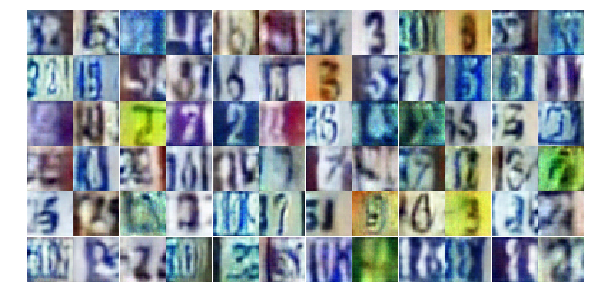

Epoch 8/25... Discriminator Loss: 0.4894... Generator Loss: 1.4202
Epoch 8/25... Discriminator Loss: 0.9047... Generator Loss: 0.8476
Epoch 8/25... Discriminator Loss: 0.6657... Generator Loss: 1.0473
Epoch 8/25... Discriminator Loss: 0.4909... Generator Loss: 2.0925
Epoch 8/25... Discriminator Loss: 0.6367... Generator Loss: 1.5715
Epoch 8/25... Discriminator Loss: 0.6566... Generator Loss: 1.0327
Epoch 8/25... Discriminator Loss: 0.4333... Generator Loss: 1.6229
Epoch 8/25... Discriminator Loss: 0.6180... Generator Loss: 1.2338
Epoch 8/25... Discriminator Loss: 0.6160... Generator Loss: 1.0137
Epoch 8/25... Discriminator Loss: 0.5458... Generator Loss: 1.6030


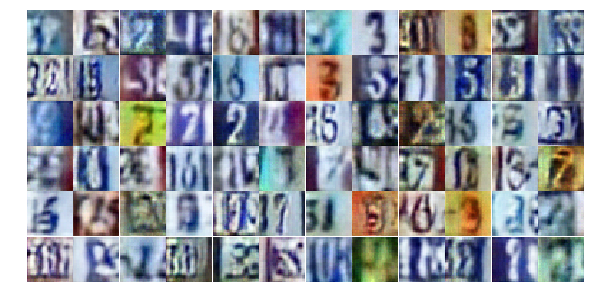

Epoch 8/25... Discriminator Loss: 0.5923... Generator Loss: 1.6884
Epoch 8/25... Discriminator Loss: 0.8495... Generator Loss: 0.7277
Epoch 8/25... Discriminator Loss: 0.4477... Generator Loss: 1.5017
Epoch 8/25... Discriminator Loss: 1.1972... Generator Loss: 0.4696
Epoch 8/25... Discriminator Loss: 0.2837... Generator Loss: 2.6463
Epoch 8/25... Discriminator Loss: 1.0656... Generator Loss: 0.7473
Epoch 8/25... Discriminator Loss: 0.5537... Generator Loss: 1.3761
Epoch 8/25... Discriminator Loss: 0.6484... Generator Loss: 2.3640
Epoch 9/25... Discriminator Loss: 0.8987... Generator Loss: 0.8583
Epoch 9/25... Discriminator Loss: 0.8697... Generator Loss: 0.7305


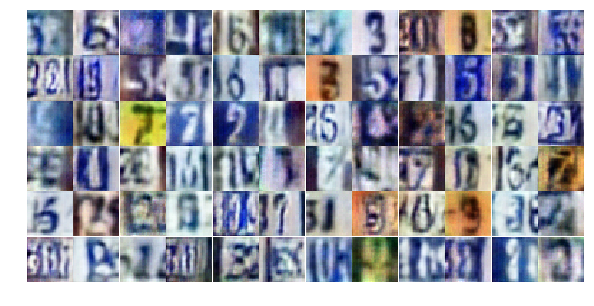

Epoch 9/25... Discriminator Loss: 0.6173... Generator Loss: 1.0830
Epoch 9/25... Discriminator Loss: 0.5870... Generator Loss: 1.2288
Epoch 9/25... Discriminator Loss: 0.7347... Generator Loss: 0.9434
Epoch 9/25... Discriminator Loss: 0.5080... Generator Loss: 1.4733
Epoch 9/25... Discriminator Loss: 0.9104... Generator Loss: 0.7578
Epoch 9/25... Discriminator Loss: 0.5446... Generator Loss: 1.4722
Epoch 9/25... Discriminator Loss: 1.0111... Generator Loss: 1.6890
Epoch 9/25... Discriminator Loss: 0.4965... Generator Loss: 1.2393
Epoch 9/25... Discriminator Loss: 0.8067... Generator Loss: 0.9414
Epoch 9/25... Discriminator Loss: 0.6134... Generator Loss: 1.1484


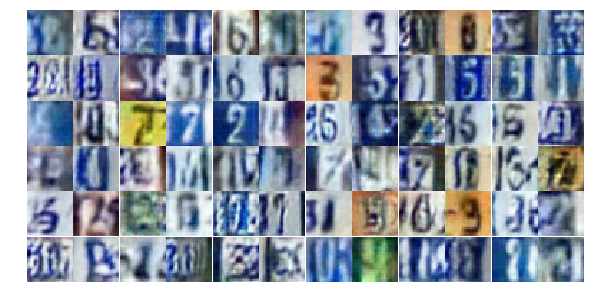

Epoch 9/25... Discriminator Loss: 1.0923... Generator Loss: 0.5524
Epoch 9/25... Discriminator Loss: 1.1006... Generator Loss: 0.5413
Epoch 9/25... Discriminator Loss: 0.6620... Generator Loss: 1.0839
Epoch 9/25... Discriminator Loss: 1.1190... Generator Loss: 0.5020
Epoch 9/25... Discriminator Loss: 0.6340... Generator Loss: 1.2373
Epoch 9/25... Discriminator Loss: 0.7856... Generator Loss: 0.9929
Epoch 9/25... Discriminator Loss: 1.1538... Generator Loss: 0.5592
Epoch 9/25... Discriminator Loss: 0.6200... Generator Loss: 1.1004
Epoch 9/25... Discriminator Loss: 0.8295... Generator Loss: 0.8244
Epoch 9/25... Discriminator Loss: 0.9377... Generator Loss: 0.6693


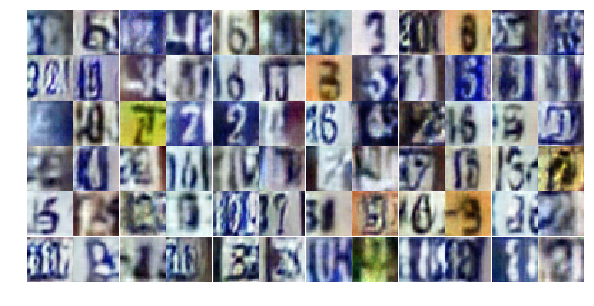

Epoch 9/25... Discriminator Loss: 0.7998... Generator Loss: 0.8853
Epoch 9/25... Discriminator Loss: 0.5686... Generator Loss: 1.5526
Epoch 9/25... Discriminator Loss: 0.5912... Generator Loss: 1.6483
Epoch 9/25... Discriminator Loss: 0.6933... Generator Loss: 1.1388
Epoch 9/25... Discriminator Loss: 0.7004... Generator Loss: 1.1147
Epoch 9/25... Discriminator Loss: 0.6379... Generator Loss: 1.6064
Epoch 9/25... Discriminator Loss: 2.1226... Generator Loss: 0.2729
Epoch 9/25... Discriminator Loss: 0.6385... Generator Loss: 1.7602
Epoch 9/25... Discriminator Loss: 0.5798... Generator Loss: 1.1353
Epoch 9/25... Discriminator Loss: 0.5311... Generator Loss: 1.2471


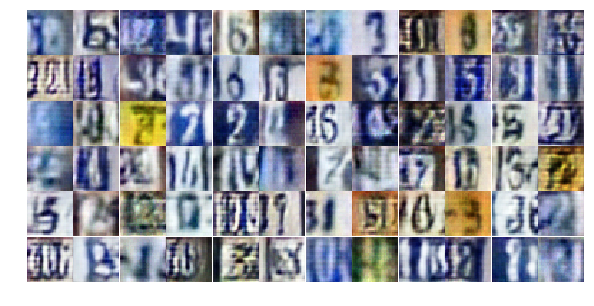

Epoch 9/25... Discriminator Loss: 0.5656... Generator Loss: 1.2838
Epoch 9/25... Discriminator Loss: 0.5238... Generator Loss: 1.3090
Epoch 9/25... Discriminator Loss: 0.9195... Generator Loss: 0.7690
Epoch 9/25... Discriminator Loss: 0.6131... Generator Loss: 1.4923
Epoch 9/25... Discriminator Loss: 0.5830... Generator Loss: 1.2860
Epoch 9/25... Discriminator Loss: 0.8277... Generator Loss: 0.8372
Epoch 9/25... Discriminator Loss: 0.5616... Generator Loss: 1.5023
Epoch 9/25... Discriminator Loss: 0.4079... Generator Loss: 1.6418
Epoch 9/25... Discriminator Loss: 1.1512... Generator Loss: 0.5684
Epoch 9/25... Discriminator Loss: 0.6910... Generator Loss: 1.0170


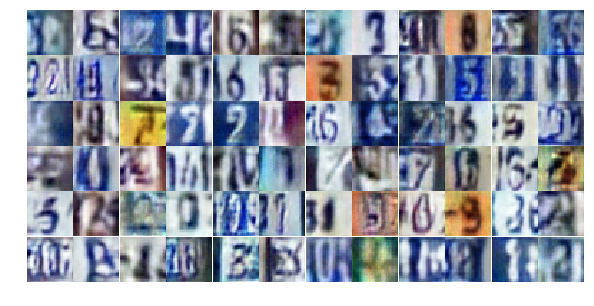

Epoch 9/25... Discriminator Loss: 0.8482... Generator Loss: 0.7468
Epoch 9/25... Discriminator Loss: 0.4100... Generator Loss: 1.7926
Epoch 9/25... Discriminator Loss: 0.6120... Generator Loss: 1.1879
Epoch 9/25... Discriminator Loss: 0.5914... Generator Loss: 1.6105
Epoch 9/25... Discriminator Loss: 0.4968... Generator Loss: 1.9214
Epoch 9/25... Discriminator Loss: 0.6362... Generator Loss: 1.0330
Epoch 9/25... Discriminator Loss: 0.8094... Generator Loss: 0.8086
Epoch 9/25... Discriminator Loss: 0.6631... Generator Loss: 1.1259
Epoch 9/25... Discriminator Loss: 0.9049... Generator Loss: 0.7292
Epoch 9/25... Discriminator Loss: 0.5607... Generator Loss: 1.8236


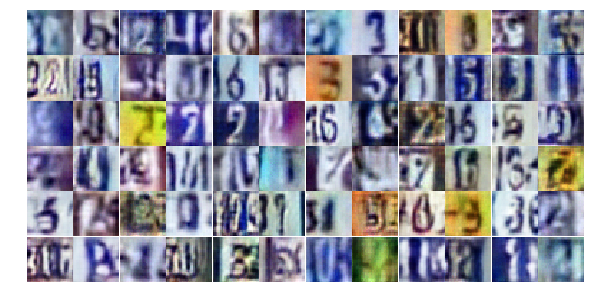

Epoch 9/25... Discriminator Loss: 0.9712... Generator Loss: 0.8551
Epoch 9/25... Discriminator Loss: 1.6298... Generator Loss: 3.7384
Epoch 9/25... Discriminator Loss: 0.5981... Generator Loss: 1.1620
Epoch 9/25... Discriminator Loss: 1.4802... Generator Loss: 0.3393
Epoch 9/25... Discriminator Loss: 0.4766... Generator Loss: 1.5902
Epoch 10/25... Discriminator Loss: 0.6103... Generator Loss: 1.3496
Epoch 10/25... Discriminator Loss: 0.5501... Generator Loss: 1.1762
Epoch 10/25... Discriminator Loss: 0.9767... Generator Loss: 0.7337
Epoch 10/25... Discriminator Loss: 0.7933... Generator Loss: 0.8979
Epoch 10/25... Discriminator Loss: 1.5498... Generator Loss: 0.3172


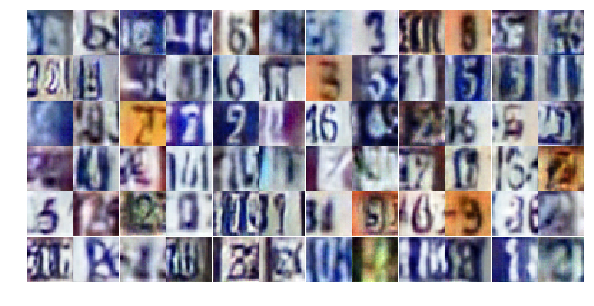

Epoch 10/25... Discriminator Loss: 0.5499... Generator Loss: 1.7646
Epoch 10/25... Discriminator Loss: 1.5736... Generator Loss: 4.2648
Epoch 10/25... Discriminator Loss: 1.0740... Generator Loss: 0.7580
Epoch 10/25... Discriminator Loss: 0.5799... Generator Loss: 1.5572
Epoch 10/25... Discriminator Loss: 0.6579... Generator Loss: 1.2193
Epoch 10/25... Discriminator Loss: 0.7004... Generator Loss: 1.1114
Epoch 10/25... Discriminator Loss: 0.7022... Generator Loss: 0.8914
Epoch 10/25... Discriminator Loss: 1.0438... Generator Loss: 0.6243
Epoch 10/25... Discriminator Loss: 0.8329... Generator Loss: 1.6874
Epoch 10/25... Discriminator Loss: 0.6811... Generator Loss: 1.0355


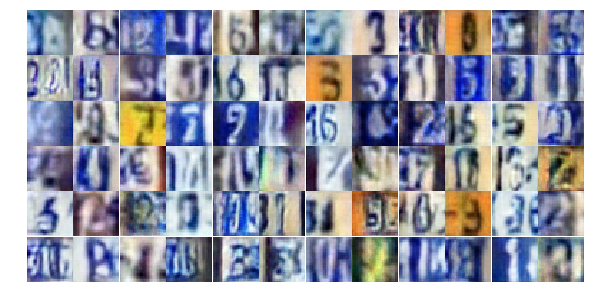

Epoch 10/25... Discriminator Loss: 1.5476... Generator Loss: 0.5625
Epoch 10/25... Discriminator Loss: 0.8369... Generator Loss: 0.9281
Epoch 10/25... Discriminator Loss: 0.7630... Generator Loss: 0.9248
Epoch 10/25... Discriminator Loss: 1.0060... Generator Loss: 0.6863
Epoch 10/25... Discriminator Loss: 0.6226... Generator Loss: 1.0743
Epoch 10/25... Discriminator Loss: 0.7994... Generator Loss: 0.8255
Epoch 10/25... Discriminator Loss: 0.7388... Generator Loss: 0.9113
Epoch 10/25... Discriminator Loss: 0.6373... Generator Loss: 1.0639
Epoch 10/25... Discriminator Loss: 0.5996... Generator Loss: 1.2061
Epoch 10/25... Discriminator Loss: 0.4621... Generator Loss: 1.5674


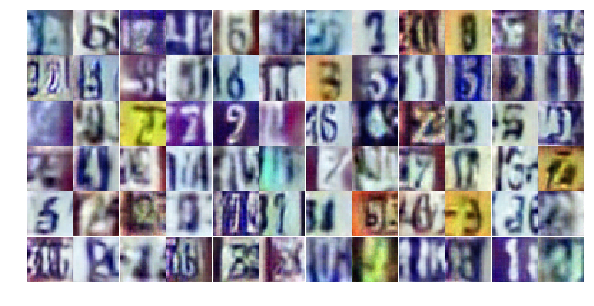

Epoch 10/25... Discriminator Loss: 0.9056... Generator Loss: 0.7752
Epoch 10/25... Discriminator Loss: 0.7157... Generator Loss: 1.1038
Epoch 10/25... Discriminator Loss: 0.4942... Generator Loss: 1.3923
Epoch 10/25... Discriminator Loss: 0.6195... Generator Loss: 1.2084
Epoch 10/25... Discriminator Loss: 1.5838... Generator Loss: 0.2993
Epoch 10/25... Discriminator Loss: 0.6339... Generator Loss: 1.2139
Epoch 10/25... Discriminator Loss: 0.3889... Generator Loss: 1.5519
Epoch 10/25... Discriminator Loss: 0.7409... Generator Loss: 1.0356
Epoch 10/25... Discriminator Loss: 0.7169... Generator Loss: 1.0228
Epoch 10/25... Discriminator Loss: 0.7991... Generator Loss: 0.7949


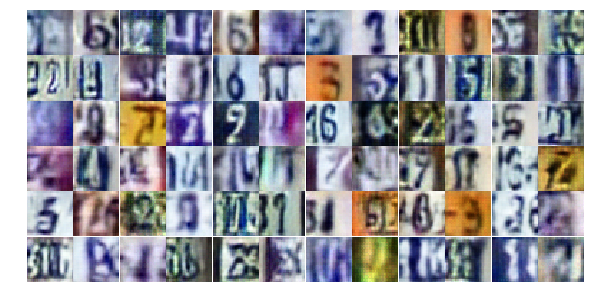

Epoch 10/25... Discriminator Loss: 0.6161... Generator Loss: 1.5396
Epoch 10/25... Discriminator Loss: 0.8640... Generator Loss: 0.8268
Epoch 10/25... Discriminator Loss: 0.7754... Generator Loss: 2.1157
Epoch 10/25... Discriminator Loss: 0.6219... Generator Loss: 1.6995
Epoch 10/25... Discriminator Loss: 0.7046... Generator Loss: 1.4366
Epoch 10/25... Discriminator Loss: 1.1516... Generator Loss: 0.5247
Epoch 10/25... Discriminator Loss: 0.6687... Generator Loss: 1.6454
Epoch 10/25... Discriminator Loss: 0.6602... Generator Loss: 0.9951
Epoch 10/25... Discriminator Loss: 0.7872... Generator Loss: 0.8458
Epoch 10/25... Discriminator Loss: 0.9933... Generator Loss: 3.1078


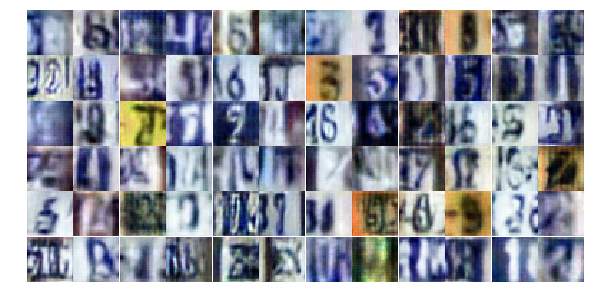

Epoch 10/25... Discriminator Loss: 0.6196... Generator Loss: 1.4399
Epoch 10/25... Discriminator Loss: 0.6409... Generator Loss: 1.3628
Epoch 10/25... Discriminator Loss: 1.0110... Generator Loss: 0.6448
Epoch 10/25... Discriminator Loss: 0.7222... Generator Loss: 1.0022
Epoch 10/25... Discriminator Loss: 0.4948... Generator Loss: 1.6112
Epoch 10/25... Discriminator Loss: 0.7237... Generator Loss: 1.0495
Epoch 10/25... Discriminator Loss: 0.5654... Generator Loss: 1.2652
Epoch 10/25... Discriminator Loss: 0.4105... Generator Loss: 1.7300
Epoch 10/25... Discriminator Loss: 0.5366... Generator Loss: 2.1474
Epoch 10/25... Discriminator Loss: 0.5149... Generator Loss: 1.4748


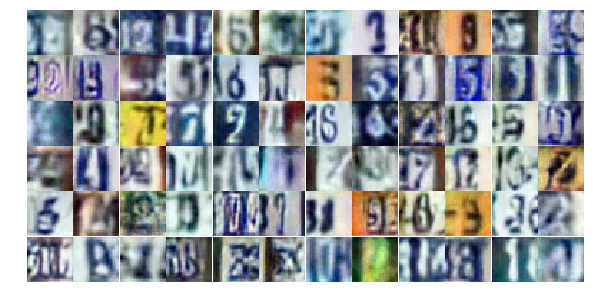

Epoch 10/25... Discriminator Loss: 0.9141... Generator Loss: 1.6208
Epoch 10/25... Discriminator Loss: 0.6195... Generator Loss: 1.1281
Epoch 10/25... Discriminator Loss: 0.6759... Generator Loss: 0.9927
Epoch 11/25... Discriminator Loss: 0.6831... Generator Loss: 1.2640
Epoch 11/25... Discriminator Loss: 0.6266... Generator Loss: 1.0760
Epoch 11/25... Discriminator Loss: 0.8982... Generator Loss: 0.8627
Epoch 11/25... Discriminator Loss: 1.0880... Generator Loss: 0.5523
Epoch 11/25... Discriminator Loss: 0.6483... Generator Loss: 1.5617
Epoch 11/25... Discriminator Loss: 1.7751... Generator Loss: 0.3411
Epoch 11/25... Discriminator Loss: 0.5663... Generator Loss: 1.5368


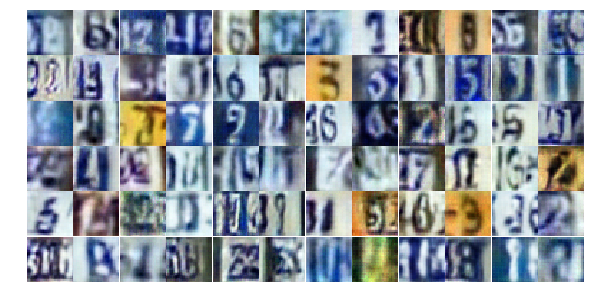

Epoch 11/25... Discriminator Loss: 0.3638... Generator Loss: 2.1185
Epoch 11/25... Discriminator Loss: 0.6695... Generator Loss: 1.1170
Epoch 11/25... Discriminator Loss: 0.4506... Generator Loss: 1.4720
Epoch 11/25... Discriminator Loss: 0.6281... Generator Loss: 1.0810
Epoch 11/25... Discriminator Loss: 0.9300... Generator Loss: 0.7336
Epoch 11/25... Discriminator Loss: 0.3927... Generator Loss: 1.9016
Epoch 11/25... Discriminator Loss: 0.6515... Generator Loss: 1.5485
Epoch 11/25... Discriminator Loss: 0.3302... Generator Loss: 1.8277
Epoch 11/25... Discriminator Loss: 0.8314... Generator Loss: 0.7872
Epoch 11/25... Discriminator Loss: 1.6550... Generator Loss: 0.3233


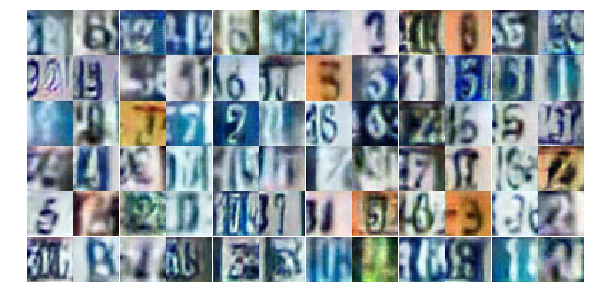

Epoch 11/25... Discriminator Loss: 4.0731... Generator Loss: 0.0733
Epoch 11/25... Discriminator Loss: 0.5730... Generator Loss: 1.5188
Epoch 11/25... Discriminator Loss: 1.1652... Generator Loss: 0.5353
Epoch 11/25... Discriminator Loss: 0.7303... Generator Loss: 0.9093
Epoch 11/25... Discriminator Loss: 0.3974... Generator Loss: 2.0265
Epoch 11/25... Discriminator Loss: 0.5631... Generator Loss: 1.5264
Epoch 11/25... Discriminator Loss: 0.6023... Generator Loss: 1.1969
Epoch 11/25... Discriminator Loss: 0.9957... Generator Loss: 0.6852
Epoch 11/25... Discriminator Loss: 0.4512... Generator Loss: 1.5627
Epoch 11/25... Discriminator Loss: 0.8667... Generator Loss: 0.7518


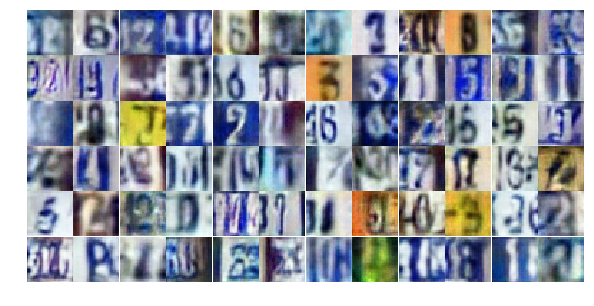

Epoch 11/25... Discriminator Loss: 0.8651... Generator Loss: 0.9305
Epoch 11/25... Discriminator Loss: 0.8036... Generator Loss: 0.9610
Epoch 11/25... Discriminator Loss: 0.8426... Generator Loss: 0.8841
Epoch 11/25... Discriminator Loss: 0.4810... Generator Loss: 1.7468
Epoch 11/25... Discriminator Loss: 0.7075... Generator Loss: 0.9235
Epoch 11/25... Discriminator Loss: 1.2220... Generator Loss: 0.4862
Epoch 11/25... Discriminator Loss: 1.1227... Generator Loss: 0.5496
Epoch 11/25... Discriminator Loss: 0.9581... Generator Loss: 0.6716
Epoch 11/25... Discriminator Loss: 0.4997... Generator Loss: 1.4457
Epoch 11/25... Discriminator Loss: 0.8165... Generator Loss: 0.9723


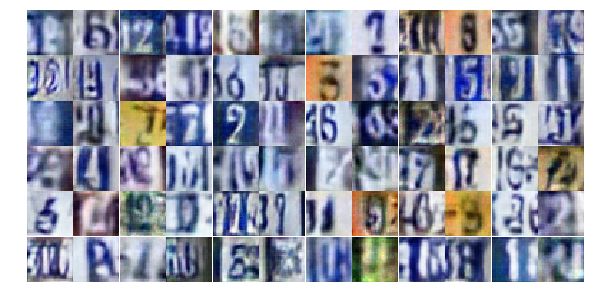

Epoch 11/25... Discriminator Loss: 0.4340... Generator Loss: 1.6472
Epoch 11/25... Discriminator Loss: 0.5063... Generator Loss: 1.2710
Epoch 11/25... Discriminator Loss: 1.2905... Generator Loss: 0.4868
Epoch 11/25... Discriminator Loss: 0.6931... Generator Loss: 1.3287
Epoch 11/25... Discriminator Loss: 0.9415... Generator Loss: 0.6799
Epoch 11/25... Discriminator Loss: 0.9051... Generator Loss: 0.7131
Epoch 11/25... Discriminator Loss: 0.3533... Generator Loss: 1.7031
Epoch 11/25... Discriminator Loss: 0.9126... Generator Loss: 0.7908
Epoch 11/25... Discriminator Loss: 1.1609... Generator Loss: 0.5212
Epoch 11/25... Discriminator Loss: 0.5568... Generator Loss: 1.1522


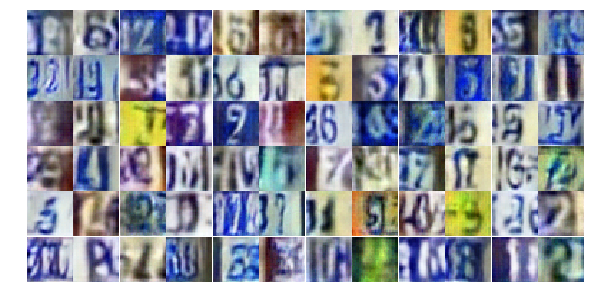

Epoch 11/25... Discriminator Loss: 1.3084... Generator Loss: 0.5025
Epoch 11/25... Discriminator Loss: 0.5020... Generator Loss: 1.3273
Epoch 11/25... Discriminator Loss: 0.5910... Generator Loss: 1.0960
Epoch 11/25... Discriminator Loss: 0.6693... Generator Loss: 1.0182
Epoch 11/25... Discriminator Loss: 0.9159... Generator Loss: 0.7306
Epoch 11/25... Discriminator Loss: 0.7282... Generator Loss: 1.1578
Epoch 11/25... Discriminator Loss: 1.1242... Generator Loss: 2.3560
Epoch 11/25... Discriminator Loss: 0.9171... Generator Loss: 1.6100
Epoch 11/25... Discriminator Loss: 0.8862... Generator Loss: 1.9262
Epoch 11/25... Discriminator Loss: 0.8199... Generator Loss: 0.9559


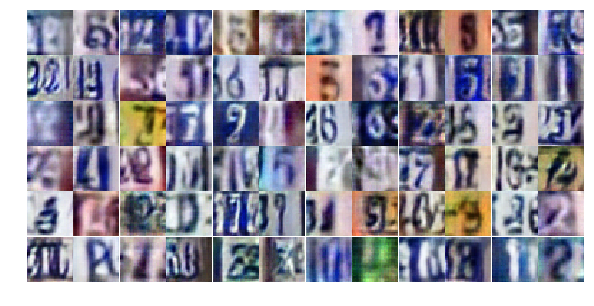

Epoch 12/25... Discriminator Loss: 0.8394... Generator Loss: 0.9422
Epoch 12/25... Discriminator Loss: 0.7426... Generator Loss: 1.4406
Epoch 12/25... Discriminator Loss: 1.1883... Generator Loss: 0.5442
Epoch 12/25... Discriminator Loss: 0.4970... Generator Loss: 1.7450
Epoch 12/25... Discriminator Loss: 0.5072... Generator Loss: 1.4327
Epoch 12/25... Discriminator Loss: 0.7117... Generator Loss: 1.0026
Epoch 12/25... Discriminator Loss: 0.6158... Generator Loss: 1.1879
Epoch 12/25... Discriminator Loss: 0.5878... Generator Loss: 1.3688
Epoch 12/25... Discriminator Loss: 0.7100... Generator Loss: 1.0575
Epoch 12/25... Discriminator Loss: 1.7652... Generator Loss: 0.2577


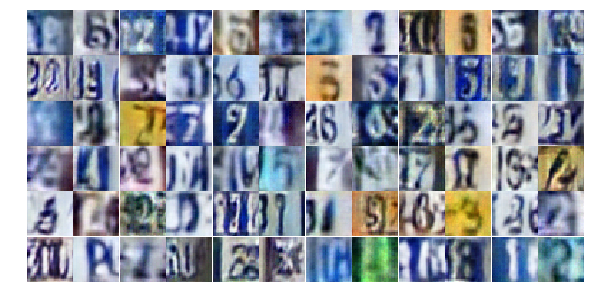

Epoch 12/25... Discriminator Loss: 0.5344... Generator Loss: 1.5138
Epoch 12/25... Discriminator Loss: 0.8381... Generator Loss: 0.8049
Epoch 12/25... Discriminator Loss: 0.5922... Generator Loss: 1.5913
Epoch 12/25... Discriminator Loss: 0.6608... Generator Loss: 1.6523
Epoch 12/25... Discriminator Loss: 0.4935... Generator Loss: 1.7475
Epoch 12/25... Discriminator Loss: 1.0513... Generator Loss: 0.8909
Epoch 12/25... Discriminator Loss: 1.5072... Generator Loss: 0.3780
Epoch 12/25... Discriminator Loss: 0.4890... Generator Loss: 1.6921
Epoch 12/25... Discriminator Loss: 0.5551... Generator Loss: 1.2123
Epoch 12/25... Discriminator Loss: 0.9358... Generator Loss: 0.6950


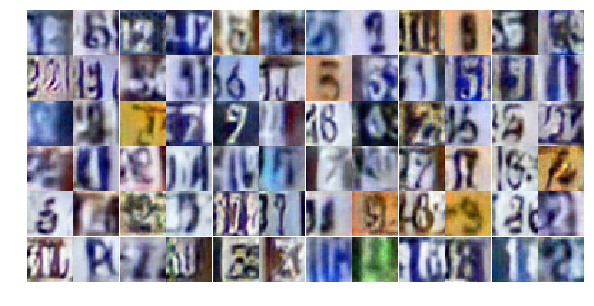

Epoch 12/25... Discriminator Loss: 0.3885... Generator Loss: 1.6731
Epoch 12/25... Discriminator Loss: 0.4573... Generator Loss: 1.4325
Epoch 12/25... Discriminator Loss: 0.6673... Generator Loss: 1.1274
Epoch 12/25... Discriminator Loss: 0.4398... Generator Loss: 1.5246
Epoch 12/25... Discriminator Loss: 0.4049... Generator Loss: 1.8879
Epoch 12/25... Discriminator Loss: 0.6181... Generator Loss: 1.1053
Epoch 12/25... Discriminator Loss: 0.9179... Generator Loss: 0.7835
Epoch 12/25... Discriminator Loss: 0.4594... Generator Loss: 1.8487
Epoch 12/25... Discriminator Loss: 0.6541... Generator Loss: 1.3187
Epoch 12/25... Discriminator Loss: 0.7996... Generator Loss: 1.2951


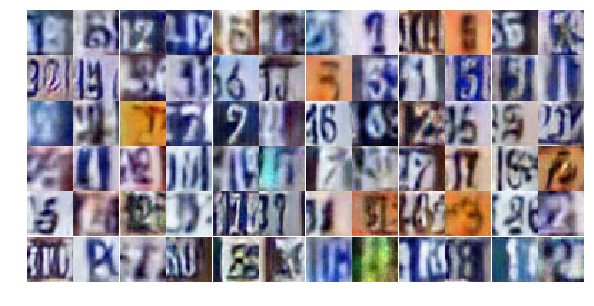

Epoch 12/25... Discriminator Loss: 0.6761... Generator Loss: 1.0660
Epoch 12/25... Discriminator Loss: 0.8282... Generator Loss: 0.8809
Epoch 12/25... Discriminator Loss: 1.1434... Generator Loss: 0.5742
Epoch 12/25... Discriminator Loss: 2.0205... Generator Loss: 0.2181
Epoch 12/25... Discriminator Loss: 0.5641... Generator Loss: 1.8008
Epoch 12/25... Discriminator Loss: 0.6505... Generator Loss: 1.1548
Epoch 12/25... Discriminator Loss: 0.9668... Generator Loss: 0.6545
Epoch 12/25... Discriminator Loss: 0.7598... Generator Loss: 1.0209
Epoch 12/25... Discriminator Loss: 0.4766... Generator Loss: 1.7337
Epoch 12/25... Discriminator Loss: 0.3677... Generator Loss: 1.5090


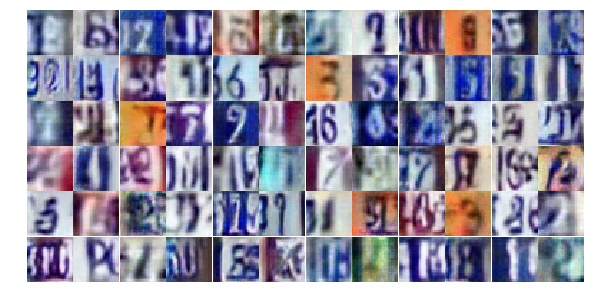

Epoch 12/25... Discriminator Loss: 0.8044... Generator Loss: 0.8442
Epoch 12/25... Discriminator Loss: 0.4410... Generator Loss: 1.4068
Epoch 12/25... Discriminator Loss: 0.4690... Generator Loss: 1.5320
Epoch 12/25... Discriminator Loss: 0.9099... Generator Loss: 0.7242
Epoch 12/25... Discriminator Loss: 0.8905... Generator Loss: 0.7545
Epoch 12/25... Discriminator Loss: 0.7647... Generator Loss: 0.9040
Epoch 12/25... Discriminator Loss: 1.5077... Generator Loss: 0.3791
Epoch 12/25... Discriminator Loss: 1.2840... Generator Loss: 0.4949
Epoch 12/25... Discriminator Loss: 0.6682... Generator Loss: 1.2975
Epoch 12/25... Discriminator Loss: 0.7591... Generator Loss: 0.8563


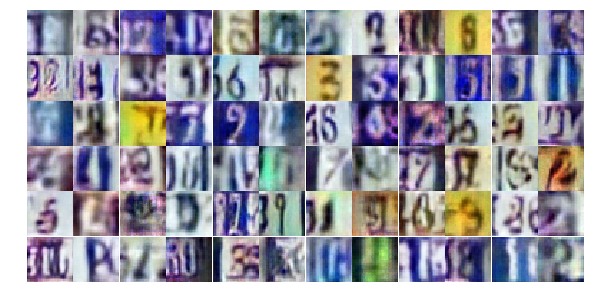

Epoch 12/25... Discriminator Loss: 0.9955... Generator Loss: 0.6998
Epoch 12/25... Discriminator Loss: 0.5742... Generator Loss: 1.3236
Epoch 12/25... Discriminator Loss: 0.6721... Generator Loss: 1.0383
Epoch 12/25... Discriminator Loss: 0.9063... Generator Loss: 0.7713
Epoch 12/25... Discriminator Loss: 0.4656... Generator Loss: 1.4248
Epoch 12/25... Discriminator Loss: 1.1525... Generator Loss: 3.2533
Epoch 12/25... Discriminator Loss: 0.7136... Generator Loss: 1.1864
Epoch 13/25... Discriminator Loss: 0.6364... Generator Loss: 1.4697
Epoch 13/25... Discriminator Loss: 0.4675... Generator Loss: 1.4129
Epoch 13/25... Discriminator Loss: 0.9192... Generator Loss: 0.7618


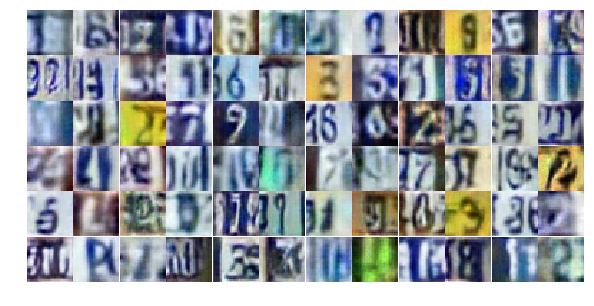

Epoch 13/25... Discriminator Loss: 0.4425... Generator Loss: 1.8429
Epoch 13/25... Discriminator Loss: 0.6541... Generator Loss: 1.4329
Epoch 13/25... Discriminator Loss: 1.1204... Generator Loss: 0.5621
Epoch 13/25... Discriminator Loss: 1.0182... Generator Loss: 0.7610
Epoch 13/25... Discriminator Loss: 0.7750... Generator Loss: 0.8950
Epoch 13/25... Discriminator Loss: 0.5108... Generator Loss: 1.3089
Epoch 13/25... Discriminator Loss: 0.4765... Generator Loss: 1.5652
Epoch 13/25... Discriminator Loss: 0.5834... Generator Loss: 1.1322
Epoch 13/25... Discriminator Loss: 0.6619... Generator Loss: 0.9846
Epoch 13/25... Discriminator Loss: 0.4491... Generator Loss: 1.7088


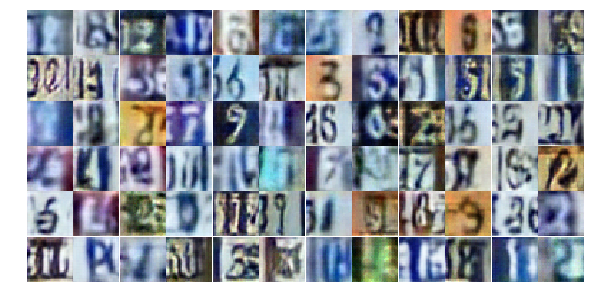

Epoch 13/25... Discriminator Loss: 0.7482... Generator Loss: 0.9629
Epoch 13/25... Discriminator Loss: 0.4831... Generator Loss: 1.3037
Epoch 13/25... Discriminator Loss: 1.0658... Generator Loss: 0.6611
Epoch 13/25... Discriminator Loss: 0.6094... Generator Loss: 1.3601
Epoch 13/25... Discriminator Loss: 0.4885... Generator Loss: 1.9436
Epoch 13/25... Discriminator Loss: 0.7711... Generator Loss: 1.9919
Epoch 13/25... Discriminator Loss: 0.8047... Generator Loss: 1.0313
Epoch 13/25... Discriminator Loss: 1.1529... Generator Loss: 0.5196
Epoch 13/25... Discriminator Loss: 0.6709... Generator Loss: 1.2520
Epoch 13/25... Discriminator Loss: 2.0749... Generator Loss: 0.2331


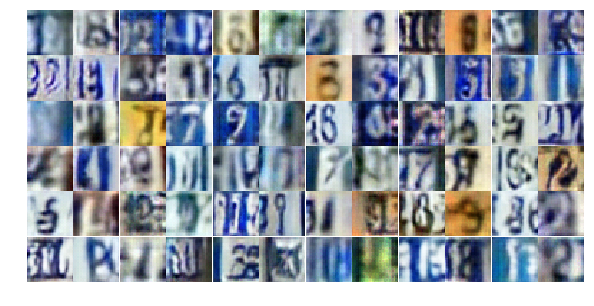

Epoch 13/25... Discriminator Loss: 0.8430... Generator Loss: 1.2866
Epoch 13/25... Discriminator Loss: 0.6424... Generator Loss: 1.1848
Epoch 13/25... Discriminator Loss: 0.7322... Generator Loss: 0.9001
Epoch 13/25... Discriminator Loss: 0.9318... Generator Loss: 0.7462
Epoch 13/25... Discriminator Loss: 0.7017... Generator Loss: 0.9350
Epoch 13/25... Discriminator Loss: 0.7767... Generator Loss: 1.0220
Epoch 13/25... Discriminator Loss: 0.9545... Generator Loss: 1.8065
Epoch 13/25... Discriminator Loss: 0.4757... Generator Loss: 1.6710
Epoch 13/25... Discriminator Loss: 0.8472... Generator Loss: 0.7753
Epoch 13/25... Discriminator Loss: 0.5526... Generator Loss: 1.4278


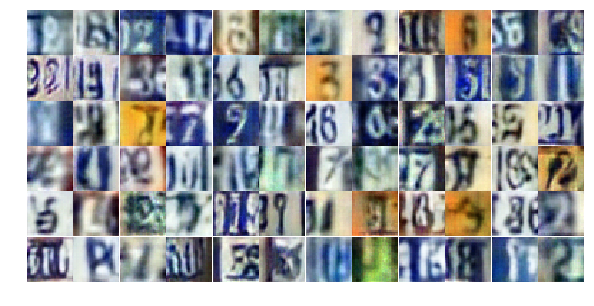

Epoch 13/25... Discriminator Loss: 0.7710... Generator Loss: 0.8994
Epoch 13/25... Discriminator Loss: 0.7085... Generator Loss: 1.3682
Epoch 13/25... Discriminator Loss: 1.1552... Generator Loss: 0.4873
Epoch 13/25... Discriminator Loss: 0.9624... Generator Loss: 0.8755
Epoch 13/25... Discriminator Loss: 0.5812... Generator Loss: 1.3770
Epoch 13/25... Discriminator Loss: 0.5086... Generator Loss: 1.2897
Epoch 13/25... Discriminator Loss: 0.5532... Generator Loss: 1.1261
Epoch 13/25... Discriminator Loss: 0.6956... Generator Loss: 1.1012
Epoch 13/25... Discriminator Loss: 0.7527... Generator Loss: 0.9093
Epoch 13/25... Discriminator Loss: 0.7205... Generator Loss: 1.4303


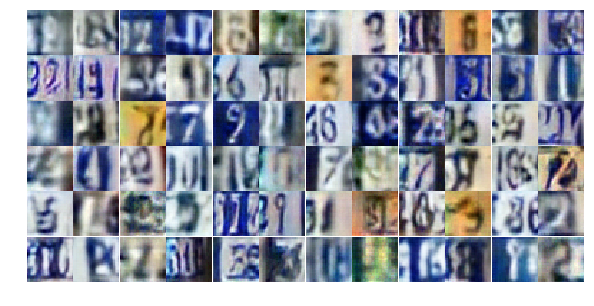

Epoch 13/25... Discriminator Loss: 0.5984... Generator Loss: 1.5439
Epoch 13/25... Discriminator Loss: 1.2845... Generator Loss: 0.7675
Epoch 13/25... Discriminator Loss: 0.7273... Generator Loss: 1.4345
Epoch 13/25... Discriminator Loss: 0.6265... Generator Loss: 1.0804
Epoch 13/25... Discriminator Loss: 1.0448... Generator Loss: 0.6317
Epoch 13/25... Discriminator Loss: 0.6757... Generator Loss: 1.5453
Epoch 13/25... Discriminator Loss: 1.1882... Generator Loss: 0.5893
Epoch 13/25... Discriminator Loss: 0.6787... Generator Loss: 1.0644
Epoch 13/25... Discriminator Loss: 0.9184... Generator Loss: 0.6697
Epoch 13/25... Discriminator Loss: 0.8053... Generator Loss: 0.7874


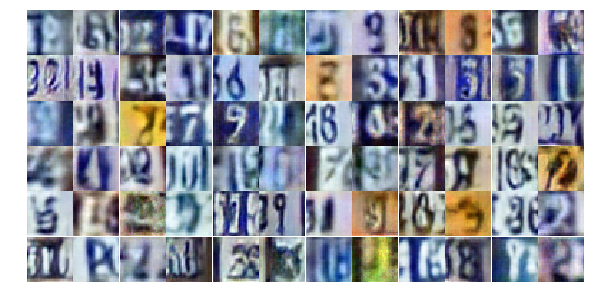

Epoch 13/25... Discriminator Loss: 0.2823... Generator Loss: 2.6511
Epoch 13/25... Discriminator Loss: 1.2336... Generator Loss: 0.4838
Epoch 13/25... Discriminator Loss: 0.4657... Generator Loss: 1.5651
Epoch 13/25... Discriminator Loss: 1.1867... Generator Loss: 0.5599
Epoch 14/25... Discriminator Loss: 1.0314... Generator Loss: 0.6433
Epoch 14/25... Discriminator Loss: 0.8725... Generator Loss: 0.8509
Epoch 14/25... Discriminator Loss: 0.8474... Generator Loss: 0.9108
Epoch 14/25... Discriminator Loss: 0.7376... Generator Loss: 2.3024
Epoch 14/25... Discriminator Loss: 0.6826... Generator Loss: 1.0806
Epoch 14/25... Discriminator Loss: 0.6990... Generator Loss: 0.9715


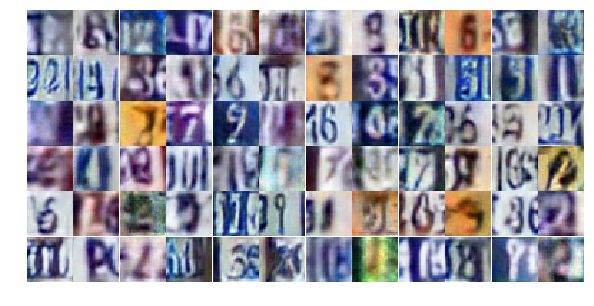

Epoch 14/25... Discriminator Loss: 0.6681... Generator Loss: 1.9332
Epoch 14/25... Discriminator Loss: 1.1533... Generator Loss: 0.4917
Epoch 14/25... Discriminator Loss: 0.5582... Generator Loss: 1.2599
Epoch 14/25... Discriminator Loss: 0.7635... Generator Loss: 0.8930
Epoch 14/25... Discriminator Loss: 1.8509... Generator Loss: 0.2314
Epoch 14/25... Discriminator Loss: 0.5351... Generator Loss: 1.1258
Epoch 14/25... Discriminator Loss: 0.5069... Generator Loss: 1.9458
Epoch 14/25... Discriminator Loss: 1.1478... Generator Loss: 0.5053
Epoch 14/25... Discriminator Loss: 1.0990... Generator Loss: 0.6212
Epoch 14/25... Discriminator Loss: 1.0971... Generator Loss: 0.5405


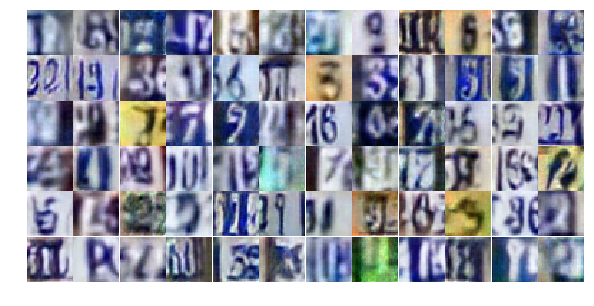

Epoch 14/25... Discriminator Loss: 0.6028... Generator Loss: 0.9944
Epoch 14/25... Discriminator Loss: 1.0581... Generator Loss: 2.5577
Epoch 14/25... Discriminator Loss: 1.0519... Generator Loss: 0.6426
Epoch 14/25... Discriminator Loss: 0.5095... Generator Loss: 1.6673
Epoch 14/25... Discriminator Loss: 1.0273... Generator Loss: 0.7268
Epoch 14/25... Discriminator Loss: 0.6159... Generator Loss: 1.2049
Epoch 14/25... Discriminator Loss: 0.8551... Generator Loss: 0.8607
Epoch 14/25... Discriminator Loss: 0.6671... Generator Loss: 1.0060
Epoch 14/25... Discriminator Loss: 0.8963... Generator Loss: 0.7235
Epoch 14/25... Discriminator Loss: 0.4957... Generator Loss: 2.3326


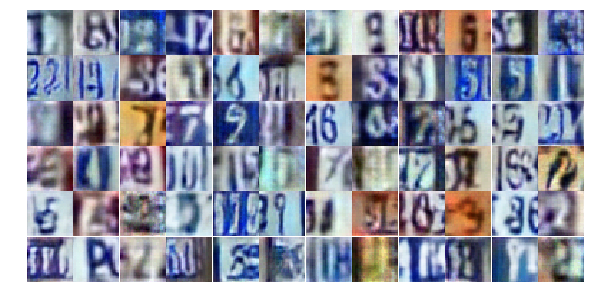

Epoch 14/25... Discriminator Loss: 1.2001... Generator Loss: 0.5068
Epoch 14/25... Discriminator Loss: 0.5434... Generator Loss: 1.2373
Epoch 14/25... Discriminator Loss: 0.3624... Generator Loss: 1.7299
Epoch 14/25... Discriminator Loss: 0.4470... Generator Loss: 1.9105
Epoch 14/25... Discriminator Loss: 0.5383... Generator Loss: 1.2362
Epoch 14/25... Discriminator Loss: 0.9595... Generator Loss: 0.6357
Epoch 14/25... Discriminator Loss: 0.7783... Generator Loss: 0.8562
Epoch 14/25... Discriminator Loss: 0.3845... Generator Loss: 2.3068
Epoch 14/25... Discriminator Loss: 0.4463... Generator Loss: 1.6322
Epoch 14/25... Discriminator Loss: 0.6781... Generator Loss: 1.0319


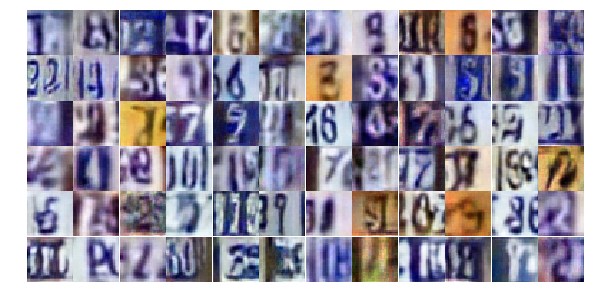

Epoch 14/25... Discriminator Loss: 1.5099... Generator Loss: 0.3903
Epoch 14/25... Discriminator Loss: 0.8376... Generator Loss: 2.0776
Epoch 14/25... Discriminator Loss: 1.1147... Generator Loss: 0.5412
Epoch 14/25... Discriminator Loss: 1.0842... Generator Loss: 0.5931
Epoch 14/25... Discriminator Loss: 0.9865... Generator Loss: 0.6217
Epoch 14/25... Discriminator Loss: 0.5663... Generator Loss: 1.2991
Epoch 14/25... Discriminator Loss: 0.7699... Generator Loss: 1.0943
Epoch 14/25... Discriminator Loss: 0.5200... Generator Loss: 1.3038
Epoch 14/25... Discriminator Loss: 2.2077... Generator Loss: 3.9037
Epoch 14/25... Discriminator Loss: 1.8725... Generator Loss: 0.2796


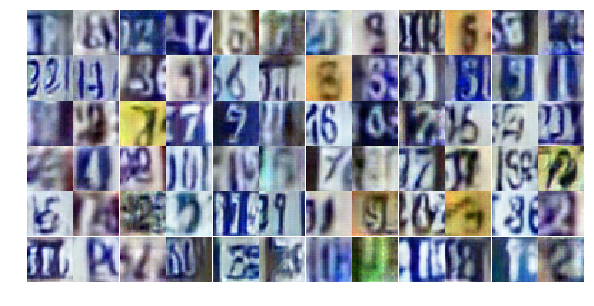

Epoch 14/25... Discriminator Loss: 0.9552... Generator Loss: 1.0149
Epoch 14/25... Discriminator Loss: 0.9302... Generator Loss: 0.7753
Epoch 14/25... Discriminator Loss: 0.7160... Generator Loss: 1.1039
Epoch 14/25... Discriminator Loss: 0.8599... Generator Loss: 0.7722
Epoch 14/25... Discriminator Loss: 0.6113... Generator Loss: 1.0940
Epoch 14/25... Discriminator Loss: 0.4850... Generator Loss: 1.7165
Epoch 14/25... Discriminator Loss: 0.7651... Generator Loss: 0.9469
Epoch 14/25... Discriminator Loss: 0.6957... Generator Loss: 1.2248
Epoch 14/25... Discriminator Loss: 0.9728... Generator Loss: 0.7282
Epoch 14/25... Discriminator Loss: 0.7988... Generator Loss: 0.8637


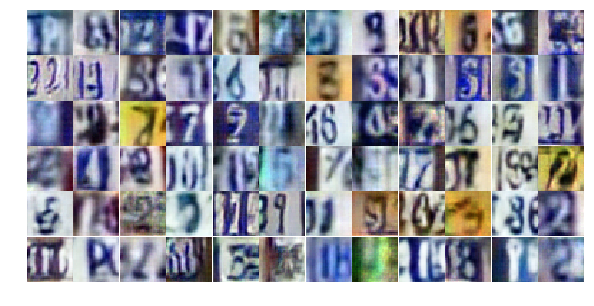

Epoch 14/25... Discriminator Loss: 0.9067... Generator Loss: 0.9719
Epoch 14/25... Discriminator Loss: 0.7683... Generator Loss: 1.0613
Epoch 15/25... Discriminator Loss: 0.7784... Generator Loss: 0.8915
Epoch 15/25... Discriminator Loss: 0.4739... Generator Loss: 1.7895
Epoch 15/25... Discriminator Loss: 0.6045... Generator Loss: 1.1150
Epoch 15/25... Discriminator Loss: 1.4463... Generator Loss: 0.4242
Epoch 15/25... Discriminator Loss: 1.0763... Generator Loss: 0.6027
Epoch 15/25... Discriminator Loss: 0.7096... Generator Loss: 1.1862
Epoch 15/25... Discriminator Loss: 1.1218... Generator Loss: 0.5801
Epoch 15/25... Discriminator Loss: 0.9539... Generator Loss: 0.7396


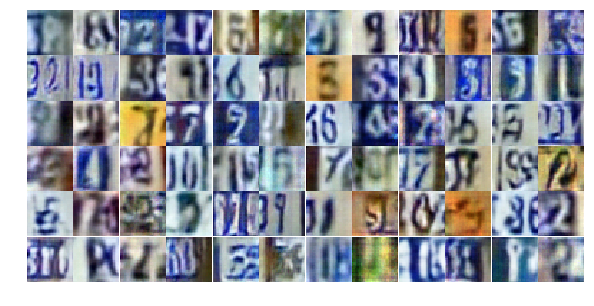

Epoch 15/25... Discriminator Loss: 0.7216... Generator Loss: 1.0182
Epoch 15/25... Discriminator Loss: 0.8205... Generator Loss: 0.9049
Epoch 15/25... Discriminator Loss: 0.6931... Generator Loss: 1.1023
Epoch 15/25... Discriminator Loss: 0.5060... Generator Loss: 1.4923
Epoch 15/25... Discriminator Loss: 0.9774... Generator Loss: 0.7708
Epoch 15/25... Discriminator Loss: 0.5824... Generator Loss: 1.1688
Epoch 15/25... Discriminator Loss: 1.1198... Generator Loss: 0.5502
Epoch 15/25... Discriminator Loss: 0.7873... Generator Loss: 0.9064
Epoch 15/25... Discriminator Loss: 0.7455... Generator Loss: 2.6197
Epoch 15/25... Discriminator Loss: 1.9660... Generator Loss: 0.2746


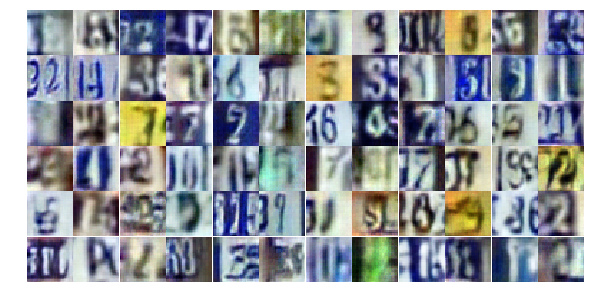

Epoch 15/25... Discriminator Loss: 0.9296... Generator Loss: 0.8716
Epoch 15/25... Discriminator Loss: 0.6642... Generator Loss: 1.0100
Epoch 15/25... Discriminator Loss: 0.5869... Generator Loss: 1.2877
Epoch 15/25... Discriminator Loss: 0.8106... Generator Loss: 0.7828
Epoch 15/25... Discriminator Loss: 1.1722... Generator Loss: 0.5562
Epoch 15/25... Discriminator Loss: 0.8555... Generator Loss: 0.8641
Epoch 15/25... Discriminator Loss: 0.7669... Generator Loss: 0.8781
Epoch 15/25... Discriminator Loss: 0.9738... Generator Loss: 0.6827
Epoch 15/25... Discriminator Loss: 0.6993... Generator Loss: 0.9563
Epoch 15/25... Discriminator Loss: 2.2156... Generator Loss: 0.1889


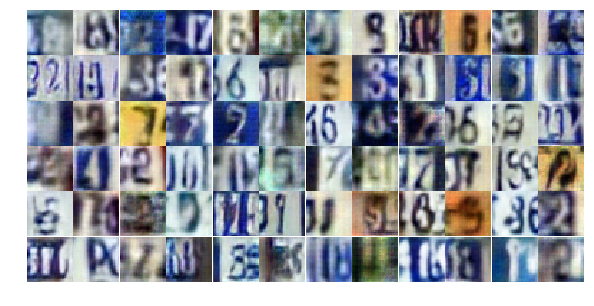

Epoch 15/25... Discriminator Loss: 1.0422... Generator Loss: 0.7870
Epoch 15/25... Discriminator Loss: 0.8033... Generator Loss: 0.9742
Epoch 15/25... Discriminator Loss: 0.6712... Generator Loss: 0.9889
Epoch 15/25... Discriminator Loss: 0.8825... Generator Loss: 0.8288
Epoch 15/25... Discriminator Loss: 0.7065... Generator Loss: 1.0223
Epoch 15/25... Discriminator Loss: 0.7517... Generator Loss: 1.3501
Epoch 15/25... Discriminator Loss: 0.7970... Generator Loss: 1.5228
Epoch 15/25... Discriminator Loss: 0.6256... Generator Loss: 2.2061
Epoch 15/25... Discriminator Loss: 0.7679... Generator Loss: 0.8449
Epoch 15/25... Discriminator Loss: 0.6168... Generator Loss: 1.1545


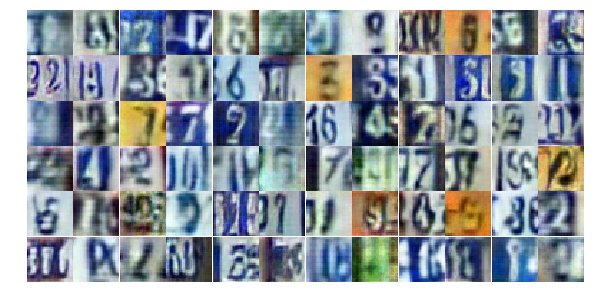

Epoch 15/25... Discriminator Loss: 0.6192... Generator Loss: 1.2065
Epoch 15/25... Discriminator Loss: 1.0244... Generator Loss: 0.6589
Epoch 15/25... Discriminator Loss: 0.7224... Generator Loss: 0.8888
Epoch 15/25... Discriminator Loss: 0.5291... Generator Loss: 1.2485
Epoch 15/25... Discriminator Loss: 0.6977... Generator Loss: 0.9338
Epoch 15/25... Discriminator Loss: 1.8708... Generator Loss: 0.2355
Epoch 15/25... Discriminator Loss: 1.3258... Generator Loss: 0.5506
Epoch 15/25... Discriminator Loss: 0.7152... Generator Loss: 1.3718
Epoch 15/25... Discriminator Loss: 0.5634... Generator Loss: 1.2524
Epoch 15/25... Discriminator Loss: 0.8294... Generator Loss: 1.3350


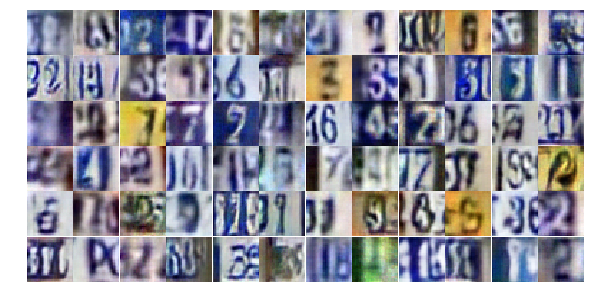

Epoch 15/25... Discriminator Loss: 0.9765... Generator Loss: 0.6610
Epoch 15/25... Discriminator Loss: 0.8328... Generator Loss: 0.9118
Epoch 15/25... Discriminator Loss: 0.4823... Generator Loss: 1.3647
Epoch 15/25... Discriminator Loss: 1.5867... Generator Loss: 0.3350
Epoch 15/25... Discriminator Loss: 0.8598... Generator Loss: 0.9090
Epoch 15/25... Discriminator Loss: 0.8432... Generator Loss: 0.8277
Epoch 15/25... Discriminator Loss: 0.8651... Generator Loss: 0.7595
Epoch 15/25... Discriminator Loss: 0.6126... Generator Loss: 1.1820
Epoch 15/25... Discriminator Loss: 1.1679... Generator Loss: 0.5237
Epoch 16/25... Discriminator Loss: 1.2790... Generator Loss: 0.5422


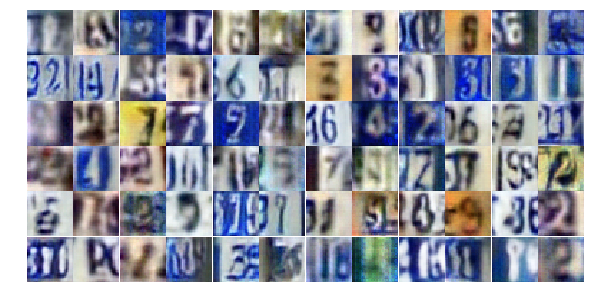

Epoch 16/25... Discriminator Loss: 0.6411... Generator Loss: 1.1230
Epoch 16/25... Discriminator Loss: 0.7843... Generator Loss: 0.9070
Epoch 16/25... Discriminator Loss: 1.0846... Generator Loss: 0.5478
Epoch 16/25... Discriminator Loss: 0.7960... Generator Loss: 2.0092
Epoch 16/25... Discriminator Loss: 0.5793... Generator Loss: 1.6787
Epoch 16/25... Discriminator Loss: 0.7157... Generator Loss: 0.9640
Epoch 16/25... Discriminator Loss: 1.5457... Generator Loss: 0.3954
Epoch 16/25... Discriminator Loss: 0.8985... Generator Loss: 0.7490
Epoch 16/25... Discriminator Loss: 0.5928... Generator Loss: 1.1317
Epoch 16/25... Discriminator Loss: 0.4427... Generator Loss: 1.6278


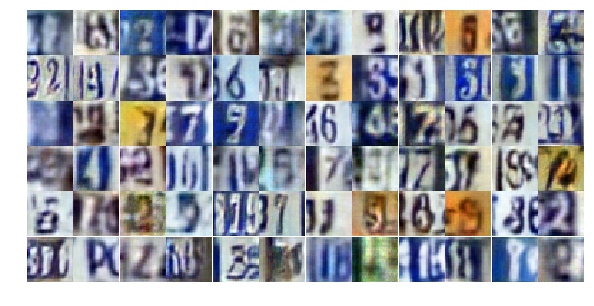

Epoch 16/25... Discriminator Loss: 1.3013... Generator Loss: 0.5021
Epoch 16/25... Discriminator Loss: 0.6603... Generator Loss: 1.0184
Epoch 16/25... Discriminator Loss: 0.8116... Generator Loss: 0.8587
Epoch 16/25... Discriminator Loss: 1.1132... Generator Loss: 0.5463
Epoch 16/25... Discriminator Loss: 2.6797... Generator Loss: 0.1711
Epoch 16/25... Discriminator Loss: 0.8639... Generator Loss: 1.0591
Epoch 16/25... Discriminator Loss: 0.9926... Generator Loss: 0.6996
Epoch 16/25... Discriminator Loss: 0.7192... Generator Loss: 1.0288
Epoch 16/25... Discriminator Loss: 0.4604... Generator Loss: 1.5909
Epoch 16/25... Discriminator Loss: 0.7749... Generator Loss: 0.8532


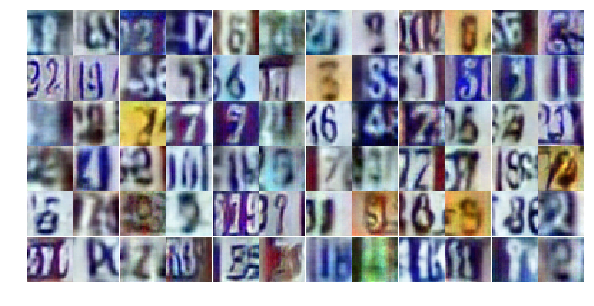

Epoch 16/25... Discriminator Loss: 0.7475... Generator Loss: 1.0474
Epoch 16/25... Discriminator Loss: 0.7815... Generator Loss: 1.0497
Epoch 16/25... Discriminator Loss: 0.8095... Generator Loss: 0.9363
Epoch 16/25... Discriminator Loss: 0.9877... Generator Loss: 0.6433
Epoch 16/25... Discriminator Loss: 0.5515... Generator Loss: 1.3925
Epoch 16/25... Discriminator Loss: 1.0130... Generator Loss: 0.6258
Epoch 16/25... Discriminator Loss: 0.6259... Generator Loss: 1.1787
Epoch 16/25... Discriminator Loss: 0.6882... Generator Loss: 1.2047
Epoch 16/25... Discriminator Loss: 0.8100... Generator Loss: 1.1831
Epoch 16/25... Discriminator Loss: 0.7377... Generator Loss: 0.9118


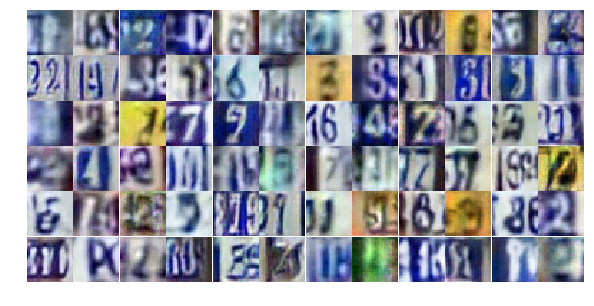

Epoch 16/25... Discriminator Loss: 0.5223... Generator Loss: 1.2656
Epoch 16/25... Discriminator Loss: 0.4716... Generator Loss: 1.4318
Epoch 16/25... Discriminator Loss: 0.6020... Generator Loss: 1.3570
Epoch 16/25... Discriminator Loss: 0.7209... Generator Loss: 1.4048
Epoch 16/25... Discriminator Loss: 1.0662... Generator Loss: 0.6360
Epoch 16/25... Discriminator Loss: 0.6682... Generator Loss: 1.3370
Epoch 16/25... Discriminator Loss: 0.6494... Generator Loss: 1.2027
Epoch 16/25... Discriminator Loss: 1.5301... Generator Loss: 0.3885
Epoch 16/25... Discriminator Loss: 1.2248... Generator Loss: 0.4605
Epoch 16/25... Discriminator Loss: 0.4967... Generator Loss: 1.4346


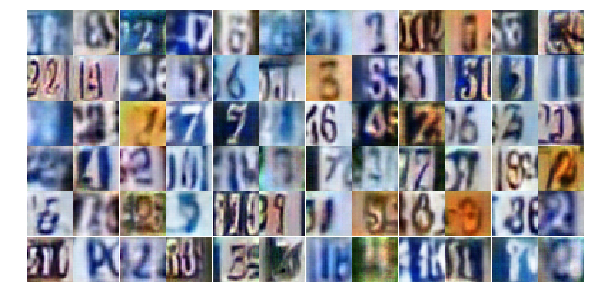

Epoch 16/25... Discriminator Loss: 0.6884... Generator Loss: 1.4998
Epoch 16/25... Discriminator Loss: 0.9970... Generator Loss: 0.6258
Epoch 16/25... Discriminator Loss: 1.7717... Generator Loss: 0.2795
Epoch 16/25... Discriminator Loss: 1.0638... Generator Loss: 0.7204
Epoch 16/25... Discriminator Loss: 1.0137... Generator Loss: 0.6656
Epoch 16/25... Discriminator Loss: 1.2239... Generator Loss: 0.4922
Epoch 16/25... Discriminator Loss: 0.4915... Generator Loss: 1.7636
Epoch 16/25... Discriminator Loss: 0.6749... Generator Loss: 1.0045
Epoch 16/25... Discriminator Loss: 0.6686... Generator Loss: 0.9694
Epoch 16/25... Discriminator Loss: 0.5899... Generator Loss: 1.1088


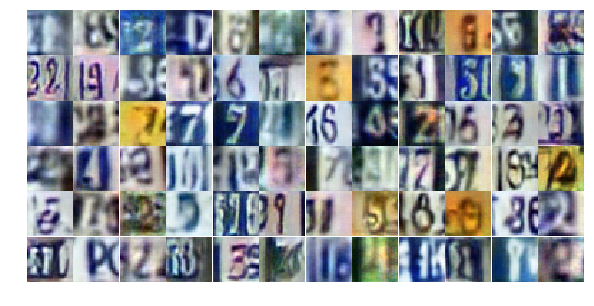

Epoch 16/25... Discriminator Loss: 1.2579... Generator Loss: 0.4253
Epoch 16/25... Discriminator Loss: 0.5823... Generator Loss: 1.3692
Epoch 16/25... Discriminator Loss: 1.7680... Generator Loss: 0.2979
Epoch 16/25... Discriminator Loss: 0.5840... Generator Loss: 1.2323
Epoch 16/25... Discriminator Loss: 0.7133... Generator Loss: 1.0266
Epoch 16/25... Discriminator Loss: 1.0325... Generator Loss: 0.6375
Epoch 17/25... Discriminator Loss: 0.8382... Generator Loss: 0.7744
Epoch 17/25... Discriminator Loss: 0.8887... Generator Loss: 0.7574
Epoch 17/25... Discriminator Loss: 0.7560... Generator Loss: 1.0685
Epoch 17/25... Discriminator Loss: 0.5594... Generator Loss: 1.3278


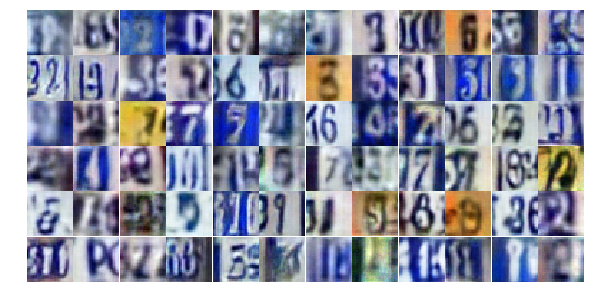

Epoch 17/25... Discriminator Loss: 0.3695... Generator Loss: 1.7662
Epoch 17/25... Discriminator Loss: 0.8354... Generator Loss: 0.7476
Epoch 17/25... Discriminator Loss: 1.8952... Generator Loss: 0.2551
Epoch 17/25... Discriminator Loss: 0.5611... Generator Loss: 1.2913
Epoch 17/25... Discriminator Loss: 1.1358... Generator Loss: 0.6107
Epoch 17/25... Discriminator Loss: 1.1169... Generator Loss: 0.5579
Epoch 17/25... Discriminator Loss: 0.9265... Generator Loss: 0.7079
Epoch 17/25... Discriminator Loss: 0.8698... Generator Loss: 0.7897
Epoch 17/25... Discriminator Loss: 0.4650... Generator Loss: 1.4551
Epoch 17/25... Discriminator Loss: 0.6241... Generator Loss: 1.9624


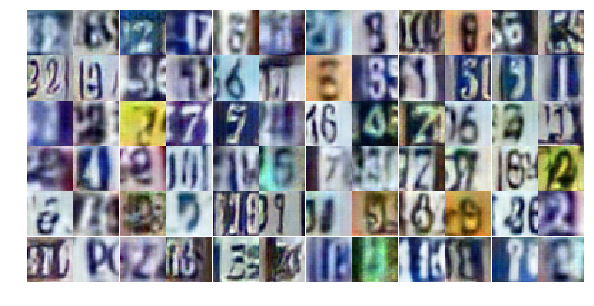

Epoch 17/25... Discriminator Loss: 1.0653... Generator Loss: 0.6406
Epoch 17/25... Discriminator Loss: 0.8115... Generator Loss: 0.7967
Epoch 17/25... Discriminator Loss: 0.3851... Generator Loss: 1.7270
Epoch 17/25... Discriminator Loss: 1.7832... Generator Loss: 0.2973
Epoch 17/25... Discriminator Loss: 0.6934... Generator Loss: 1.5463
Epoch 17/25... Discriminator Loss: 1.1709... Generator Loss: 0.5362
Epoch 17/25... Discriminator Loss: 0.7558... Generator Loss: 1.3530
Epoch 17/25... Discriminator Loss: 0.7083... Generator Loss: 1.0900
Epoch 17/25... Discriminator Loss: 0.7657... Generator Loss: 0.8776
Epoch 17/25... Discriminator Loss: 0.4964... Generator Loss: 1.3617


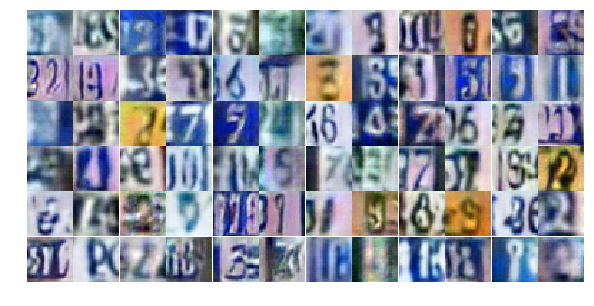

Epoch 17/25... Discriminator Loss: 1.6597... Generator Loss: 0.3353
Epoch 17/25... Discriminator Loss: 0.5735... Generator Loss: 1.4287
Epoch 17/25... Discriminator Loss: 0.4864... Generator Loss: 1.4745
Epoch 17/25... Discriminator Loss: 1.1413... Generator Loss: 0.5499
Epoch 17/25... Discriminator Loss: 1.5729... Generator Loss: 0.3385
Epoch 17/25... Discriminator Loss: 0.7015... Generator Loss: 1.0282
Epoch 17/25... Discriminator Loss: 0.6872... Generator Loss: 1.0209
Epoch 17/25... Discriminator Loss: 0.8739... Generator Loss: 0.7603
Epoch 17/25... Discriminator Loss: 0.7688... Generator Loss: 0.8980
Epoch 17/25... Discriminator Loss: 0.4237... Generator Loss: 1.7591


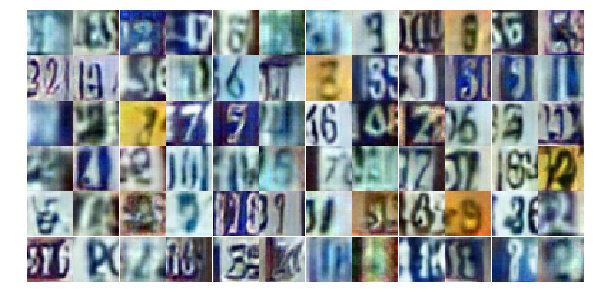

Epoch 17/25... Discriminator Loss: 0.7759... Generator Loss: 0.9121
Epoch 17/25... Discriminator Loss: 1.2400... Generator Loss: 0.5829
Epoch 17/25... Discriminator Loss: 0.7648... Generator Loss: 1.1978
Epoch 17/25... Discriminator Loss: 0.8065... Generator Loss: 0.8850
Epoch 17/25... Discriminator Loss: 0.6874... Generator Loss: 1.2248
Epoch 17/25... Discriminator Loss: 0.9566... Generator Loss: 0.6717
Epoch 17/25... Discriminator Loss: 0.6988... Generator Loss: 2.3276
Epoch 17/25... Discriminator Loss: 0.4211... Generator Loss: 1.7397
Epoch 17/25... Discriminator Loss: 0.4174... Generator Loss: 1.7413
Epoch 17/25... Discriminator Loss: 1.2574... Generator Loss: 0.4624


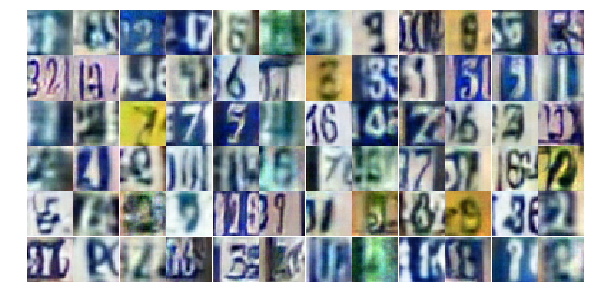

Epoch 17/25... Discriminator Loss: 0.9494... Generator Loss: 1.1212
Epoch 17/25... Discriminator Loss: 0.3048... Generator Loss: 2.1129
Epoch 17/25... Discriminator Loss: 0.7252... Generator Loss: 1.1338
Epoch 17/25... Discriminator Loss: 0.5271... Generator Loss: 1.1792
Epoch 17/25... Discriminator Loss: 0.8974... Generator Loss: 0.6791
Epoch 17/25... Discriminator Loss: 0.6506... Generator Loss: 1.3079
Epoch 17/25... Discriminator Loss: 1.5612... Generator Loss: 0.3033
Epoch 17/25... Discriminator Loss: 0.8987... Generator Loss: 0.7691
Epoch 17/25... Discriminator Loss: 0.5578... Generator Loss: 1.2924
Epoch 17/25... Discriminator Loss: 1.2800... Generator Loss: 0.5500


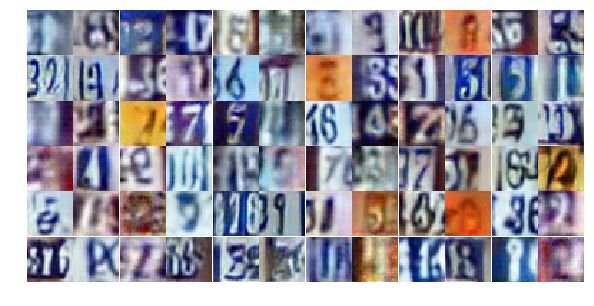

Epoch 17/25... Discriminator Loss: 0.8386... Generator Loss: 1.3200
Epoch 17/25... Discriminator Loss: 0.7439... Generator Loss: 1.4872
Epoch 17/25... Discriminator Loss: 1.7896... Generator Loss: 0.3021
Epoch 17/25... Discriminator Loss: 1.0847... Generator Loss: 0.7633
Epoch 18/25... Discriminator Loss: 0.8526... Generator Loss: 0.8785
Epoch 18/25... Discriminator Loss: 1.1285... Generator Loss: 0.5289
Epoch 18/25... Discriminator Loss: 0.8578... Generator Loss: 0.7954
Epoch 18/25... Discriminator Loss: 0.8305... Generator Loss: 0.7732
Epoch 18/25... Discriminator Loss: 1.0902... Generator Loss: 0.5838
Epoch 18/25... Discriminator Loss: 0.6468... Generator Loss: 1.2178


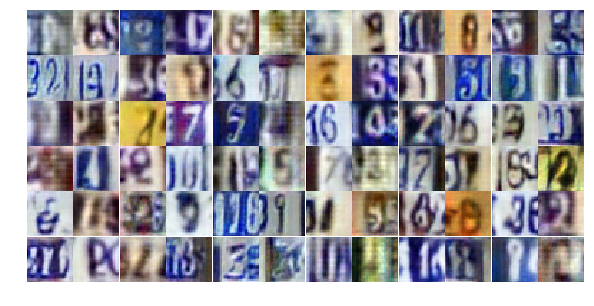

Epoch 18/25... Discriminator Loss: 0.4081... Generator Loss: 2.0407
Epoch 18/25... Discriminator Loss: 1.2749... Generator Loss: 0.5125
Epoch 18/25... Discriminator Loss: 1.1757... Generator Loss: 0.5276
Epoch 18/25... Discriminator Loss: 0.6325... Generator Loss: 1.2369
Epoch 18/25... Discriminator Loss: 0.9017... Generator Loss: 2.5287
Epoch 18/25... Discriminator Loss: 1.4760... Generator Loss: 0.3746
Epoch 18/25... Discriminator Loss: 0.6309... Generator Loss: 1.0199
Epoch 18/25... Discriminator Loss: 0.8678... Generator Loss: 0.8129
Epoch 18/25... Discriminator Loss: 0.5690... Generator Loss: 1.4044
Epoch 18/25... Discriminator Loss: 0.3543... Generator Loss: 2.2922


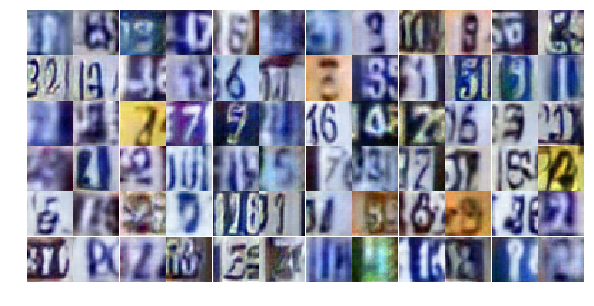

Epoch 18/25... Discriminator Loss: 0.9624... Generator Loss: 1.0252
Epoch 18/25... Discriminator Loss: 0.9538... Generator Loss: 0.6640
Epoch 18/25... Discriminator Loss: 1.2651... Generator Loss: 0.5203
Epoch 18/25... Discriminator Loss: 0.6037... Generator Loss: 1.1784
Epoch 18/25... Discriminator Loss: 0.9949... Generator Loss: 0.6510
Epoch 18/25... Discriminator Loss: 1.1501... Generator Loss: 0.5513
Epoch 18/25... Discriminator Loss: 0.9080... Generator Loss: 0.9489
Epoch 18/25... Discriminator Loss: 0.8125... Generator Loss: 0.8526
Epoch 18/25... Discriminator Loss: 0.7529... Generator Loss: 1.7139
Epoch 18/25... Discriminator Loss: 0.6462... Generator Loss: 1.1824


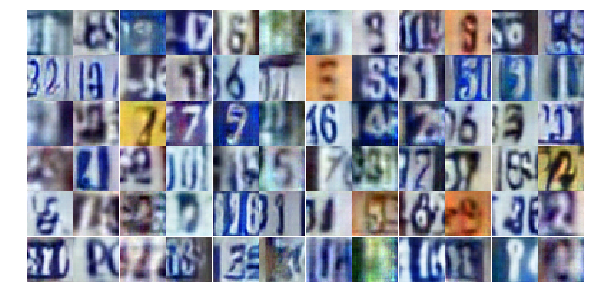

Epoch 18/25... Discriminator Loss: 0.5253... Generator Loss: 1.2012
Epoch 18/25... Discriminator Loss: 0.5757... Generator Loss: 1.2454
Epoch 18/25... Discriminator Loss: 0.7861... Generator Loss: 0.9108
Epoch 18/25... Discriminator Loss: 0.5846... Generator Loss: 1.2178
Epoch 18/25... Discriminator Loss: 1.0970... Generator Loss: 0.6044
Epoch 18/25... Discriminator Loss: 0.6268... Generator Loss: 1.4999
Epoch 18/25... Discriminator Loss: 0.8588... Generator Loss: 0.8127
Epoch 18/25... Discriminator Loss: 0.6578... Generator Loss: 1.5669
Epoch 18/25... Discriminator Loss: 0.6531... Generator Loss: 1.0734
Epoch 18/25... Discriminator Loss: 0.6925... Generator Loss: 1.0371


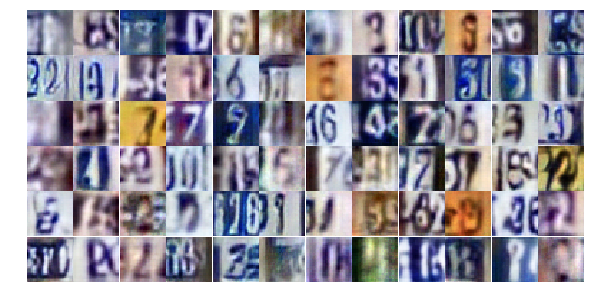

Epoch 18/25... Discriminator Loss: 0.6394... Generator Loss: 1.2701
Epoch 18/25... Discriminator Loss: 0.7412... Generator Loss: 0.9419
Epoch 18/25... Discriminator Loss: 0.6510... Generator Loss: 1.0105
Epoch 18/25... Discriminator Loss: 0.6640... Generator Loss: 0.9526
Epoch 18/25... Discriminator Loss: 0.7950... Generator Loss: 1.7131
Epoch 18/25... Discriminator Loss: 0.6576... Generator Loss: 0.9566
Epoch 18/25... Discriminator Loss: 1.0066... Generator Loss: 0.6485
Epoch 18/25... Discriminator Loss: 2.0208... Generator Loss: 3.6964
Epoch 18/25... Discriminator Loss: 0.6855... Generator Loss: 1.6049
Epoch 18/25... Discriminator Loss: 0.6855... Generator Loss: 1.0836


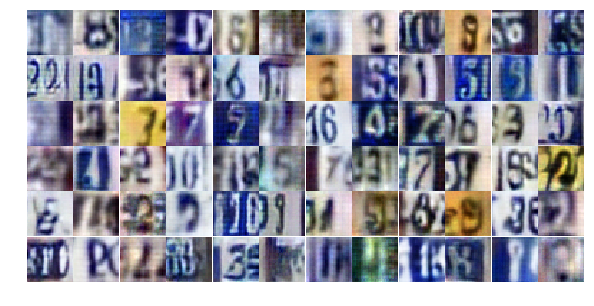

Epoch 18/25... Discriminator Loss: 0.8113... Generator Loss: 0.8351
Epoch 18/25... Discriminator Loss: 0.8393... Generator Loss: 0.7810
Epoch 18/25... Discriminator Loss: 0.9532... Generator Loss: 1.0544
Epoch 18/25... Discriminator Loss: 0.8532... Generator Loss: 0.9160
Epoch 18/25... Discriminator Loss: 0.6967... Generator Loss: 0.9747
Epoch 18/25... Discriminator Loss: 0.6351... Generator Loss: 1.1243
Epoch 18/25... Discriminator Loss: 0.5909... Generator Loss: 1.1325
Epoch 18/25... Discriminator Loss: 0.5344... Generator Loss: 1.3898
Epoch 18/25... Discriminator Loss: 1.9414... Generator Loss: 0.2277
Epoch 18/25... Discriminator Loss: 1.1959... Generator Loss: 0.5649


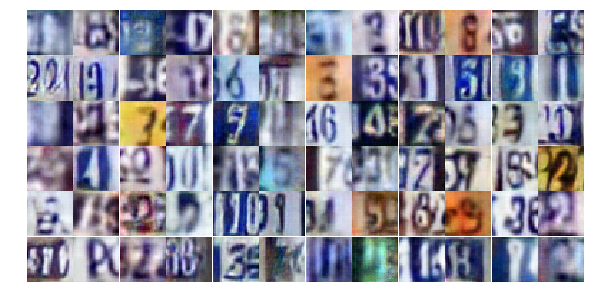

Epoch 18/25... Discriminator Loss: 0.8621... Generator Loss: 0.9036
Epoch 19/25... Discriminator Loss: 0.9154... Generator Loss: 0.8641
Epoch 19/25... Discriminator Loss: 1.2829... Generator Loss: 0.4370
Epoch 19/25... Discriminator Loss: 0.8266... Generator Loss: 0.9122
Epoch 19/25... Discriminator Loss: 0.5151... Generator Loss: 1.4350
Epoch 19/25... Discriminator Loss: 0.9483... Generator Loss: 0.7784
Epoch 19/25... Discriminator Loss: 0.4567... Generator Loss: 1.5849
Epoch 19/25... Discriminator Loss: 0.8877... Generator Loss: 0.8355
Epoch 19/25... Discriminator Loss: 0.6528... Generator Loss: 1.3675
Epoch 19/25... Discriminator Loss: 1.0460... Generator Loss: 0.6049


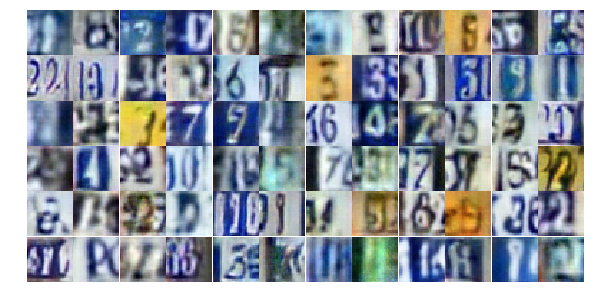

Epoch 19/25... Discriminator Loss: 0.5730... Generator Loss: 1.1001
Epoch 19/25... Discriminator Loss: 0.9821... Generator Loss: 0.6672
Epoch 19/25... Discriminator Loss: 0.7492... Generator Loss: 0.9345
Epoch 19/25... Discriminator Loss: 1.2442... Generator Loss: 0.4567
Epoch 19/25... Discriminator Loss: 0.7345... Generator Loss: 1.0586
Epoch 19/25... Discriminator Loss: 0.7523... Generator Loss: 1.0136
Epoch 19/25... Discriminator Loss: 1.5496... Generator Loss: 0.3655
Epoch 19/25... Discriminator Loss: 0.7518... Generator Loss: 0.9706
Epoch 19/25... Discriminator Loss: 0.8867... Generator Loss: 1.3516
Epoch 19/25... Discriminator Loss: 1.2872... Generator Loss: 0.5945


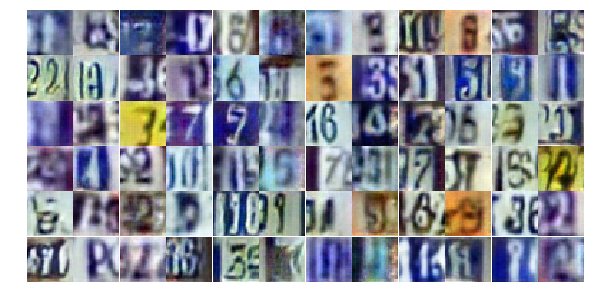

Epoch 19/25... Discriminator Loss: 0.9887... Generator Loss: 0.6523
Epoch 19/25... Discriminator Loss: 1.3448... Generator Loss: 0.5017
Epoch 19/25... Discriminator Loss: 1.2651... Generator Loss: 0.5060
Epoch 19/25... Discriminator Loss: 0.7503... Generator Loss: 1.2476
Epoch 19/25... Discriminator Loss: 1.1403... Generator Loss: 0.6618
Epoch 19/25... Discriminator Loss: 0.7981... Generator Loss: 1.2245
Epoch 19/25... Discriminator Loss: 0.9122... Generator Loss: 0.6810
Epoch 19/25... Discriminator Loss: 0.5965... Generator Loss: 1.0990
Epoch 19/25... Discriminator Loss: 0.9127... Generator Loss: 0.7700
Epoch 19/25... Discriminator Loss: 1.1671... Generator Loss: 0.5084


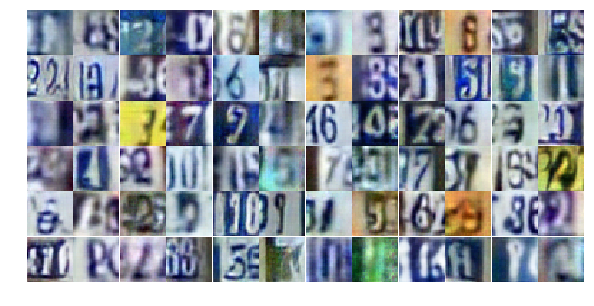

Epoch 19/25... Discriminator Loss: 0.8162... Generator Loss: 0.9652
Epoch 19/25... Discriminator Loss: 0.7595... Generator Loss: 0.8338
Epoch 19/25... Discriminator Loss: 0.5548... Generator Loss: 1.3486
Epoch 19/25... Discriminator Loss: 0.5950... Generator Loss: 1.3523
Epoch 19/25... Discriminator Loss: 0.7560... Generator Loss: 0.9130
Epoch 19/25... Discriminator Loss: 1.8686... Generator Loss: 0.2353
Epoch 19/25... Discriminator Loss: 1.0495... Generator Loss: 1.2681
Epoch 19/25... Discriminator Loss: 0.6461... Generator Loss: 1.2047
Epoch 19/25... Discriminator Loss: 0.7766... Generator Loss: 1.0485
Epoch 19/25... Discriminator Loss: 0.6689... Generator Loss: 0.9504


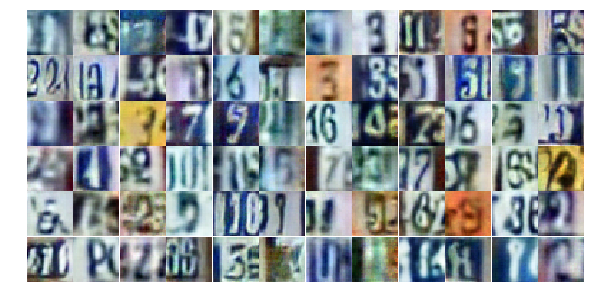

Epoch 19/25... Discriminator Loss: 0.8942... Generator Loss: 0.7275
Epoch 19/25... Discriminator Loss: 0.7116... Generator Loss: 0.9738
Epoch 19/25... Discriminator Loss: 1.8132... Generator Loss: 0.2317
Epoch 19/25... Discriminator Loss: 0.8073... Generator Loss: 0.8945
Epoch 19/25... Discriminator Loss: 0.6625... Generator Loss: 1.3465
Epoch 19/25... Discriminator Loss: 1.1117... Generator Loss: 0.7757
Epoch 19/25... Discriminator Loss: 1.2358... Generator Loss: 2.1541
Epoch 19/25... Discriminator Loss: 0.6135... Generator Loss: 1.1892
Epoch 19/25... Discriminator Loss: 0.5340... Generator Loss: 1.5603
Epoch 19/25... Discriminator Loss: 0.9269... Generator Loss: 0.8546


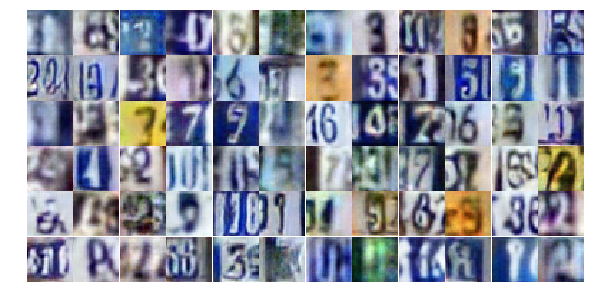

Epoch 19/25... Discriminator Loss: 0.7988... Generator Loss: 0.8144
Epoch 19/25... Discriminator Loss: 0.7971... Generator Loss: 0.8114
Epoch 19/25... Discriminator Loss: 1.0038... Generator Loss: 2.5438
Epoch 19/25... Discriminator Loss: 1.0544... Generator Loss: 0.6649
Epoch 19/25... Discriminator Loss: 1.0443... Generator Loss: 0.6076
Epoch 19/25... Discriminator Loss: 0.7332... Generator Loss: 0.9557
Epoch 19/25... Discriminator Loss: 1.6905... Generator Loss: 0.3280
Epoch 19/25... Discriminator Loss: 0.6762... Generator Loss: 1.0059
Epoch 20/25... Discriminator Loss: 0.8335... Generator Loss: 0.7798
Epoch 20/25... Discriminator Loss: 0.8660... Generator Loss: 1.0215


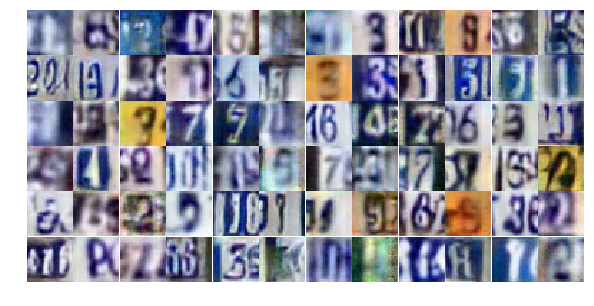

Epoch 20/25... Discriminator Loss: 0.5604... Generator Loss: 1.3436
Epoch 20/25... Discriminator Loss: 1.0097... Generator Loss: 0.6456
Epoch 20/25... Discriminator Loss: 1.4023... Generator Loss: 0.4401
Epoch 20/25... Discriminator Loss: 1.1918... Generator Loss: 0.5348
Epoch 20/25... Discriminator Loss: 0.6413... Generator Loss: 1.1901
Epoch 20/25... Discriminator Loss: 0.8788... Generator Loss: 0.7093
Epoch 20/25... Discriminator Loss: 0.5319... Generator Loss: 1.5686
Epoch 20/25... Discriminator Loss: 0.7669... Generator Loss: 0.8786
Epoch 20/25... Discriminator Loss: 0.8391... Generator Loss: 1.0171
Epoch 20/25... Discriminator Loss: 0.8883... Generator Loss: 0.6808


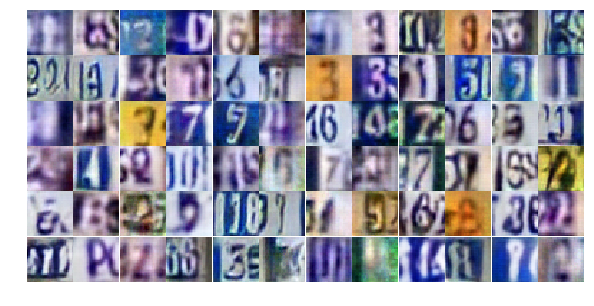

Epoch 20/25... Discriminator Loss: 1.3534... Generator Loss: 0.5224
Epoch 20/25... Discriminator Loss: 1.0305... Generator Loss: 0.6037
Epoch 20/25... Discriminator Loss: 0.6600... Generator Loss: 1.1823
Epoch 20/25... Discriminator Loss: 0.7182... Generator Loss: 1.2069
Epoch 20/25... Discriminator Loss: 0.8538... Generator Loss: 0.7801
Epoch 20/25... Discriminator Loss: 0.9799... Generator Loss: 0.6378
Epoch 20/25... Discriminator Loss: 4.7052... Generator Loss: 7.0629
Epoch 20/25... Discriminator Loss: 1.9951... Generator Loss: 0.3470
Epoch 20/25... Discriminator Loss: 0.8239... Generator Loss: 1.3123
Epoch 20/25... Discriminator Loss: 1.1095... Generator Loss: 0.7234


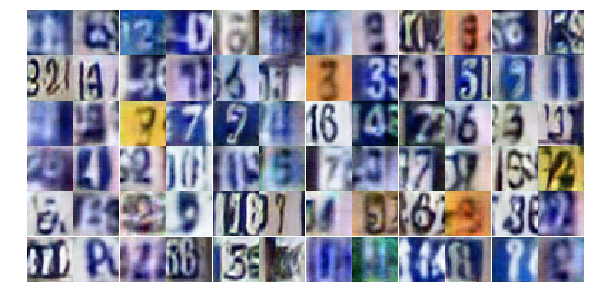

Epoch 20/25... Discriminator Loss: 0.9170... Generator Loss: 0.7841
Epoch 20/25... Discriminator Loss: 0.7831... Generator Loss: 0.9997
Epoch 20/25... Discriminator Loss: 0.4418... Generator Loss: 1.5886
Epoch 20/25... Discriminator Loss: 1.4084... Generator Loss: 0.4362
Epoch 20/25... Discriminator Loss: 0.9357... Generator Loss: 0.8072
Epoch 20/25... Discriminator Loss: 0.7443... Generator Loss: 0.9372
Epoch 20/25... Discriminator Loss: 0.5743... Generator Loss: 1.7880
Epoch 20/25... Discriminator Loss: 1.5855... Generator Loss: 0.3280
Epoch 20/25... Discriminator Loss: 1.0234... Generator Loss: 0.6321
Epoch 20/25... Discriminator Loss: 0.3893... Generator Loss: 1.5243


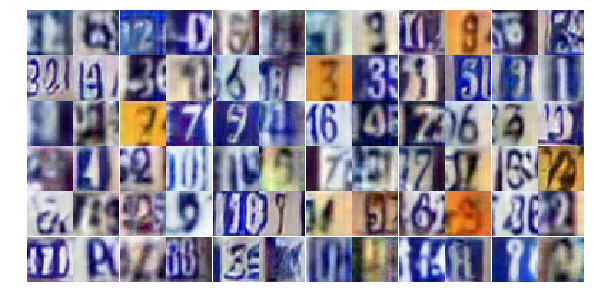

Epoch 20/25... Discriminator Loss: 0.7504... Generator Loss: 1.1732
Epoch 20/25... Discriminator Loss: 0.6154... Generator Loss: 1.1543
Epoch 20/25... Discriminator Loss: 1.1417... Generator Loss: 0.5685
Epoch 20/25... Discriminator Loss: 0.6692... Generator Loss: 1.2812
Epoch 20/25... Discriminator Loss: 1.0074... Generator Loss: 0.8068
Epoch 20/25... Discriminator Loss: 0.7602... Generator Loss: 1.0164
Epoch 20/25... Discriminator Loss: 1.0115... Generator Loss: 0.6435
Epoch 20/25... Discriminator Loss: 0.6882... Generator Loss: 1.3785
Epoch 20/25... Discriminator Loss: 0.6724... Generator Loss: 0.9918
Epoch 20/25... Discriminator Loss: 1.0430... Generator Loss: 0.6500


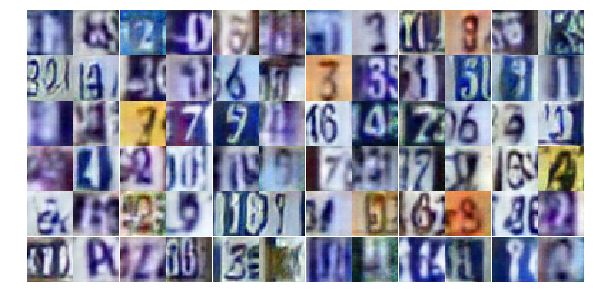

Epoch 20/25... Discriminator Loss: 0.5554... Generator Loss: 1.2589
Epoch 20/25... Discriminator Loss: 1.0073... Generator Loss: 0.6313
Epoch 20/25... Discriminator Loss: 0.5911... Generator Loss: 1.7677
Epoch 20/25... Discriminator Loss: 0.6818... Generator Loss: 1.0453
Epoch 20/25... Discriminator Loss: 0.9422... Generator Loss: 0.7979
Epoch 20/25... Discriminator Loss: 1.1291... Generator Loss: 0.5795
Epoch 20/25... Discriminator Loss: 1.2731... Generator Loss: 0.4675
Epoch 20/25... Discriminator Loss: 0.5157... Generator Loss: 1.4657
Epoch 20/25... Discriminator Loss: 0.6515... Generator Loss: 1.0834
Epoch 20/25... Discriminator Loss: 0.7460... Generator Loss: 1.0204


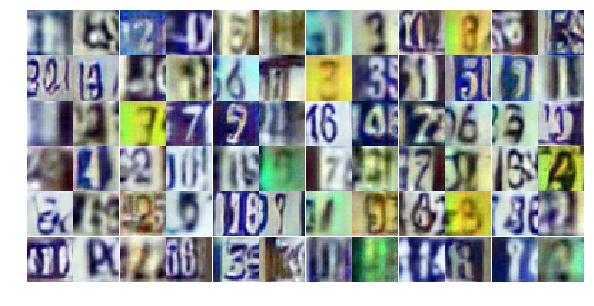

Epoch 20/25... Discriminator Loss: 0.6687... Generator Loss: 1.1208
Epoch 20/25... Discriminator Loss: 0.6941... Generator Loss: 1.3156
Epoch 20/25... Discriminator Loss: 0.6266... Generator Loss: 1.0875
Epoch 20/25... Discriminator Loss: 0.8486... Generator Loss: 1.5191
Epoch 20/25... Discriminator Loss: 0.6212... Generator Loss: 1.1979
Epoch 20/25... Discriminator Loss: 0.5697... Generator Loss: 1.1321
Epoch 21/25... Discriminator Loss: 1.0553... Generator Loss: 0.6095
Epoch 21/25... Discriminator Loss: 0.6524... Generator Loss: 1.2319
Epoch 21/25... Discriminator Loss: 1.7185... Generator Loss: 0.2937
Epoch 21/25... Discriminator Loss: 0.9147... Generator Loss: 0.8104


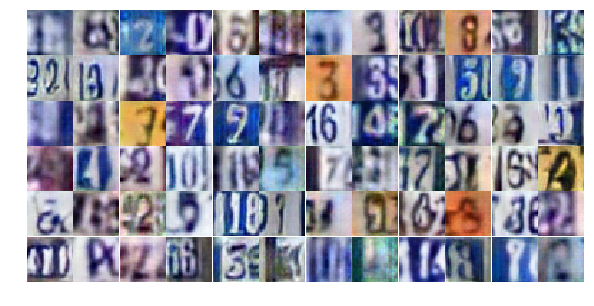

Epoch 21/25... Discriminator Loss: 0.6196... Generator Loss: 1.3042
Epoch 21/25... Discriminator Loss: 1.3840... Generator Loss: 0.4814
Epoch 21/25... Discriminator Loss: 0.5189... Generator Loss: 1.4652
Epoch 21/25... Discriminator Loss: 0.4408... Generator Loss: 1.5059
Epoch 21/25... Discriminator Loss: 0.9209... Generator Loss: 0.7287
Epoch 21/25... Discriminator Loss: 0.4568... Generator Loss: 1.5937
Epoch 21/25... Discriminator Loss: 0.8304... Generator Loss: 0.8722
Epoch 21/25... Discriminator Loss: 1.1338... Generator Loss: 0.6065
Epoch 21/25... Discriminator Loss: 0.5952... Generator Loss: 1.2523
Epoch 21/25... Discriminator Loss: 1.0684... Generator Loss: 0.6468


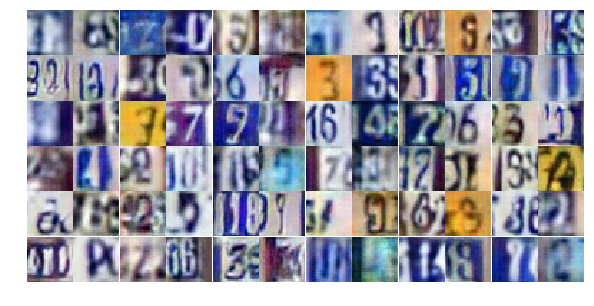

Epoch 21/25... Discriminator Loss: 0.3580... Generator Loss: 1.7009
Epoch 21/25... Discriminator Loss: 0.6533... Generator Loss: 1.0498
Epoch 21/25... Discriminator Loss: 1.3865... Generator Loss: 0.6759
Epoch 21/25... Discriminator Loss: 2.2907... Generator Loss: 0.2851
Epoch 21/25... Discriminator Loss: 0.7401... Generator Loss: 1.0437
Epoch 21/25... Discriminator Loss: 1.4587... Generator Loss: 0.5001
Epoch 21/25... Discriminator Loss: 1.0013... Generator Loss: 0.6802
Epoch 21/25... Discriminator Loss: 0.6258... Generator Loss: 2.3590
Epoch 21/25... Discriminator Loss: 0.5344... Generator Loss: 1.4169
Epoch 21/25... Discriminator Loss: 0.7327... Generator Loss: 1.2761


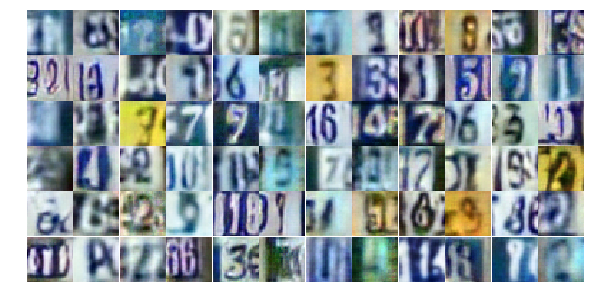

Epoch 21/25... Discriminator Loss: 1.3451... Generator Loss: 0.5314
Epoch 21/25... Discriminator Loss: 0.5640... Generator Loss: 1.3300
Epoch 21/25... Discriminator Loss: 0.6349... Generator Loss: 1.0750
Epoch 21/25... Discriminator Loss: 0.8151... Generator Loss: 1.1169
Epoch 21/25... Discriminator Loss: 0.8279... Generator Loss: 0.8924
Epoch 21/25... Discriminator Loss: 1.1353... Generator Loss: 0.5799
Epoch 21/25... Discriminator Loss: 0.5881... Generator Loss: 1.2383
Epoch 21/25... Discriminator Loss: 0.9766... Generator Loss: 0.7593
Epoch 21/25... Discriminator Loss: 1.5390... Generator Loss: 0.3595
Epoch 21/25... Discriminator Loss: 1.4167... Generator Loss: 0.4254


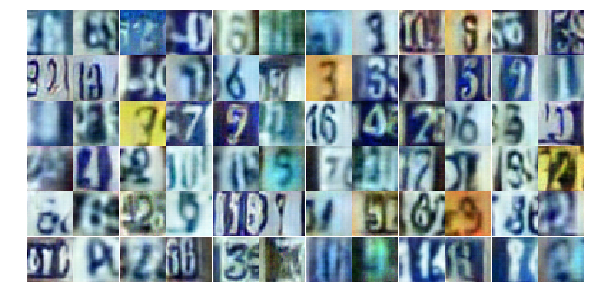

Epoch 21/25... Discriminator Loss: 1.0409... Generator Loss: 0.6031
Epoch 21/25... Discriminator Loss: 0.7818... Generator Loss: 1.0686
Epoch 21/25... Discriminator Loss: 1.1023... Generator Loss: 0.6157
Epoch 21/25... Discriminator Loss: 0.5269... Generator Loss: 1.2450
Epoch 21/25... Discriminator Loss: 0.7850... Generator Loss: 0.9009
Epoch 21/25... Discriminator Loss: 0.6218... Generator Loss: 1.2006
Epoch 21/25... Discriminator Loss: 1.0344... Generator Loss: 0.5994
Epoch 21/25... Discriminator Loss: 1.0346... Generator Loss: 0.6890
Epoch 21/25... Discriminator Loss: 0.8226... Generator Loss: 0.9134
Epoch 21/25... Discriminator Loss: 0.3001... Generator Loss: 2.5584


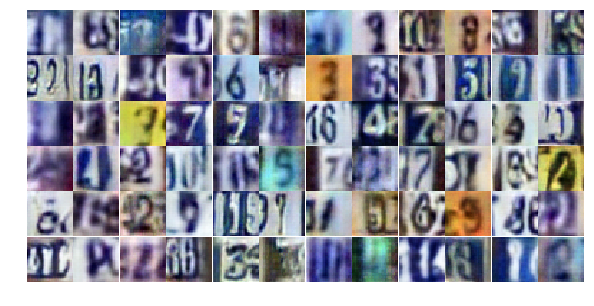

Epoch 21/25... Discriminator Loss: 0.7676... Generator Loss: 2.9342
Epoch 21/25... Discriminator Loss: 1.7169... Generator Loss: 0.4539
Epoch 21/25... Discriminator Loss: 0.7556... Generator Loss: 1.0497
Epoch 21/25... Discriminator Loss: 1.0717... Generator Loss: 0.6635
Epoch 21/25... Discriminator Loss: 0.4342... Generator Loss: 1.5269
Epoch 21/25... Discriminator Loss: 0.8469... Generator Loss: 0.9024
Epoch 21/25... Discriminator Loss: 1.3650... Generator Loss: 0.4270
Epoch 21/25... Discriminator Loss: 1.1257... Generator Loss: 0.7487
Epoch 21/25... Discriminator Loss: 1.2101... Generator Loss: 0.4923
Epoch 21/25... Discriminator Loss: 0.8533... Generator Loss: 0.8040


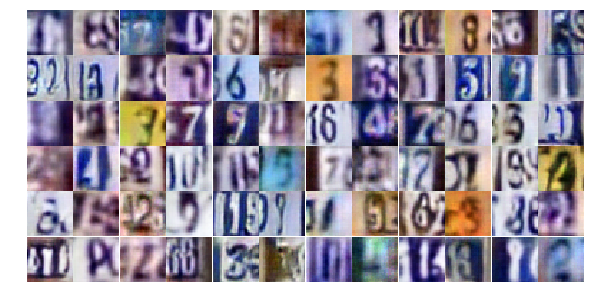

Epoch 21/25... Discriminator Loss: 0.6627... Generator Loss: 1.0798
Epoch 21/25... Discriminator Loss: 1.0339... Generator Loss: 0.6488
Epoch 21/25... Discriminator Loss: 1.7776... Generator Loss: 0.3314
Epoch 22/25... Discriminator Loss: 1.2407... Generator Loss: 0.5376
Epoch 22/25... Discriminator Loss: 0.6963... Generator Loss: 1.5749
Epoch 22/25... Discriminator Loss: 0.8164... Generator Loss: 0.8763
Epoch 22/25... Discriminator Loss: 0.6596... Generator Loss: 1.1430
Epoch 22/25... Discriminator Loss: 0.5242... Generator Loss: 1.3038
Epoch 22/25... Discriminator Loss: 1.5555... Generator Loss: 0.3626
Epoch 22/25... Discriminator Loss: 1.1581... Generator Loss: 0.5408


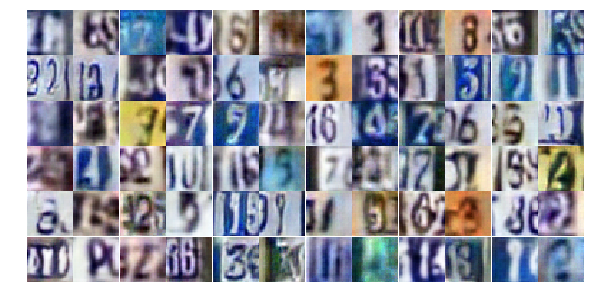

Epoch 22/25... Discriminator Loss: 0.5858... Generator Loss: 1.4269
Epoch 22/25... Discriminator Loss: 0.6063... Generator Loss: 1.5007
Epoch 22/25... Discriminator Loss: 1.6950... Generator Loss: 0.3384
Epoch 22/25... Discriminator Loss: 0.7318... Generator Loss: 1.1036
Epoch 22/25... Discriminator Loss: 0.7514... Generator Loss: 1.0957
Epoch 22/25... Discriminator Loss: 0.5919... Generator Loss: 1.5826
Epoch 22/25... Discriminator Loss: 0.8508... Generator Loss: 0.8334
Epoch 22/25... Discriminator Loss: 0.4621... Generator Loss: 1.6313
Epoch 22/25... Discriminator Loss: 1.0288... Generator Loss: 0.6499
Epoch 22/25... Discriminator Loss: 2.3991... Generator Loss: 0.1588


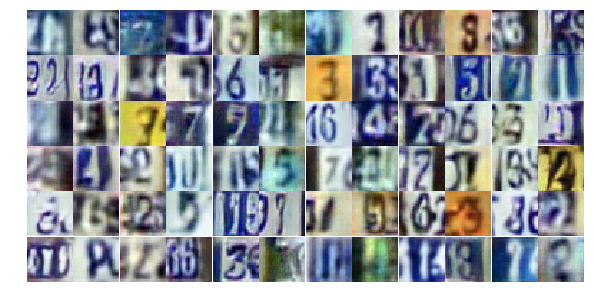

Epoch 22/25... Discriminator Loss: 1.0290... Generator Loss: 2.0396
Epoch 22/25... Discriminator Loss: 0.8065... Generator Loss: 0.8755
Epoch 22/25... Discriminator Loss: 0.8359... Generator Loss: 0.8972
Epoch 22/25... Discriminator Loss: 0.7442... Generator Loss: 0.8880
Epoch 22/25... Discriminator Loss: 0.7336... Generator Loss: 1.0309
Epoch 22/25... Discriminator Loss: 0.8709... Generator Loss: 0.7408
Epoch 22/25... Discriminator Loss: 0.6702... Generator Loss: 0.9714
Epoch 22/25... Discriminator Loss: 0.3679... Generator Loss: 1.7761
Epoch 22/25... Discriminator Loss: 0.6630... Generator Loss: 1.0055
Epoch 22/25... Discriminator Loss: 1.1706... Generator Loss: 0.5060


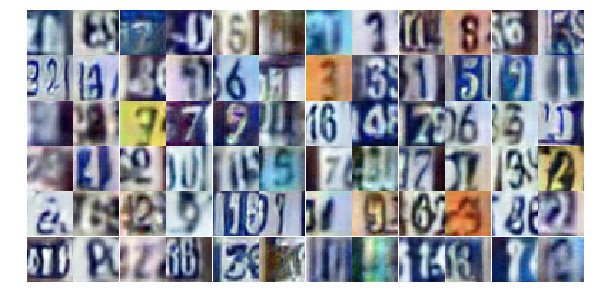

Epoch 22/25... Discriminator Loss: 0.5229... Generator Loss: 1.2532
Epoch 22/25... Discriminator Loss: 0.6091... Generator Loss: 1.1623
Epoch 22/25... Discriminator Loss: 0.9339... Generator Loss: 0.7339
Epoch 22/25... Discriminator Loss: 0.9314... Generator Loss: 0.7165
Epoch 22/25... Discriminator Loss: 0.7875... Generator Loss: 0.9204
Epoch 22/25... Discriminator Loss: 0.9451... Generator Loss: 0.7491
Epoch 22/25... Discriminator Loss: 1.7625... Generator Loss: 0.3022
Epoch 22/25... Discriminator Loss: 0.5920... Generator Loss: 1.1315
Epoch 22/25... Discriminator Loss: 1.1217... Generator Loss: 0.6003
Epoch 22/25... Discriminator Loss: 1.1257... Generator Loss: 0.5317


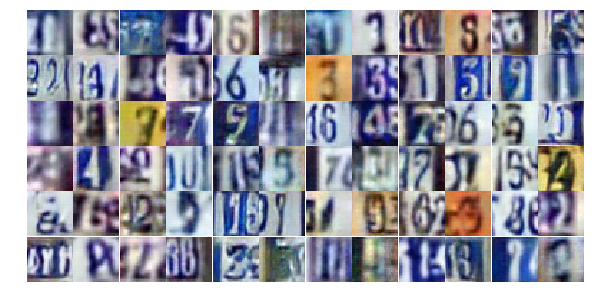

Epoch 22/25... Discriminator Loss: 0.8414... Generator Loss: 0.9409
Epoch 22/25... Discriminator Loss: 0.7475... Generator Loss: 0.9209
Epoch 22/25... Discriminator Loss: 0.3902... Generator Loss: 1.5795
Epoch 22/25... Discriminator Loss: 0.6039... Generator Loss: 1.2773
Epoch 22/25... Discriminator Loss: 0.5318... Generator Loss: 1.8037
Epoch 22/25... Discriminator Loss: 0.4693... Generator Loss: 1.6371
Epoch 22/25... Discriminator Loss: 0.7331... Generator Loss: 1.1039
Epoch 22/25... Discriminator Loss: 1.1396... Generator Loss: 0.7231
Epoch 22/25... Discriminator Loss: 0.8025... Generator Loss: 1.1566
Epoch 22/25... Discriminator Loss: 0.6817... Generator Loss: 1.1080


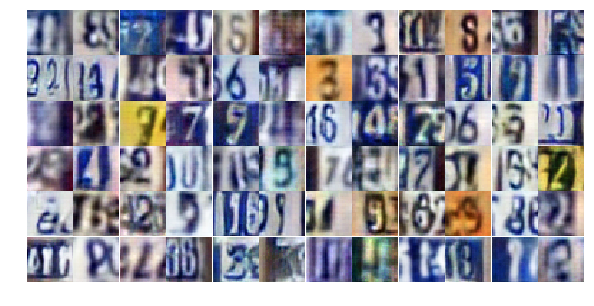

Epoch 22/25... Discriminator Loss: 1.0108... Generator Loss: 0.7016
Epoch 22/25... Discriminator Loss: 0.4492... Generator Loss: 1.9997
Epoch 22/25... Discriminator Loss: 1.0352... Generator Loss: 0.6198
Epoch 22/25... Discriminator Loss: 0.9100... Generator Loss: 0.8597
Epoch 22/25... Discriminator Loss: 1.2131... Generator Loss: 0.5116
Epoch 22/25... Discriminator Loss: 0.5118... Generator Loss: 1.9843
Epoch 22/25... Discriminator Loss: 1.3418... Generator Loss: 0.4654
Epoch 22/25... Discriminator Loss: 0.5548... Generator Loss: 1.2549
Epoch 22/25... Discriminator Loss: 1.0072... Generator Loss: 0.7401
Epoch 22/25... Discriminator Loss: 1.1307... Generator Loss: 0.6380


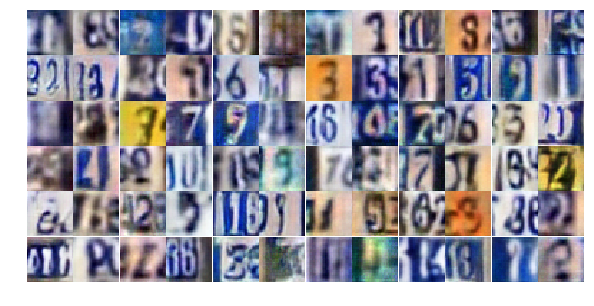

Epoch 23/25... Discriminator Loss: 0.6693... Generator Loss: 1.0838
Epoch 23/25... Discriminator Loss: 0.5244... Generator Loss: 1.3295
Epoch 23/25... Discriminator Loss: 1.4632... Generator Loss: 0.4688
Epoch 23/25... Discriminator Loss: 0.7843... Generator Loss: 0.8115
Epoch 23/25... Discriminator Loss: 0.9118... Generator Loss: 0.8210
Epoch 23/25... Discriminator Loss: 1.0270... Generator Loss: 0.7688
Epoch 23/25... Discriminator Loss: 0.9709... Generator Loss: 0.6887
Epoch 23/25... Discriminator Loss: 0.9463... Generator Loss: 0.7639
Epoch 23/25... Discriminator Loss: 0.7741... Generator Loss: 1.0604
Epoch 23/25... Discriminator Loss: 0.4407... Generator Loss: 1.6591


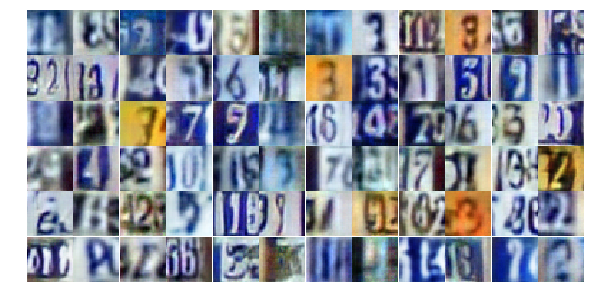

Epoch 23/25... Discriminator Loss: 0.6990... Generator Loss: 1.0398
Epoch 23/25... Discriminator Loss: 0.6426... Generator Loss: 1.0432
Epoch 23/25... Discriminator Loss: 0.8651... Generator Loss: 0.7499
Epoch 23/25... Discriminator Loss: 0.6132... Generator Loss: 1.2547
Epoch 23/25... Discriminator Loss: 0.4095... Generator Loss: 1.5199
Epoch 23/25... Discriminator Loss: 0.9245... Generator Loss: 0.7298
Epoch 23/25... Discriminator Loss: 0.9932... Generator Loss: 0.6835
Epoch 23/25... Discriminator Loss: 0.7168... Generator Loss: 1.0285
Epoch 23/25... Discriminator Loss: 0.5231... Generator Loss: 1.6164
Epoch 23/25... Discriminator Loss: 0.9358... Generator Loss: 0.7325


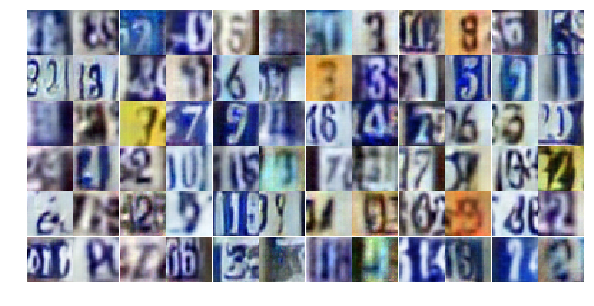

Epoch 23/25... Discriminator Loss: 1.4958... Generator Loss: 0.4379
Epoch 23/25... Discriminator Loss: 0.4306... Generator Loss: 2.0984
Epoch 23/25... Discriminator Loss: 0.9111... Generator Loss: 2.7562
Epoch 23/25... Discriminator Loss: 0.8396... Generator Loss: 0.9799
Epoch 23/25... Discriminator Loss: 1.1065... Generator Loss: 0.6583
Epoch 23/25... Discriminator Loss: 1.0404... Generator Loss: 0.6451
Epoch 23/25... Discriminator Loss: 0.8185... Generator Loss: 0.9038
Epoch 23/25... Discriminator Loss: 0.6805... Generator Loss: 1.1482
Epoch 23/25... Discriminator Loss: 0.5992... Generator Loss: 1.2365
Epoch 23/25... Discriminator Loss: 1.0291... Generator Loss: 1.6534


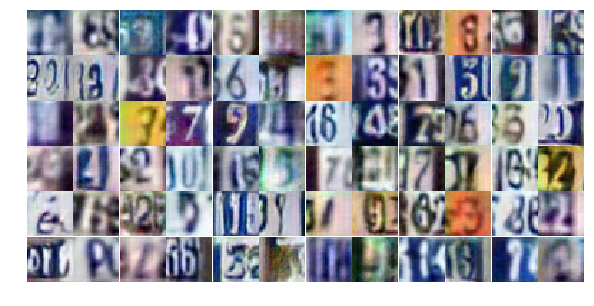

Epoch 23/25... Discriminator Loss: 0.7144... Generator Loss: 0.9369
Epoch 23/25... Discriminator Loss: 0.4780... Generator Loss: 1.5415
Epoch 23/25... Discriminator Loss: 0.6154... Generator Loss: 1.2165
Epoch 23/25... Discriminator Loss: 1.3698... Generator Loss: 0.4961
Epoch 23/25... Discriminator Loss: 1.1146... Generator Loss: 0.6173
Epoch 23/25... Discriminator Loss: 1.4938... Generator Loss: 0.3601
Epoch 23/25... Discriminator Loss: 1.1336... Generator Loss: 0.5771
Epoch 23/25... Discriminator Loss: 0.9066... Generator Loss: 0.7893
Epoch 23/25... Discriminator Loss: 0.5032... Generator Loss: 1.5789
Epoch 23/25... Discriminator Loss: 0.6472... Generator Loss: 1.0703


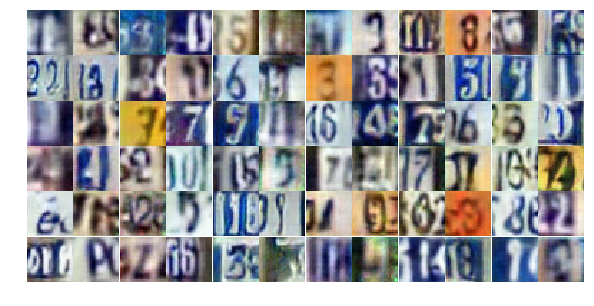

Epoch 23/25... Discriminator Loss: 0.7186... Generator Loss: 1.1461
Epoch 23/25... Discriminator Loss: 1.1284... Generator Loss: 0.5563
Epoch 23/25... Discriminator Loss: 1.1385... Generator Loss: 0.5769
Epoch 23/25... Discriminator Loss: 0.6709... Generator Loss: 1.0845
Epoch 23/25... Discriminator Loss: 0.8520... Generator Loss: 0.7657
Epoch 23/25... Discriminator Loss: 1.3859... Generator Loss: 0.4588
Epoch 23/25... Discriminator Loss: 0.5083... Generator Loss: 1.3581
Epoch 23/25... Discriminator Loss: 0.7780... Generator Loss: 1.2229
Epoch 23/25... Discriminator Loss: 0.9750... Generator Loss: 0.6861
Epoch 23/25... Discriminator Loss: 0.6560... Generator Loss: 1.1222


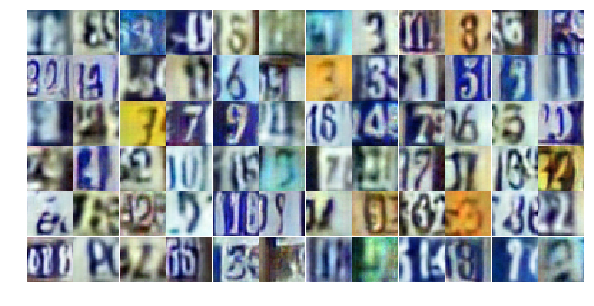

Epoch 23/25... Discriminator Loss: 0.5797... Generator Loss: 1.2340
Epoch 23/25... Discriminator Loss: 1.5605... Generator Loss: 0.3606
Epoch 23/25... Discriminator Loss: 0.6874... Generator Loss: 1.1876
Epoch 23/25... Discriminator Loss: 0.3366... Generator Loss: 2.0858
Epoch 23/25... Discriminator Loss: 1.5484... Generator Loss: 0.3549
Epoch 23/25... Discriminator Loss: 0.8144... Generator Loss: 1.0341
Epoch 23/25... Discriminator Loss: 1.0865... Generator Loss: 0.6210
Epoch 24/25... Discriminator Loss: 1.3309... Generator Loss: 0.5421
Epoch 24/25... Discriminator Loss: 0.7177... Generator Loss: 1.1311
Epoch 24/25... Discriminator Loss: 1.2223... Generator Loss: 0.5863


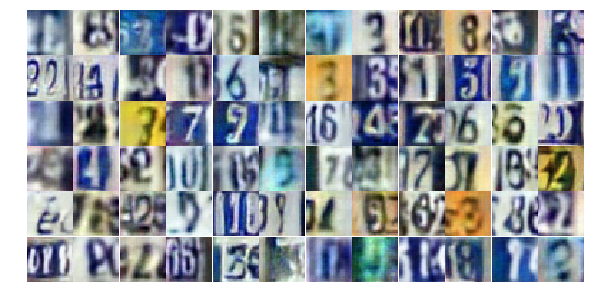

Epoch 24/25... Discriminator Loss: 0.4690... Generator Loss: 1.5189
Epoch 24/25... Discriminator Loss: 0.8096... Generator Loss: 0.9012
Epoch 24/25... Discriminator Loss: 0.6436... Generator Loss: 1.3082
Epoch 24/25... Discriminator Loss: 0.6466... Generator Loss: 1.5153
Epoch 24/25... Discriminator Loss: 0.8793... Generator Loss: 0.8101
Epoch 24/25... Discriminator Loss: 0.9589... Generator Loss: 0.7473
Epoch 24/25... Discriminator Loss: 0.8238... Generator Loss: 0.8577
Epoch 24/25... Discriminator Loss: 1.2194... Generator Loss: 0.4931
Epoch 24/25... Discriminator Loss: 0.4625... Generator Loss: 1.2812
Epoch 24/25... Discriminator Loss: 0.5992... Generator Loss: 1.0584


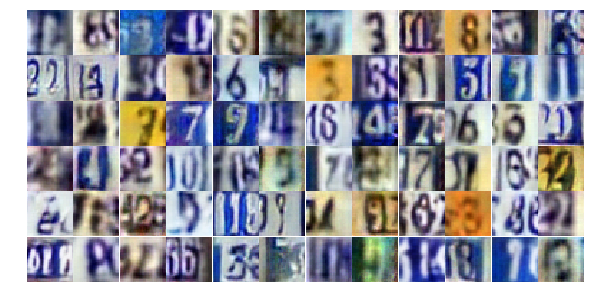

Epoch 24/25... Discriminator Loss: 1.4109... Generator Loss: 0.4047
Epoch 24/25... Discriminator Loss: 0.8822... Generator Loss: 0.9263
Epoch 24/25... Discriminator Loss: 1.5035... Generator Loss: 0.3918
Epoch 24/25... Discriminator Loss: 0.4124... Generator Loss: 2.4776
Epoch 24/25... Discriminator Loss: 0.9736... Generator Loss: 2.1246
Epoch 24/25... Discriminator Loss: 1.5607... Generator Loss: 3.1465
Epoch 24/25... Discriminator Loss: 1.1039... Generator Loss: 0.6142
Epoch 24/25... Discriminator Loss: 1.2417... Generator Loss: 0.5676
Epoch 24/25... Discriminator Loss: 1.2481... Generator Loss: 0.5528
Epoch 24/25... Discriminator Loss: 0.9585... Generator Loss: 0.7923


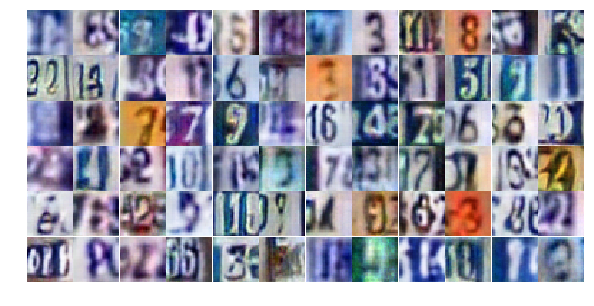

Epoch 24/25... Discriminator Loss: 0.6911... Generator Loss: 1.0599
Epoch 24/25... Discriminator Loss: 0.7330... Generator Loss: 1.0535
Epoch 24/25... Discriminator Loss: 0.6547... Generator Loss: 1.0689
Epoch 24/25... Discriminator Loss: 1.3270... Generator Loss: 0.4670
Epoch 24/25... Discriminator Loss: 0.7456... Generator Loss: 0.9158
Epoch 24/25... Discriminator Loss: 0.4560... Generator Loss: 1.4063
Epoch 24/25... Discriminator Loss: 0.5428... Generator Loss: 1.2258
Epoch 24/25... Discriminator Loss: 0.4906... Generator Loss: 1.4331
Epoch 24/25... Discriminator Loss: 0.7241... Generator Loss: 1.0112
Epoch 24/25... Discriminator Loss: 0.9182... Generator Loss: 0.7559


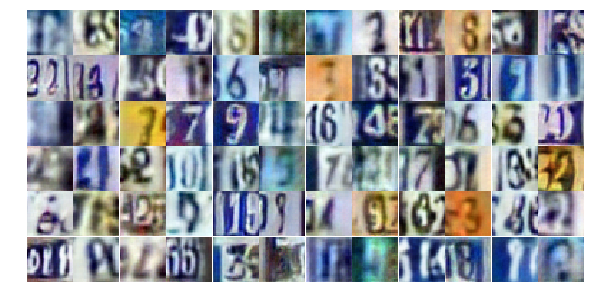

Epoch 24/25... Discriminator Loss: 0.6253... Generator Loss: 1.1099
Epoch 24/25... Discriminator Loss: 0.7180... Generator Loss: 0.9776
Epoch 24/25... Discriminator Loss: 1.4743... Generator Loss: 0.3408
Epoch 24/25... Discriminator Loss: 1.6214... Generator Loss: 0.3260
Epoch 24/25... Discriminator Loss: 0.7418... Generator Loss: 1.2345
Epoch 24/25... Discriminator Loss: 0.9057... Generator Loss: 0.7455
Epoch 24/25... Discriminator Loss: 0.9608... Generator Loss: 0.7361
Epoch 24/25... Discriminator Loss: 0.6956... Generator Loss: 0.9574
Epoch 24/25... Discriminator Loss: 0.7689... Generator Loss: 0.9230
Epoch 24/25... Discriminator Loss: 0.5840... Generator Loss: 1.3621


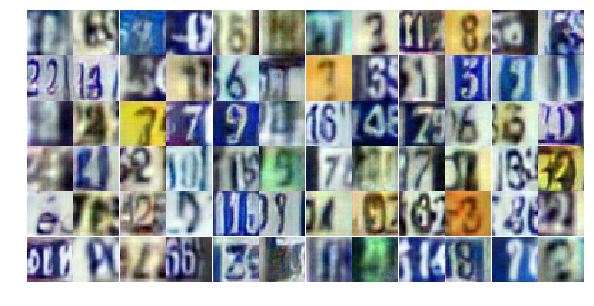

Epoch 24/25... Discriminator Loss: 0.6514... Generator Loss: 1.0588
Epoch 24/25... Discriminator Loss: 0.6650... Generator Loss: 0.9602
Epoch 24/25... Discriminator Loss: 1.6248... Generator Loss: 0.3770
Epoch 24/25... Discriminator Loss: 1.3696... Generator Loss: 0.4235
Epoch 24/25... Discriminator Loss: 1.2702... Generator Loss: 0.5060
Epoch 24/25... Discriminator Loss: 0.8282... Generator Loss: 0.8495
Epoch 24/25... Discriminator Loss: 0.7882... Generator Loss: 0.9050
Epoch 24/25... Discriminator Loss: 0.6699... Generator Loss: 0.9826
Epoch 24/25... Discriminator Loss: 0.6400... Generator Loss: 1.5402
Epoch 24/25... Discriminator Loss: 0.8568... Generator Loss: 0.8789


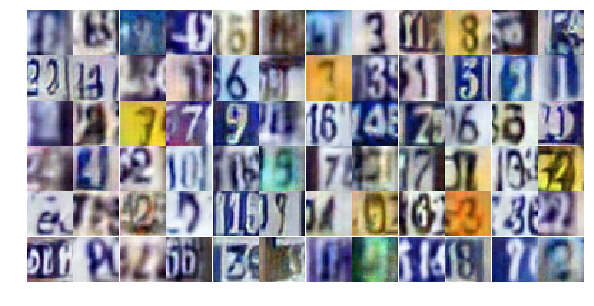

Epoch 24/25... Discriminator Loss: 0.9084... Generator Loss: 3.1035
Epoch 24/25... Discriminator Loss: 1.2899... Generator Loss: 0.4537
Epoch 24/25... Discriminator Loss: 1.2598... Generator Loss: 0.4681
Epoch 24/25... Discriminator Loss: 1.2726... Generator Loss: 0.4995
Epoch 24/25... Discriminator Loss: 1.4220... Generator Loss: 0.3789
Epoch 25/25... Discriminator Loss: 0.6766... Generator Loss: 1.2280
Epoch 25/25... Discriminator Loss: 0.4686... Generator Loss: 1.6172
Epoch 25/25... Discriminator Loss: 0.8361... Generator Loss: 0.8203
Epoch 25/25... Discriminator Loss: 0.8604... Generator Loss: 0.8211
Epoch 25/25... Discriminator Loss: 0.8333... Generator Loss: 0.7752


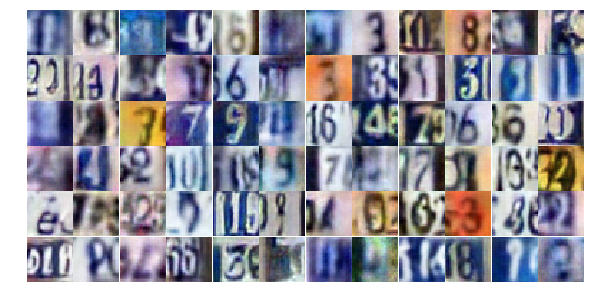

Epoch 25/25... Discriminator Loss: 1.0913... Generator Loss: 0.5703
Epoch 25/25... Discriminator Loss: 1.1457... Generator Loss: 0.6079
Epoch 25/25... Discriminator Loss: 0.6707... Generator Loss: 1.0755
Epoch 25/25... Discriminator Loss: 1.0160... Generator Loss: 0.6701
Epoch 25/25... Discriminator Loss: 0.6437... Generator Loss: 1.3662
Epoch 25/25... Discriminator Loss: 0.9717... Generator Loss: 0.8134
Epoch 25/25... Discriminator Loss: 0.9496... Generator Loss: 0.7895
Epoch 25/25... Discriminator Loss: 0.5960... Generator Loss: 1.6861
Epoch 25/25... Discriminator Loss: 0.7078... Generator Loss: 1.0577
Epoch 25/25... Discriminator Loss: 1.3264... Generator Loss: 0.5996


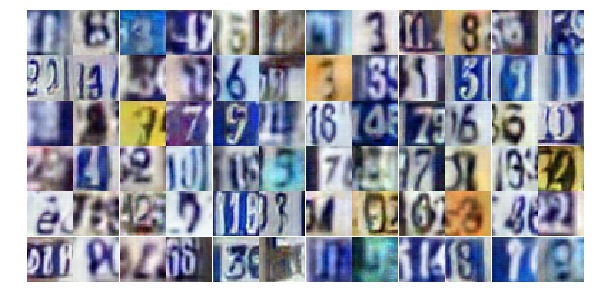

Epoch 25/25... Discriminator Loss: 5.5388... Generator Loss: 6.9108
Epoch 25/25... Discriminator Loss: 1.3368... Generator Loss: 1.7488
Epoch 25/25... Discriminator Loss: 1.3115... Generator Loss: 0.5660
Epoch 25/25... Discriminator Loss: 0.7781... Generator Loss: 0.9758
Epoch 25/25... Discriminator Loss: 0.6558... Generator Loss: 1.3153
Epoch 25/25... Discriminator Loss: 0.7186... Generator Loss: 1.0793
Epoch 25/25... Discriminator Loss: 1.0844... Generator Loss: 0.6738
Epoch 25/25... Discriminator Loss: 0.9323... Generator Loss: 0.8288
Epoch 25/25... Discriminator Loss: 0.5746... Generator Loss: 1.6398
Epoch 25/25... Discriminator Loss: 0.6850... Generator Loss: 1.0076


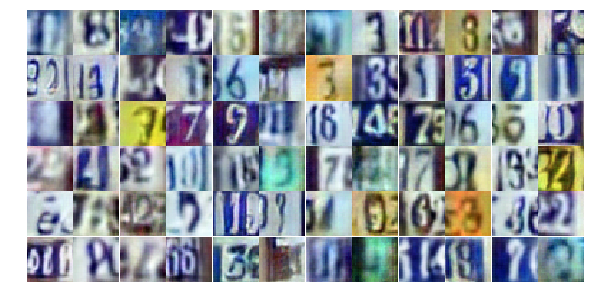

Epoch 25/25... Discriminator Loss: 0.9824... Generator Loss: 0.6795
Epoch 25/25... Discriminator Loss: 0.8914... Generator Loss: 0.7455
Epoch 25/25... Discriminator Loss: 1.3446... Generator Loss: 0.5181
Epoch 25/25... Discriminator Loss: 0.6829... Generator Loss: 1.3475
Epoch 25/25... Discriminator Loss: 0.8409... Generator Loss: 0.9447
Epoch 25/25... Discriminator Loss: 0.5769... Generator Loss: 1.1437
Epoch 25/25... Discriminator Loss: 0.7420... Generator Loss: 1.1538
Epoch 25/25... Discriminator Loss: 0.8061... Generator Loss: 0.7930
Epoch 25/25... Discriminator Loss: 1.1622... Generator Loss: 0.5801
Epoch 25/25... Discriminator Loss: 0.5219... Generator Loss: 1.2416


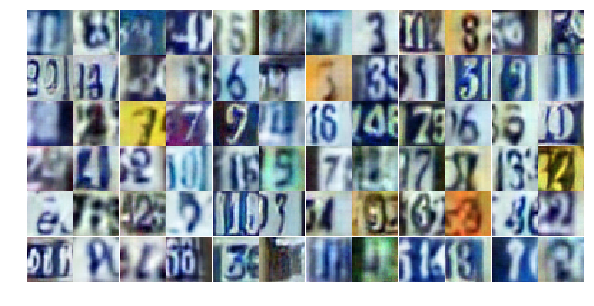

Epoch 25/25... Discriminator Loss: 0.8772... Generator Loss: 0.7196
Epoch 25/25... Discriminator Loss: 0.5965... Generator Loss: 1.1299
Epoch 25/25... Discriminator Loss: 0.7957... Generator Loss: 0.8239
Epoch 25/25... Discriminator Loss: 0.7424... Generator Loss: 0.9196
Epoch 25/25... Discriminator Loss: 0.7442... Generator Loss: 0.9563
Epoch 25/25... Discriminator Loss: 1.2836... Generator Loss: 0.4520
Epoch 25/25... Discriminator Loss: 0.4551... Generator Loss: 1.3431
Epoch 25/25... Discriminator Loss: 0.7112... Generator Loss: 0.9599
Epoch 25/25... Discriminator Loss: 1.3106... Generator Loss: 0.5145
Epoch 25/25... Discriminator Loss: 0.5452... Generator Loss: 2.0068


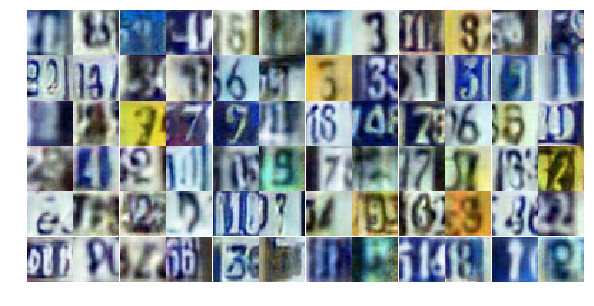

Epoch 25/25... Discriminator Loss: 0.7852... Generator Loss: 0.9448
Epoch 25/25... Discriminator Loss: 0.6293... Generator Loss: 1.1939
Epoch 25/25... Discriminator Loss: 0.8847... Generator Loss: 0.8279
Epoch 25/25... Discriminator Loss: 1.3348... Generator Loss: 0.4595
Epoch 25/25... Discriminator Loss: 0.6277... Generator Loss: 1.3923
Epoch 25/25... Discriminator Loss: 0.4897... Generator Loss: 1.3474
Epoch 25/25... Discriminator Loss: 1.1101... Generator Loss: 0.5748
Epoch 25/25... Discriminator Loss: 0.6819... Generator Loss: 1.1326
Epoch 25/25... Discriminator Loss: 0.7191... Generator Loss: 1.2422
Epoch 25/25... Discriminator Loss: 0.8412... Generator Loss: 0.8434


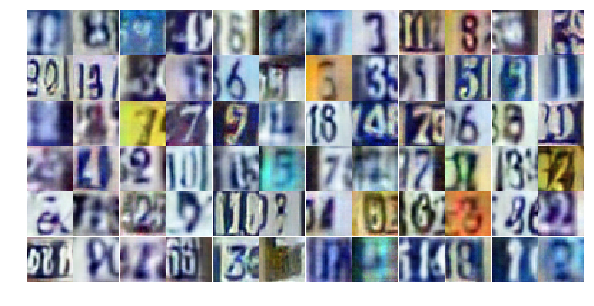

Epoch 25/25... Discriminator Loss: 0.4621... Generator Loss: 1.5571
Epoch 25/25... Discriminator Loss: 1.7556... Generator Loss: 0.2996


In [21]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

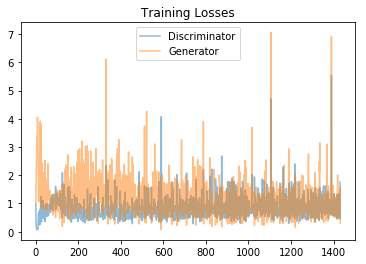

In [22]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

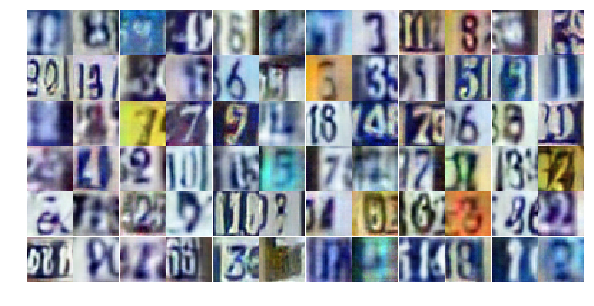

In [23]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))